In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [1]:
#IMPORTING ALL THE BASIC LIBRARIES

import gzip
import json
import pandas as pd                                              #importing the pandas library
import numpy as np                                               #importing the numpy library
import seaborn as sns                                            #importing the library for visualisatrion
import matplotlib.pyplot as plt                                  #importing the library for visualisatrion
from tabulate import tabulate                                    #For using the table form to our data
import warnings                                                  #To avoid the shown warnings
warnings.filterwarnings("ignore")
from sklearn import preprocessing                                #For the preprocessing purpose
from sklearn.preprocessing import MinMaxScaler,StandardScaler    #for scaling the data
from sklearn.preprocessing import LabelEncoder                   # for converting the object columns to numerical one
from sklearn.preprocessing import StandardScaler                 #for scaling all the features on same scale
from sklearn.cluster import KMeans                               #for making the clusters
from sklearn.neighbors import NearestNeighbors                   #for selecting the clusters
from sklearn.metrics import silhouette_score                     #for checking the accuracy
import scipy.cluster.hierarchy as sch                            #for making the hirerchical graph to selecting the cluster
from sklearn.cluster import AgglomerativeClustering              #for making the hirerchical model
from sklearn.cluster import DBSCAN                               #density based clustering
from sklearn.preprocessing import Binarizer                      
from sklearn.preprocessing import MultiLabelBinarizer

from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

from sklearn.metrics import f1_score


from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import confusion_matrix, classification_report 

# Loading the dataset

In [2]:
def load(data):
  load1 = []
  with gzip.open(data) as f:  #The gzip module provides the GzipFile class, as well as the open() , compress() and decompress() convenience functions. 
                              
    for line in f:
        load1.append(json.loads(line.strip()))
    df = pd.DataFrame(load1)
    return df
 

In [3]:
df_rev = load('Luxury_Beauty.json.gz')
df_rev.shape

(574628, 12)

# SHAPE OF THE REVIEW DATA

In [4]:
df_rev.shape

(574628, 12)

# Columns of the review data

In [5]:
df_rev.columns

Index(['overall', 'vote', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'unixReviewTime', 'style',
       'image'],
      dtype='object')

# Information of the review data

In [6]:
df_rev.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 574628 entries, 0 to 574627
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   overall         574628 non-null  float64
 1   vote            103689 non-null  object 
 2   verified        574628 non-null  bool   
 3   reviewTime      574628 non-null  object 
 4   reviewerID      574628 non-null  object 
 5   asin            574628 non-null  object 
 6   reviewerName    574597 non-null  object 
 7   reviewText      574228 non-null  object 
 8   summary         574445 non-null  object 
 9   unixReviewTime  574628 non-null  int64  
 10  style           251013 non-null  object 
 11  image           7418 non-null    object 
dtypes: bool(1), float64(1), int64(1), object(9)
memory usage: 48.8+ MB


# Statistical evualtion of the review data

In [7]:
df_rev.describe()

,overall,unixReviewTime
count,574628.000000,5.746280e+05
mean,4.225622,1.447113e+09
std,1.297522,5.695908e+07
min,1.000000,1.075248e+09
25%,4.000000,1.414627e+09
50%,5.000000,1.455149e+09
75%,5.000000,1.490054e+09
max,5.000000,1.538179e+09


In [8]:
df_meta = load('meta_Luxury_Beauty.json.gz')
df_meta.head(3)

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,details,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes
0,[],,[After a long day of handling thorny situation...,,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,B00004U9V2,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
1,[],,[If you haven't experienced the pleasures of b...,,AHAVA Bath Salts,[],,,[],"1,633,549 in Beauty & Personal Care (",[],{' Product Dimensions: ': '3 x 3.5 x ...,Luxury Beauty,,,,B0000531EN,[],[]
2,[],,"[Rich, black mineral mud, harvested from the b...",,"AHAVA Dead Sea Mineral Mud, 8.5 oz, Pack of 4",[],,,[],"1,806,710 in Beauty &amp; Personal Care (",[],{' Product Dimensions: ': '5.1 x 3 x ...,Luxury Beauty,,,,B0000532JH,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...


# Shape of the meta data

In [9]:
df_meta.shape

(12299, 19)

# Columns of the meta data

In [10]:
df_meta.columns

Index(['category', 'tech1', 'description', 'fit', 'title', 'also_buy', 'tech2',
       'brand', 'feature', 'rank', 'also_view', 'details', 'main_cat',
       'similar_item', 'date', 'price', 'asin', 'imageURL', 'imageURLHighRes'],
      dtype='object')

# Info and dtypes of meta dat

In [11]:
df_meta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12299 entries, 0 to 12298
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   category         12299 non-null  object
 1   tech1            12299 non-null  object
 2   description      12299 non-null  object
 3   fit              12299 non-null  object
 4   title            12299 non-null  object
 5   also_buy         12299 non-null  object
 6   tech2            12299 non-null  object
 7   brand            12299 non-null  object
 8   feature          12299 non-null  object
 9   rank             12299 non-null  object
 10  also_view        12299 non-null  object
 11  details          12299 non-null  object
 12  main_cat         12299 non-null  object
 13  similar_item     12299 non-null  object
 14  date             12299 non-null  object
 15  price            12299 non-null  object
 16  asin             12299 non-null  object
 17  imageURL         12299 non-null

# Merging both the datasets of review and metadata for furthur analysis

In [12]:
lux_data = pd.merge(df_rev,df_meta,on='asin')


In [13]:
lux_data.columns

Index(['overall', 'vote', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'unixReviewTime', 'style',
       'image', 'category', 'tech1', 'description', 'fit', 'title', 'also_buy',
       'tech2', 'brand', 'feature', 'rank', 'also_view', 'details', 'main_cat',
       'similar_item', 'date', 'price', 'imageURL', 'imageURLHighRes'],
      dtype='object')

In [14]:
lux_data['main_cat'].unique()

array(['Luxury Beauty'], dtype=object)

In [15]:
lux_data['rank'].tail(50)

600180      518,365 in Beauty & Personal Care (
600181      518,365 in Beauty & Personal Care (
600182      518,365 in Beauty & Personal Care (
600183      700,124 in Beauty & Personal Care (
600184      700,124 in Beauty & Personal Care (
600185      700,124 in Beauty & Personal Care (
600186    2,711,193 in Beauty & Personal Care (
600187      173,903 in Beauty & Personal Care (
600188      121,006 in Beauty & Personal Care (
600189      121,006 in Beauty & Personal Care (
600190      121,006 in Beauty & Personal Care (
600191      121,006 in Beauty & Personal Care (
600192      121,006 in Beauty & Personal Care (
600193      121,006 in Beauty & Personal Care (
600194      191,484 in Beauty & Personal Care (
600195      191,484 in Beauty & Personal Care (
600196      191,484 in Beauty & Personal Care (
600197      191,484 in Beauty & Personal Care (
600198      191,484 in Beauty & Personal Care (
600199      191,484 in Beauty & Personal Care (
600200       79,980 in Beauty & Personal

In [16]:
#everything comes under beauty and perosnal care.

In [17]:
lux_data.loc[:,["asin",'title']].head(2)

,asin,title
0,B00004U9V2,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...
1,B00004U9V2,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...


In [18]:
lux_data['reviewText'][198000]

'This face cleanser is wonderful.  It makes your skin feel so soft and fresh.\nI felt like my skin was tighter.  I am hoping to see a difference in my skin soon.'

In [19]:
lux_data[lux_data['date']==''].shape[0]

600230

In [20]:
lux_data[lux_data['brand']==''].shape[0]

599862

In [21]:
lux_data['brand'].unique()

array(['', 'PHYTO', 'bliss', 'UNITE Hair', 'H2O+ Beauty', 'PUR',
       'ZWILLING J.A. Henckels', 'Kneipp'], dtype=object)

In [22]:
jj = ['', 'PHYTO', 'bliss', 'UNITE Hair', 'H2O+ Beauty', 'PUR',
       'ZWILLING J.A. Henckels', 'Kneipp']

for i in jj:
  print(lux_data[lux_data['brand']==i].shape[0])

599862
21
28
258
35
9
10
7


In [23]:
lux_data.shape[0]

600230

# Data Pre-Processing.

In [24]:
lux_data_copy = lux_data.copy()

In [25]:
lux_data_copy.head(3)

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
0,2.0,3,True,"06 15, 2010",A1Q6MUU0B2ZDQG,B00004U9V2,D. Poston,"I bought two of these 8.5 fl oz hand cream, an...",dispensers don't work,1276560000,...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
1,2.0,3,True,"06 15, 2010",A1Q6MUU0B2ZDQG,B00004U9V2,D. Poston,"I bought two of these 8.5 fl oz hand cream, an...",dispensers don't work,1276560000,...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
2,5.0,14,True,"01 7, 2010",A3HO2SQDCZIE9S,B00004U9V2,chandra,"Believe me, over the years I have tried many, ...",Best hand cream ever.,1262822400,...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...


In [26]:
lux_data_copy.tail(3)

,overall,vote,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
600227,5.0,2,True,"08 8, 2016",A2VVJW6PY48A9M,B01HIQCSBC,Mrs J Cargill,"Great product, PERFECT SHADE!! :)",Love the deep red color!,1470614400,...,[],"476,381 in Beauty & Personal Care (","[B00D2VMUA2, B004N2SQUC, B074KBT2NM, B01BMCSC4...","{' Item Weight: ': '0.32 ounces', 'Sh...",Luxury Beauty,,,,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
600228,1.0,2,True,"12 5, 2016",A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,"The perfume is good, but the spray head broke ...",Spray head broke off within a month,1480896000,...,[],"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",{' Product Dimensions: ': '3.3 x 2.7 ...,Luxury Beauty,,,$76.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
600229,5.0,NaN,True,"01 14, 2017",AJEDVHTLS9P3V,B01HJ2UY1G,ML Shelton,Great fragrance.,Five Stars,1484352000,...,[],"181,383 in Beauty & Personal Care (","[B0757439SY, B01LX71LJV, B01HJ2UY0W, B07GBSC3L...",{' Product Dimensions: ': '3.3 x 3.2 ...,Luxury Beauty,,,$96.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...


In [27]:
lux_data_copy['style']

0                                                       NaN
1                                                       NaN
2                                                       NaN
3                                                       NaN
4                                     {'Size:': ' 3.5 oz.'}
                                ...                        
600225                                                  NaN
600226                                                  NaN
600227                                                  NaN
600228    {'Size:': ' 1.7 Fluid Ounce', 'Color:': ' Multi'}
600229    {'Size:': ' 3.4 Fluid Ounce', 'Color:': ' Multi'}
Name: style, Length: 600230, dtype: object

# Shape of merged data

In [28]:
lux_data_copy.shape

(600230, 30)

# Columns of the data

In [29]:
lux_data_copy.columns

Index(['overall', 'vote', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'unixReviewTime', 'style',
       'image', 'category', 'tech1', 'description', 'fit', 'title', 'also_buy',
       'tech2', 'brand', 'feature', 'rank', 'also_view', 'details', 'main_cat',
       'similar_item', 'date', 'price', 'imageURL', 'imageURLHighRes'],
      dtype='object')

# Information and summary of merged data

In [30]:
lux_data_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 600230 entries, 0 to 600229
Data columns (total 30 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   overall          600230 non-null  float64
 1   vote             107111 non-null  object 
 2   verified         600230 non-null  bool   
 3   reviewTime       600230 non-null  object 
 4   reviewerID       600230 non-null  object 
 5   asin             600230 non-null  object 
 6   reviewerName     600199 non-null  object 
 7   reviewText       599810 non-null  object 
 8   summary          600041 non-null  object 
 9   unixReviewTime   600230 non-null  int64  
 10  style            270311 non-null  object 
 11  image            7838 non-null    object 
 12  category         600230 non-null  object 
 13  tech1            600230 non-null  object 
 14  description      600230 non-null  object 
 15  fit              600230 non-null  object 
 16  title            600230 non-null  obje

# Checking for missing values in our merged dataset.

In [31]:
lux_data_copy.isnull().sum()

overall                 0
vote               493119
verified                0
reviewTime              0
reviewerID              0
asin                    0
reviewerName           31
reviewText            420
summary               189
unixReviewTime          0
style              329919
image              592392
category                0
tech1                   0
description             0
fit                     0
title                   0
also_buy                0
tech2                   0
brand                   0
feature                 0
rank                    0
also_view               0
details                 0
main_cat                0
similar_item            0
date                    0
price                   0
imageURL                0
imageURLHighRes         0
dtype: int64

## Percentage of null values.

In [32]:
lux_data_copy.isnull().sum()

overall                 0
vote               493119
verified                0
reviewTime              0
reviewerID              0
asin                    0
reviewerName           31
reviewText            420
summary               189
unixReviewTime          0
style              329919
image              592392
category                0
tech1                   0
description             0
fit                     0
title                   0
also_buy                0
tech2                   0
brand                   0
feature                 0
rank                    0
also_view               0
details                 0
main_cat                0
similar_item            0
date                    0
price                   0
imageURL                0
imageURLHighRes         0
dtype: int64

In [33]:
lux_data_copy.isnull().sum()/len(lux_data)*100

overall             0.000000
vote               82.155007
verified            0.000000
reviewTime          0.000000
reviewerID          0.000000
asin                0.000000
reviewerName        0.005165
reviewText          0.069973
summary             0.031488
unixReviewTime      0.000000
style              54.965430
image              98.694167
category            0.000000
tech1               0.000000
description         0.000000
fit                 0.000000
title               0.000000
also_buy            0.000000
tech2               0.000000
brand               0.000000
feature             0.000000
rank                0.000000
also_view           0.000000
details             0.000000
main_cat            0.000000
similar_item        0.000000
date                0.000000
price               0.000000
imageURL            0.000000
imageURLHighRes     0.000000
dtype: float64

### ***Looking at the percentage of null values in the columns:- vote, image it makes sense to drop them because if we try to fill them with mode/median/mode data can get highly imbalanced which is not appropiate for our furthur analysis.***

In [34]:
lux_data_copy = lux_data_copy.drop(columns='image')
lux_data_copy = lux_data_copy.drop(columns='vote')

# Filling the NaN values with not available

In [35]:
lux_data_copy['reviewText'].fillna('Review not available', inplace=True)

In [36]:
lux_data_copy = lux_data_copy.dropna()

In [37]:
#beauty_data_copy['reviewerName'].fillna('Name not available', inplace=True)

In [38]:
#beauty_data_copy['summary'].fillna('summary not available', inplace=True)

Unix time is a way of representing a timestamp by representing the time as the number of seconds since January 1st, 1970 at 00:00:00 UTC. One of the primary benefits of using Unix time is that it can be represented as an integer making it easier to parse and use across different systems.

This particular column gives us an idea of the 'time' at which review was given which would not have much of an impact on our analysis.

In [39]:
lux_data_copy['unixReviewTime']

4         1524009600
5         1524009600
6         1524009600
7         1524009600
8         1523923200
             ...    
600219    1500595200
600220    1492214400
600221    1485907200
600228    1480896000
600229    1484352000
Name: unixReviewTime, Length: 270202, dtype: int64

In [40]:
lux_data_copy = lux_data_copy.drop(columns='unixReviewTime')

In [41]:
lux_data_copy[['style']]

,style
4,{'Size:': ' 3.5 oz.'}
5,{'Size:': ' 3.5 oz.'}
6,{'Size:': ' 3.5 oz.'}
7,{'Size:': ' 3.5 oz.'}
8,{'Size:': ' 3.5 oz.'}
...,...
600219,{'Size:': ' 1.6 fl. oz.'}
600220,{'Size:': ' 6.7 fl. oz.'}
600221,{'Size:': ' 1.6 fl. oz.'}
600228,"{'Size:': ' 1.7 Fluid Ounce', 'Color:': ' Multi'}"


In [42]:
lux_data_copy.isnull().sum()

overall            0
verified           0
reviewTime         0
reviewerID         0
asin               0
reviewerName       0
reviewText         0
summary            0
style              0
category           0
tech1              0
description        0
fit                0
title              0
also_buy           0
tech2              0
brand              0
feature            0
rank               0
also_view          0
details            0
main_cat           0
similar_item       0
date               0
price              0
imageURL           0
imageURLHighRes    0
dtype: int64

### Dropping the null values 

In [43]:
lux_data_copy = lux_data_copy.dropna()

In [44]:
lux_data_copy.isnull().sum()

overall            0
verified           0
reviewTime         0
reviewerID         0
asin               0
reviewerName       0
reviewText         0
summary            0
style              0
category           0
tech1              0
description        0
fit                0
title              0
also_buy           0
tech2              0
brand              0
feature            0
rank               0
also_view          0
details            0
main_cat           0
similar_item       0
date               0
price              0
imageURL           0
imageURLHighRes    0
dtype: int64

In [45]:
lux_data_copy

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,style,category,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
4,5.0,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
5,5.0,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
6,5.0,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
7,5.0,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
8,5.0,True,"04 17, 2018",A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals o...,I always have a backup ready.,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
600219,3.0,True,"07 21, 2017",A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,Nothing changed or happened. Smells good.,Ok,{'Size:': ' 1.6 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
600220,5.0,True,"04 15, 2017",AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,Great conditioner - leave my hair super shiny ...,Five Stars,{'Size:': ' 6.7 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
600221,3.0,True,"02 1, 2017",AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,"It's ok, thick, smells nice but it doesn't wow me",smells nice but it doesn't wow me,{'Size:': ' 1.6 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
600228,1.0,True,"12 5, 2016",A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,"The perfume is good, but the spray head broke ...",Spray head broke off within a month,"{'Size:': ' 1.7 Fluid Ounce', 'Color:': ' Multi'}",[],...,[],"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",{' Product Dimensions: ': '3.3 x 2.7 ...,Luxury Beauty,,,$76.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...

In [46]:
lux_data_copy.reset_index(drop=True,inplace=True)
lux_data_copy.head(5)

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,style,category,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
0,5.0,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
1,5.0,True,"04 18, 2018",A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
2,5.0,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
3,5.0,True,"04 18, 2018",A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
4,5.0,True,"04 17, 2018",A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals o...,I always have a backup ready.,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...


## ***Data has been cleaned with respect to missing values***

In [47]:
print("Before Cleaning number of rows = ",lux_data.shape[0])
print("After Cleaning number of rows = ",lux_data_copy.shape[0])
print()
print()
print(lux_data_copy.columns)

Before Cleaning number of rows =  600230
After Cleaning number of rows =  270202


Index(['overall', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'style', 'category', 'tech1',
       'description', 'fit', 'title', 'also_buy', 'tech2', 'brand', 'feature',
       'rank', 'also_view', 'details', 'main_cat', 'similar_item', 'date',
       'price', 'imageURL', 'imageURLHighRes'],
      dtype='object')


## Converting the columns datatype to a relevent form.

In [48]:
jj

['',
 'PHYTO',
 'bliss',
 'UNITE Hair',
 'H2O+ Beauty',
 'PUR',
 'ZWILLING J.A. Henckels',
 'Kneipp']

In [49]:
for i in jj:
  print(lux_data_copy[lux_data_copy['brand']==i].shape[0])

269969
0
0
191
35
0
0
7


In [50]:
lux_data_copy.dtypes

overall            float64
verified              bool
reviewTime          object
reviewerID          object
asin                object
reviewerName        object
reviewText          object
summary             object
style               object
category            object
tech1               object
description         object
fit                 object
title               object
also_buy            object
tech2               object
brand               object
feature             object
rank                object
also_view           object
details             object
main_cat            object
similar_item        object
date                object
price               object
imageURL            object
imageURLHighRes     object
dtype: object

In [51]:
lux_data_copy['reviewTime'] = pd.to_datetime(lux_data_copy['reviewTime'])

In [52]:
lux_data_copy[['reviewTime']].dtypes

reviewTime    datetime64[ns]
dtype: object

In [53]:
lux_data_copy['category'] = lux_data_copy['category'].astype(str)

In [54]:
lux_data_copy[['category']].dtypes

category    object
dtype: object

In [55]:
lux_data_copy.dtypes

overall                   float64
verified                     bool
reviewTime         datetime64[ns]
reviewerID                 object
asin                       object
reviewerName               object
reviewText                 object
summary                    object
style                      object
category                   object
tech1                      object
description                object
fit                        object
title                      object
also_buy                   object
tech2                      object
brand                      object
feature                    object
rank                       object
also_view                  object
details                    object
main_cat                   object
similar_item               object
date                       object
price                      object
imageURL                   object
imageURLHighRes            object
dtype: object

### Dropping the duplicate values of (asin,product id, reviewText,reviewerName,reviewerID).

In [56]:
lux_data_copy[lux_data_copy.duplicated(['asin','reviewText','reviewerName','reviewerID'],keep=False)]

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,style,category,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
1,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
2,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
3,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
4,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals o...,I always have a backup ready.,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
266932,5.0,False,2011-05-08,A11R627QB6F5A2,B0002ONF56,Kellilicious74,I bought this from Sephora in Midnight Sparkle...,Awesome SPARKLE liner!,{'Color:': ' Midnight'},[],...,[],"1,933,005 in Beauty &amp; Personal Care (",[],{' Product Dimensions: ': '0.6 x 0.6 ...,Luxury Beauty,,,,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
266999,5.0,True,2013-03-21,A5Q86XO95BG07,B003V1FY1K,golfer,Have used this product for several years. Rat...,Creamy,{'Color:': ' Via Naturale'},[],...,[],"1,535,639 in Beauty & Personal Care (",[],{' Product Dimensions: ': '4 x 2 x 1 ...,Luxury Beauty,,,,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
267000,5.0,True,2013-03-21,A5Q86XO95BG07,B003V1FY1K,golfer,Have used this product for several years. Rat...,Creamy,{'Color:': ' Peonia Peach'},[],...,[],"1,535,639 in Beauty & Personal Care (",[],{' Product Dimensions: ': '4 x 2 x 1 ...,Luxury Beauty,,,,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
267277,5.0,True,2013-07-10,AU4AOFMF4NHYG,B00021E922,Parisa Schwartz,Love the yellow undertones and creamy texture ...,Best undereye concealer.,{'Color:': ' C3 Light/Medium'},[],...,[],"1,698,614 in Beauty & Personal Care (","[B076JSJ32L, B076JLDZ6H]",{' Product Dimensions: ': '0.9 x 1.8 ...,Luxury Beauty,,,,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...


In [57]:
lux_data_copy.duplicated(['asin','reviewText','reviewerName','reviewerID']).sum()

33672

In [58]:
lux_data_copy = lux_data_copy.drop_duplicates(subset=['asin','reviewText','reviewerName','reviewerID'], keep='first')
lux_data_copy

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,style,category,...,feature,rank,also_view,details,main_cat,similar_item,date,price,imageURL,imageURLHighRes
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,Great hand lotion,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
2,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,This is the best for the severely dry skin on ...,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
4,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,The best non- oily hand cream ever. It heals o...,I always have a backup ready.,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
6,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,Ive used this lotion for many years. I try oth...,Ive used this lotion for many years. I try ...,{'Size:': ' 250 g'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
8,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,Works great for dry hands.,Five Stars,{'Size:': ' 3.5 oz.'},[],...,[],"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",{' Product Dimensions: ': '2.2 x 2.2 ...,Luxury Beauty,,,$30.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
270197,3.0,True,2017-07-21,A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,Nothing changed or happened. Smells good.,Ok,{'Size:': ' 1.6 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
270198,5.0,True,2017-04-15,AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,Great conditioner - leave my hair super shiny ...,Five Stars,{'Size:': ' 6.7 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
270199,3.0,True,2017-02-01,AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,"It's ok, thick, smells nice but it doesn't wow me",smells nice but it doesn't wow me,{'Size:': ' 1.6 fl. oz.'},[],...,[],"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",{' Product Dimensions: ': '3.1 x 1.8 ...,Luxury Beauty,,,$20.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...
270200,1.0,True,2016-12-05,A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,"The perfume is good, but the spray head broke ...",Spray head broke off within a month,"{'Size:': ' 1.7 Fluid Ounce', 'Color:': ' Multi'}",[],...,[],"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",{' Product Dimensions: ': '3.3 x 2.7 ...,Luxury Beauty,,,$76.00,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-

In [59]:
lux_data_copy.duplicated(['asin','reviewText','reviewerName','reviewerID']).sum()

#duplicate and repeated reviews have been drop and the original first occuring reviews are kept.

0

In [60]:
lux_data_copy.shape

(236530, 27)

In [61]:
lux_data_copy.columns

Index(['overall', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'style', 'category', 'tech1',
       'description', 'fit', 'title', 'also_buy', 'tech2', 'brand', 'feature',
       'rank', 'also_view', 'details', 'main_cat', 'similar_item', 'date',
       'price', 'imageURL', 'imageURLHighRes'],
      dtype='object')

In [62]:
lux_data_copy.describe()

,overall
count,236530.000000
mean,4.216611
std,1.302922
min,1.000000
25%,4.000000
50%,5.000000
75%,5.000000
max,5.000000


Review data column

reviewerID - ID of the reviewer, e.g. A2SUAM1J3GNN3B

asin - ID of the product, e.g. 0000013714

reviewerName - name of the reviewer

vote - helpful votes of the review

style - a disctionary of the product metadata, e.g., "Format" is "Hardcover"

reviewText - text of the review

overall - rating of the product

summary - summary of the review

unixReviewTime - time of the review (unix time)

reviewTime - time of the review (raw)

image - images that users post after they have received the product


Metadata
Metadata includes descriptions, price, sales-rank, brand info, and co-purchasing links:

asin - ID of the product, e.g. 0000031852

title - name of the product

feature - bullet-point format features of the product

description - description of the product

price - price in US dollars (at time of crawl)

imageURL - url of the product image

imageURL - url of the high resolution product image

related - related products (also bought, also viewed, bought together, buy after viewing)
salesRank - sales rank information

brand - brand name

categories - list of categories the product belongs to

tech1 - the first technical detail table of the product

tech2 - the second technical detail table of the product

similar - similar product table

In [63]:
lux_data_copy['feature'][8]

[]

## ***Dropping irrelevant columns from our dataset.***

In [64]:
irr_cols = ['fit', 'tech2', 'feature', 'details', 'date','imageURL', 'imageURLHighRes']

for i in irr_cols:
  lux_data_copy = lux_data_copy.drop([i],axis=1)

In [65]:
lux_data_copy = lux_data_copy.drop(['tech1'],axis=1)

In [66]:
np.size(lux_data_copy.columns)

19

In [67]:
lux_data_copy.columns

Index(['overall', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'reviewText', 'summary', 'style', 'category',
       'description', 'title', 'also_buy', 'brand', 'rank', 'also_view',
       'main_cat', 'similar_item', 'price'],
      dtype='object')

In [68]:
lux_data_copy.shape

(236530, 19)

In [69]:
print("Number of reviews having empty string :",lux_data[lux_data['reviewText']==''].shape[0])

Number of reviews having empty string : 0


In [70]:
print("Number of reviews having empty string :",lux_data_copy[lux_data_copy['reviewText']==''].shape[0])

Number of reviews having empty string : 0


# Combining(concatenating) review text and review summary columns.

In [71]:
lux_data_copy['Review'] = lux_data_copy['reviewText'] + lux_data_copy['summary']

In [72]:
lux_data_copy.iloc[0]

overall                                                       5.0
verified                                                     True
reviewTime                                    2018-04-18 00:00:00
reviewerID                                         A2EM03F99X3RJZ
asin                                                   B00004U9V2
reviewerName                                            Maureen G
reviewText                                      Great hand lotion
summary                                                Five Stars
style                                       {'Size:': ' 3.5 oz.'}
category                                                       []
description     [After a long day of handling thorny situation...
title           Crabtree &amp; Evelyn - Gardener's Ultra-Moist...
also_buy        [B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...
brand                                                            
rank                            4,324 in Beauty & Personal Care (
also_view 

In [73]:
lux_data_copy = lux_data_copy.drop(['reviewText','summary'], axis=1)

In [74]:
lux_data_copy.shape

(236530, 18)

Pre-processing —— Text Normalization (Text Wrangling)

Text normalization is defined as a process that consists of a series of steps that should be followed to wrangle, clean, and standardize textual data into a form that could be consumed by other NLP and analytics systems and applications as input. various techniques include cleaning text, removing stopwords and other unnecessary terms, stemming, and lemmatization. Text normalization is also often called text cleansing or wrangling.

Below are various techniques used in the process of text normalization:

Cleaning Text....

Removing Special Characters.....

Removing Stopwords.....

## Cleaning the style columns

In [75]:
abc = list(lux_data_copy['style'].items())

In [76]:
#cleaning style column
list1 = []
for i in lux_data_copy['style'].items():
    c = 0
    if type(i[1]) == dict:
        for j in i[1].items():
            c = j[1]
    if c == 0:
        list1.append(np.nan)
    else:
        list1.append(c)

In [77]:
print(list1,end='')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [78]:
lux_data_copy['style'] = list1

In [79]:
lux_data_copy[['style']].head(3)

,style
0,3.5 oz.
2,3.5 oz.
4,3.5 oz.


In [80]:
import statistics as sts
d1 = lux_data_copy.groupby(by=['asin'])['style'].agg(sts.mode)
d1 = pd.DataFrame(d1)
d1

,style
asin,
B00004U9V2,250 g
B0000531EN,32 Ounce
B00005V50B,Original Mint
B00005V50C,24 packets
B000066SYB,17.0 oz
...,...
B01H62J7K8,Elizabeth Arden Prevage Anti-Aging Daily Seru...
B01HGSJNEW,3.3 oz
B01HIIO7Q4,6.7 fl. oz.


In [81]:
lux_data_copy1 = pd.merge(lux_data_copy,d1,left_on='asin',right_on='asin')
lux_data_copy1.drop('style_x',axis=1,inplace=True)
lux_data_copy1.rename(columns={'overall':'Ratings','style_y':'Style'},inplace=True)

In [82]:
lux_data_copy1

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,$30.00,Great hand lotionFive Stars,250 g
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,$30.00,This is the best for the severely dry skin on ...,250 g
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,$30.00,The best non- oily hand cream ever. It heals o...,250 g
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,$30.00,Ive used this lotion for many years. I try oth...,250 g
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,$30.00,Works great for dry hands.Five Stars,250 g
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236525,3.0,True,2017-07-21,A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,$20.00,Nothing changed or happened. Smells good.Ok,6.7 fl. oz.
236526,5.0,True,2017-04-15,AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,$20.00,Great conditioner - leave my hair super shiny ...,6.7 fl. oz.
236527,3.0,True,2017-02-01,AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,$20.00,"It's ok, thick, smells nice but it doesn't wow...",6.7 fl. oz.
236528,1.0,True,2016-12-05,A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,[],[The I AM JUICY COUTURE girl is once again tak...,"Juicy Couture I Love Juicy Couture, 1.7 fl. Oz...",[],,"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",Luxury Beauty,,$76.00,"The perfume is good, but the spray head broke ...",Multi


In [83]:
lux_data_copy1[['price']]

,price
0,$30.00
1,$30.00
2,$30.00
3,$30.00
4,$30.00
...,...
236525,$20.00
236526,$20.00
236527,$20.00
236528,$76.00


In [84]:
l = '$ manthan'
l.lstrip('$ ')

'manthan'

In [85]:
len(lux_data_copy1['price'])

236530

### Cleaning the price column

In [86]:
lux_data_copy1['price'] = lux_data_copy1['price'].str.strip("$")
lux_data_copy1['price'] = lux_data_copy1['price'].apply(lambda x:pd.to_numeric(str(x).strip("'"),errors='coerce'))

In [87]:
lux_data_copy1['price'].unique

<bound method Series.unique of 0         30.0
1         30.0
2         30.0
3         30.0
4         30.0
          ... 
236525    20.0
236526    20.0
236527    20.0
236528    76.0
236529    96.0
Name: price, Length: 236530, dtype: float64>

In [88]:
lux_data_copy['price'][128100]

'$99.95'

In [89]:
lux_data_copy1

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,Great hand lotionFive Stars,250 g
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,This is the best for the severely dry skin on ...,250 g
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,The best non- oily hand cream ever. It heals o...,250 g
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,Ive used this lotion for many years. I try oth...,250 g
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,Works great for dry hands.Five Stars,250 g
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236525,3.0,True,2017-07-21,A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,20.0,Nothing changed or happened. Smells good.Ok,6.7 fl. oz.
236526,5.0,True,2017-04-15,AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,20.0,Great conditioner - leave my hair super shiny ...,6.7 fl. oz.
236527,3.0,True,2017-02-01,AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,[],"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,,20.0,"It's ok, thick, smells nice but it doesn't wow...",6.7 fl. oz.
236528,1.0,True,2016-12-05,A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,[],[The I AM JUICY COUTURE girl is once again tak...,"Juicy Couture I Love Juicy Couture, 1.7 fl. Oz...",[],,"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",Luxury Beauty,,76.0,"The perfume is good, but the spray head broke ...",Multi


In [90]:
print("Number of reviews having empty string :",lux_data_copy[lux_data_copy['price']==''].shape[0])

Number of reviews having empty string : 36444


Here it can be observed that there are 42876 empty strings inside the price column.

Replacing them with any statistical measure would not be a appropiate thing to do as it will lead to data bias.

Hence dropping them is the most appropiate thing to do

In [91]:
lux_data_copy1['price'].isnull().sum()

37971

In [92]:
lux_data_copy1.dropna(inplace=True)

In [93]:
lux_data_copy1.shape

(198559, 18)

In [94]:
lux_data_copy1.isnull().sum()/len(lux_data_copy1)*100

Ratings         0.0
verified        0.0
reviewTime      0.0
reviewerID      0.0
asin            0.0
reviewerName    0.0
category        0.0
description     0.0
title           0.0
also_buy        0.0
brand           0.0
rank            0.0
also_view       0.0
main_cat        0.0
similar_item    0.0
price           0.0
Review          0.0
Style           0.0
dtype: float64

In [95]:
lux_data_copy1.shape

(198559, 18)

In [96]:
lux_data_copy1.isnull().sum()

Ratings         0
verified        0
reviewTime      0
reviewerID      0
asin            0
reviewerName    0
category        0
description     0
title           0
also_buy        0
brand           0
rank            0
also_view       0
main_cat        0
similar_item    0
price           0
Review          0
Style           0
dtype: int64

In [97]:
lux_data_copy1.dtypes

Ratings                float64
verified                  bool
reviewTime      datetime64[ns]
reviewerID              object
asin                    object
reviewerName            object
category                object
description             object
title                   object
also_buy                object
brand                   object
rank                    object
also_view               object
main_cat                object
similar_item            object
price                  float64
Review                  object
Style                   object
dtype: object

In [98]:
lux_data_copy1['category']

0         []
1         []
2         []
3         []
4         []
          ..
236525    []
236526    []
236527    []
236528    []
236529    []
Name: category, Length: 198559, dtype: object

In [99]:
lux_data_copy1['category'].value_counts()

[]    198559
Name: category, dtype: int64

In [100]:
#lux_data_copy1.to_csv("/content/drive/MyDrive/CAPSTONE-PROJECT/capstone_project_csv2")

In [101]:
lux_data_copy1['main_cat'].value_counts()

Luxury Beauty    198559
Name: main_cat, dtype: int64

Text Preprocessing(cleaning) of review and summary column for furthur NLP analysis

In [102]:
import re,string

Data cleaning and removing special characters

One important task in text normalization involves removing unnecessary and special characters. These may be special symbols or even punctuation that occurs in sentences. This step is often performed before or after tokenization. The main reason for doing so is because often punctuation or special characters do not have much significance when we analyze the text and utilize it for extracting features or information based on NLP and ML.

In [103]:
def data_cleaning_func(val):       
    val = str(val).lower()
    val = re.sub('\[.*?\]', '', val)
    val = re.sub('https?://\S+|www\.\S+', '', val)
    val = re.sub('<.*?>+', '', val)
    val = re.sub('[%s]' % re.escape(string.punctuation), '', val)
    val = re.sub('\n', '', val)
    val = re.sub('\w*\d\w*', '', val)
    return val

In [104]:
lux_data_copy1.columns

Index(['Ratings', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'category', 'description', 'title', 'also_buy', 'brand',
       'rank', 'also_view', 'main_cat', 'similar_item', 'price', 'Review',
       'Style'],
      dtype='object')

In [105]:
lux_data_copy1['Review'] = lux_data_copy1['Review'].apply(lambda x:data_cleaning_func(x))

In [106]:
lux_data_copy1[['Review']]

,Review
0,great hand lotionfive stars
1,this is the best for the severely dry skin on ...
2,the best non oily hand cream ever it heals ove...
3,ive used this lotion for many years i try othe...
4,works great for dry handsfive stars
...,...
236525,nothing changed or happened smells goodok
236526,great conditioner leave my hair super shiny ...
236527,its ok thick smells nice but it doesnt wow mes...
236528,the perfume is good but the spray head broke o...


Removing stop words

Stopwords are words that have little or no significance. 

They are usually removed from text during processing so as to retain words having maximum significance and context. Stopwords are usually words that end up occurring the most if you aggregated any corpus of text based on singular tokens and checked their frequencies. Words like a, the , me , and so on are stopwords.

In [108]:
# import spacy
# from spacy.lang.en.stop_words import STOP_WORDS
# spacy_default_stopwords = spacy.lang.en.stop_words.STOP_WORDS


import spacy
from spacy.lang.en import English
from spacy.lang.en.stop_words import STOP_WORDS
spacy_default_stopwords = STOP_WORDS

In [109]:
#default spacy stopwords

print(spacy_default_stopwords,end='')

{'‘ll', 'although', 'keep', 'her', 'further', "n't", 'whole', 'had', 'made', 'we', '‘m', "'s", 'except', 'too', 'make', 'here', 'throughout', 'within', 'around', 'most', 'onto', 'he', 'fifty', 'ca', 'well', 'such', 'herself', 'whereby', 'about', 'against', 'whereupon', 'before', 'rather', 'hereupon', 'myself', 'perhaps', 'those', 'can', 'otherwise', 'up', 'hundred', 'am', 'himself', 'under', 'would', 'down', 'doing', 'yours', 'hereby', 'everywhere', 'though', 'until', 'therefore', 'this', 'yet', '‘d', 'somehow', 'amongst', 'else', 'name', 'him', 'show', 'whom', 'afterwards', 'been', 'out', 'herein', 'then', 'third', 'not', 'give', 'one', 'quite', 'eleven', 'top', 'indeed', 'to', 'cannot', 'next', 'into', 'ourselves', 'just', 'while', 'she', 'alone', 'ever', 'more', 'four', 'both', 'which', 'if', 'various', 'wherein', 'whereas', 'see', '’d', 'becomes', 'so', 'several', 'thereby', 'mostly', 'whereafter', '’ll', 'everyone', 'through', 'even', "'ve", 'after', 'anyone', '’m', 'each', 'a', '

In [110]:
len(spacy_default_stopwords)

326

In [111]:
asd = list(spacy_default_stopwords)
'good' in asd

False

In [112]:
'enough' in asd

True

In [113]:
'smooth' in asd

False

In [114]:
'excellent' in asd

False

In [115]:
'five' in asd

True

In [116]:
spacy_default_stopwords = spacy_default_stopwords-{"not",'still','nothing',"n't",'empty','enough','cannot', 'could','good','except','bad','five','star','pretty','better','smooth','uneven'}

In [117]:
lux_data_copy1['Review'] = lux_data_copy1['Review'].apply(lambda x: ' '.join([i for i in x.split() if i not in spacy_default_stopwords]))

In [118]:
lux_data_copy1['Review']

0                               great hand lotionfive stars
1                    best severely dry skin handsfive stars
2         best non oily hand cream heals overnighti back...
3         ive lotion years try occasionally come gardner...
4                           works great dry handsfive stars
                                ...                        
236525               nothing changed happened smells goodok
236526    great conditioner leave hair super shiny love ...
236527    ok thick smells nice doesnt wow mesmells nice ...
236528    perfume good spray head broke offspray head br...
236529                            great fragrancefive stars
Name: Review, Length: 198559, dtype: object

In [119]:
final_df = lux_data_copy1.copy()
final_df.head(10)

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great hand lotionfive stars,250 g
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best severely dry skin handsfive stars,250 g
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best non oily hand cream heals overnighti back...,250 g
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,ive lotion years try occasionally come gardner...,250 g
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,works great dry handsfive stars,250 g
5,5.0,True,2018-04-11,A3FU4L59BHA9FY,B00004U9V2,Allen Semer,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best hand cream evermade usa,250 g
6,5.0,True,2018-04-07,A1AMNMIPQMXH9M,B00004U9V2,Vets park,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,love scent crabtree evelyn washes easily toomo...,250 g
7,5.0,True,2018-04-06,A3DMBDTA8VGWSX,B00004U9V2,Cynthia P. Irving,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great moisturizer especially gardnersfive stars,250 g
8,5.0,True,2018-04-05,A160DTI3H7VHLQ,B00004U9V2,CB,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,hand cream best years keeps hands soft dayfive...,250 g
9,5.0,True,2018-04-05,A1H41DKPDPVA0R,B00004U9V2,Donna Butler RN,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,healthcare care professional suffers dry hands...,250 g


In [120]:
final_df['description'][0]

['After a long day of handling thorny situations, our new hand therapy pump is just the help you need. It contains shea butter as well as extracts of yarrow, clover and calendula to help soothe and condition work-roughened hands.',
 'By Crabtree & Evelyn',
 'The aromatic benefits of herbs are varied and far-reaching, so we combined a whole bunch of them into one restoratively fragrant line-up straight from the garden.',
 'We&#039;ve formulated our Gardeners Hand Therapy with Myrrh Extract to help condition nails and cuticles as well as skin super hydrators macadamia seed oil and shea butter to help replenish lost moisture. Rich in herbal extracts like cooling cucumber and rosemary leaf  a favourite for antioxidants  to help protect hands against daily urban and environmental stresses while the hydrating power of Vitamin E, Hyaluronic Acid and Ceramides contribute to improve the skins natural moisture barrier with this garden-inspired treatment. Skin is left silky-soft and delicately sc

### We can't possibly do any analysis on description.

In [ ]:
#final_df.drop(['description'],axis=1,inplace=True)

In [121]:
final_df.shape

(198559, 18)

In [122]:
final_df['title'][0]

"Crabtree &amp; Evelyn - Gardener's Ultra-Moisturising Hand Therapy Pump - 250g/8.8 OZ"

## Sentiment distribution based on polarity scores

TextBlob:- 
determing sentiments by creating polarity score of Review-Text.


In [123]:
from textblob import TextBlob

In [124]:
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

In [125]:
final_df['polarity'] = final_df['Review'].apply(getPolarity)

In [126]:
def polarity_sentiment(polarity):
    
    '''Returns the sentiment of the polarity'''
    
    if polarity < 0:
        sentiment_type = 'Negative'
    elif polarity >= 0.1:
        sentiment_type = 'Positive'
    else:
        sentiment_type = 'Neutral'
        
    return sentiment_type


In [127]:
final_df['Sentiment'] = final_df['polarity'].apply(polarity_sentiment)

In [128]:
final_df['Sentiment']

0         Positive
1         Positive
2         Positive
3          Neutral
4         Positive
            ...   
236525     Neutral
236526    Positive
236527    Positive
236528    Positive
236529    Positive
Name: Sentiment, Length: 198559, dtype: object

In [129]:
final_df.head(10)

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style,polarity,Sentiment
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great hand lotionfive stars,250 g,0.800000,Positive
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best non oily hand cream heals overnighti back...,250 g,0.600000,Positive
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,works great dry handsfive stars,250 g,0.366667,Positive
5,5.0,True,2018-04-11,A3FU4L59BHA9FY,B00004U9V2,Allen Semer,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best hand cream evermade usa,250 g,1.000000,Positive
6,5.0,True,2018-04-07,A1AMNMIPQMXH9M,B00004U9V2,Vets park,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,love scent crabtree evelyn washes easily toomo...,250 g,0.544444,Positive
7,5.0,True,2018-04-06,A3DMBDTA8VGWSX,B00004U9V2,Cynthia P. Irving,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great moisturizer especially gardnersfive stars,250 g,0.400000,Positive
8,5.0,True,2018-04-05,A160DTI3H7VHLQ,B00004U9V2,CB,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,hand cream best years keeps hands soft dayfive...,250 g,0.550000,Positive
9,5.0,True,2018-04-05,A1H41DKPDPVA0R,B00004U9V2,Donna Butler RN,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,health

In [130]:
final_df = final_df.reset_index()

In [131]:
final_df[final_df['Sentiment']=='Negative']

,index,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,...,brand,rank,also_view,main_cat,similar_item,price,Review,Style,polarity,Sentiment
9,9,5.0,True,2018-04-05,A1H41DKPDPVA0R,B00004U9V2,Donna Butler RN,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.00,healthcare care professional suffers dry hands...,250 g,-0.126667,Negative
17,17,1.0,True,2018-03-23,A1TRMJHEDGX0HF,B00004U9V2,soulsurfer,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.00,soooo not worth money packaging aweful screw w...,250 g,-0.200000,Negative
26,26,5.0,True,2018-03-11,A3KUYXBMJ8AVIX,B00004U9V2,J&amp;amp;Knh,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.00,lotion gets hands cold new hampshire winters n...,250 g,-0.098485,Negative
31,31,5.0,True,2018-03-04,A1Q3N7GU27KGMA,B00004U9V2,Barb,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.00,like hands extra dry winter bad year fingerpri...,250 g,-0.394444,Negative
40,40,3.0,True,2018-02-10,A60EV0X26JNB3,B00004U9V2,winnie,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.00,gold plated rings gold plated peel right idea ...,250 g,-0.100595,Negative
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198512,236451,2.0,True,2016-09-01,A1239HCV878XU1,B01FKZ66PC,Gscakes,[],[Soothe your curls back to life. Hydrating Bab...,Surface Hair Curls Masque,...,,"305,148 in Beauty & Personal Care (","[B01LW9DIOS, B07GYLNJNN, B07FL55RV5, B005OSAGT...",Luxury Beauty,,40.56,expensive small mount better product ive usede...,6 fl. oz.,-0.083333,Negative
198520,236459,3.0,True,2017-01-11,A22QY1AZB1OVSM,B01FTD9E72,rmp112233,[],[All skin types. Skin friendly ingredients. 10...,"ORIBE Star Glow Styling Wax, 2.5 oz.",...,,"184,108 in Beauty & Personal Care (","[B00BH3MWPK, B00203KPGY, B018DAFXJG, B01FTDAHV...",Luxury Beauty,,42.00,okayworks thick paste use priceyits okay works...,2.5 oz,-0.033333,Negative
198522,236466,1.0,True,2018-06-25,AAO1U9PJ00I8Y,B01GJ8FAXI,Mindy Venta,[],[amazing concealer hydrate is the perfect conc...,AMAZING COSMETICS Hydrate Concealer,...,,"353,424 in Beauty & Personal Care (","[B07MBBKWZ8, B01GS8MKZ0, B07MJWFH25, B07FKY4KF...",Luxury Beauty,,32.00,item arrived product completely empty tubeempty,Light Golden,-0.100000,Negative
198547,236496,5.0,True,2018-01-25,A25XHPNQGFQ5PK,B01H1V7VQG,N. J. Black,[],[Let your best features glow! Long-wearing and...,Laura Geller New York Illuminating stick,...,,"96,524 in Beauty & Personal Care (","[B0762PBX9Y, B0762MVXB6, B07KXTFCXB, B0762LLGV...",Luxury Beauty,,20.80,love lots compliments skin dulled overtime lit...,Ethereal,-0.006944,Negative


In [132]:
final_df[final_df['Sentiment']=='Neutral'].head()

,index,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,...,brand,rank,also_view,main_cat,similar_item,price,Review,Style,polarity,Sentiment
3,3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral
14,14,5.0,True,2018-03-29,A24B46V78ATNRP,B00004U9V2,Michael Konrad,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,wife loves gardeners hand cream liquid soapwon...,250 g,0.000000,Neutral
18,18,5.0,True,2018-03-21,A2TTJS62322SXW,B00004U9V2,Geoffrey H. Sprague,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,use timefive stars,250 g,0.000000,Neutral
20,20,5.0,True,2018-03-20,ALX99DYO827ZK,B00004U9V2,Michael Napolitano,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,bought mom loves stufffive stars,250 g,0.000000,Neutral
27,27,3.0,True,2018-03-09,A3TMPSQ7X4M9LO,B00004U9V2,ProviderKat,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,...,,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,pleasing fragrance didnt rough dry hands highe...,250 g,0.027778,Neutral


In [133]:
final_df = final_df.drop(['index'], axis=1)

In [134]:
final_df.head()

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style,polarity,Sentiment
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great hand lotionfive stars,250 g,0.800000,Positive
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best non oily hand cream heals overnighti back...,250 g,0.600000,Positive
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,works great dry handsfive stars,250 g,0.366667,Positive


In [ ]:
#vader_df = final_df.loc[:,["Review"]]

In [ ]:
#from nltk.sentiment.vader import SentimentIntensityAnalyzer


In [ ]:
"""import nltk
nltk.download('vader_lexicon')"""

In [ ]:
#def getPolarityvader(text):
   # return SentimentIntensityAnalyzer().polarity_scores(text)

In [ ]:
#vader_df['polarity'] = vader_df['Review'].apply(getPolarityvader)

In [ ]:
"""def polarity_sentiment_vader(polarity):
    
    '''Returns the sentiment of the polarity'''
    
    if polarity < 0:
        sentiment_type = 'Negative'
    elif polarity >= 0.1:
        sentiment_type = 'Positive'
    else:
        sentiment_type = 'Neutral'
        
    return sentiment_type """


In [ ]:
#vader_df['Sentiment'] = vader_df['polarity'].apply(polarity_sentiment_vader)

In [135]:
final_df.head(2)

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,category,description,title,also_buy,brand,rank,also_view,main_cat,similar_item,price,Review,Style,polarity,Sentiment
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,great hand lotionfive stars,250 g,0.800000,Positive
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[],[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive


In [136]:
print("Number of reviews having empty string :",final_df[final_df['similar_item']==''].shape[0])

Number of reviews having empty string : 198559


Too many empty strings in the column "similar item"


In [137]:
print("Number of categories having empty values :",final_df[final_df['category']=='[]'].shape[0])

Number of categories having empty values : 198559


Too many empty strings in the column "category"

In [138]:
final_df.drop(['category'],axis=1,inplace=True)

In [139]:
final_df['similar_item'].value_counts()

    198559
Name: similar_item, dtype: int64

In [140]:
final_df.drop(['similar_item'],axis=1,inplace=True)

In [141]:
type(final_df['rank'][9])

str

In [142]:
final_df.drop(["polarity"],axis=1)

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,Sentiment
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,great hand lotionfive stars,250 g,Positive
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,best severely dry skin handsfive stars,250 g,Positive
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,best non oily hand cream heals overnighti back...,250 g,Positive
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,ive lotion years try occasionally come gardner...,250 g,Neutral
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,works great dry handsfive stars,250 g,Positive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198554,3.0,True,2017-07-21,A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,nothing changed happened smells goodok,6.7 fl. oz.,Neutral
198555,5.0,True,2017-04-15,AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,great conditioner leave hair super shiny love ...,6.7 fl. oz.,Positive
198556,3.0,True,2017-02-01,AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,ok thick smells nice doesnt wow mesmells nice ...,6.7 fl. oz.,Positive
198557,1.0,True,2016-12-05,A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,[The I AM JUICY COUTURE girl is once again tak...,"Juicy Couture I Love Juicy Couture, 1.7 fl. Oz...",[],,"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",Luxury Beauty,76.0,perfume good spray head broke offspray head br...,Multi,Positive


In [143]:
final_df.columns

Index(['Ratings', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'description', 'title', 'also_buy', 'brand', 'rank',
       'also_view', 'main_cat', 'price', 'Review', 'Style', 'polarity',
       'Sentiment'],
      dtype='object')

In [144]:
final_df[final_df['brand']== '']

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,polarity,Sentiment
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,great hand lotionfive stars,250 g,0.800000,Positive
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,best non oily hand cream heals overnighti back...,250 g,0.600000,Positive
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,[After a long day of handling thorny situation...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"[B00GHX7H0A, B00FRERO7G, B00R68QXCS, B000Z65AZ...",,"4,324 in Beauty & Personal Care (","[B00FRERO7G, B00GHX7H0A, B07GFHJRMX, B00TJ3NBN...",Luxury Beauty,30.0,works great dry handsfive stars,250 g,0.366667,Positive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198554,3.0,True,2017-07-21,A1UKPVDCE6VGN,B01HIIO7Q4,shopers-way,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,nothing changed happened smells goodok,6.7 fl. oz.,0.000000,Neutral
198555,5.0,True,2017-04-15,AOUIF4QULQVXO,B01HIIO7Q4,nora quinonez,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,great conditioner leave hair super shiny love ...,6.7 fl. oz.,0.544444,Positive
198556,3.0,True,2017-02-01,AY8WT4WMDDUX0,B01HIIO7Q4,Jennifer Product Junkie,"[With a color-enhancing complex, this conditio...",Klorane Conditioner with Pomegranate - Color-T...,"[B01KLCQV90, B000A408T4, B002KPE8W4, B01LWLCZZ...",,"139,076 in Beauty & Personal Care (","[B01MT36Z3S, B01KLCQV90, B000Q384SQ, B01NALVN0...",Luxury Beauty,20.0,ok thick smells nice doesnt wow mesmells nice ...,6.7 fl. oz.,0.266667,Positive
198557,1.0,True,2016-12-05,A23DRCOMC2RIXF,B01HJ2UY0W,Y.Y. Chen,[The I AM JUICY COUTURE girl is once again tak...,"Juicy Couture I Love Juicy Couture, 1.7 fl. Oz...",[],,"490,755 in Beauty & Personal Care (","[B0757439SY, B01HJ2UY1G, B01KX3TK7C, B01LX71LJ...",Luxury Beauty,76.0,perfume good spray head broke offspray head br...,Multi,0.700000,Positive


In [ ]:
#final_df['brand'] = final_df['brand'].replace('',"ANONYMOUS_BRANDS")

In [145]:
final_df['brand'].unique()

array(['', 'UNITE Hair', 'H2O+ Beauty', 'Kneipp'], dtype=object)

In [146]:
final_df[final_df['brand']=='UNITE Hair'].shape[0]

191

In [147]:
final_df[final_df['brand']=='H2O+ Beauty'].shape[0]

35

In [148]:
final_df[final_df['brand']=='Kneipp'].shape[0]

7

In [ ]:
#final_df.to_csv("/content/drive/MyDrive/CAPSTONE-PROJECT/captone_eda_file_LUXURY22.csv")

In [149]:
final_df19 = final_df[final_df['brand']=='']

In [150]:
final_df19.shape[0]

198326

In [151]:
lux_data_copy.columns

Index(['overall', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'style', 'category', 'description', 'title', 'also_buy',
       'brand', 'rank', 'also_view', 'main_cat', 'similar_item', 'price',
       'Review'],
      dtype='object')

In [152]:
final_df['description'][587]

['<P><STRONG>Please note: Due to product improvements, the image shown may temporarily appear different from the product received.</STRONG></P> <P>Leaves teeth cleaned and breath fresh.</P> <P><STRONG>Just Add Water</STRONG> and instantly rinse away stains, odor, germs and plaque.</P> <P>Supersmile&reg; is the only "in between" mouthrinse that is meant to be used anytime you cannot brush - before a meeting, after a meal, during a date or on a plane.</P> <P>Inquiries: visit our website at supersmileusa.com or call 1-800-784-SMILE</P>']

In [153]:
final_df.shape[0]

198559

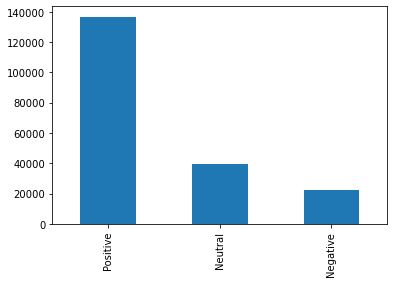

In [155]:
final_df['Sentiment'].value_counts().plot(kind='bar');

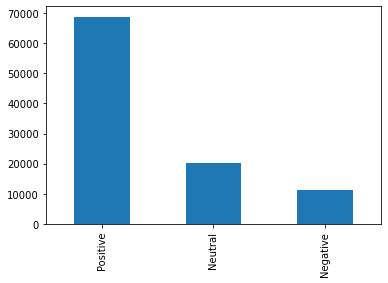

In [156]:
final_df['Sentiment'][0:100001].value_counts().plot(kind='bar');

In [157]:
from wordcloud import WordCloud,STOPWORDS

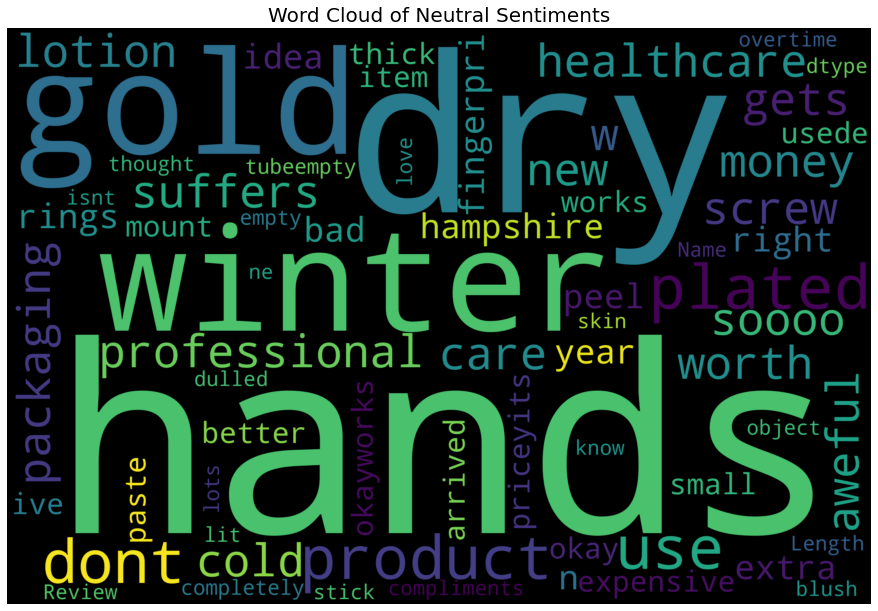

In [158]:
text = final_df[(final_df["Sentiment"] == 'Negative')]['Review']
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(text))
fig = plt.figure(
    figsize = (20, 8),
    facecolor = 'white',
    edgecolor = 'white')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.title("Word Cloud of Neutral Sentiments",fontsize=20)
plt.show()

In [159]:
final_df_use = final_df[:100001]
final_df_use.shape[0]

100001

In [160]:
list1 = []
for i in range(564,589):
  list1.append(i)
 

In [161]:
final_df = final_df.drop(list1,axis=0)

In [162]:
final_df.reset_index(drop=True,inplace=True)

In [163]:
final_df_use['description'][6831]

['',
 'Need help finding your shade? Dermablends makeup shade matching experts are available to assist you at (877)-628-2412.',
 'Our best full coverage foundation makeup with SPF 30. Dermablend Cover Creme is the #1 best-selling crme foundation in the U.S.*Formulated for the most sensitive skin, it provides all-day hydration. Featuring a high concentration of high-performance pigments, this creamy texture is never cakey or masky, providing a natural yet flawless look. Foundation glides on evenly to leave skin feeling fresh, soft and smooth. Versatile makeup foundation formula that can be used as a foundation, a cream concealer and a cream contour. With maximum coverage it can even conceal scars, acne scars, birthmarks, bruising, burns, hyperpigmentation, lupus, vitiligo and post-operative and post-procedure concerns. Provides maximum coverage for up to 16 hours of consistent smudge - and transfer-resistant color wear - when set with Dermablend Setting Powder.',
 'Ingredients: Titanium

In [165]:
import spacy
nlp = spacy.load('en_core_web_sm')
ner = nlp.get_pipe('ner')
brandz = []
product_id = 'B00014GT8W'

product_row = final_df_use.loc[final_df['asin'] == product_id]
product_name = product_row['asin'].values[0]
description = product_row['description'].values[0]
text = f"{product_name} {description}"
doc = nlp(text)
entities = [(ent.text, ent.label_) for ent in doc.ents]
brand_entities = [ent for ent in entities if ent[1] == 'ORG']
brand_name = brand_entities
brand_name

[('OPI', 'ORG'),
 ('OPI', 'ORG'),
 ('OPI', 'ORG'),
 ('OPI', 'ORG'),
 ('OPI Red', 'ORG'),
 ('OPI', 'ORG'),
 ('OPI', 'ORG')]

In [168]:
asi = final_df_use.asin.tolist()
len(asi)

100001

In [175]:
for i in asi:

    try:
        product_row = final_df.loc[final_df['asin'] == i]
        product_name = product_row['asin'].values[0]
        description = product_row['description'].values[0]
        text = f"{product_name} {description}"
        doc = nlp(text)
        entities = [(ent.text, ent.label_) for ent in doc.ents]
        brand_entities = [ent for ent in entities if ent[1] == 'ORG']
        brand_name = brand_entities[0][0]
        print(brand_name)

    except IndexError:
        print("Index out of range")
    continue
    print(brand_name)

Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh Extract
Myrrh 

Index out of range
Index out of range
Index out of range
Index out of range
Index out of range
Index out of range
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthe

Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry
Aesthetic Dentistry


B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW
B00011QUKW

OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI
OPI


KeyboardInterrupt: 

In [185]:
import spacy
nlp = spacy.load('en_core_web_sm')
ner = nlp.get_pipe('ner')
brandz = []

for i,j in enumerate(final_df_use[:50001]):
    try:
        product_id = j
        product_row = final_df_use.loc[final_df_use['asin'] == product_id]
        product_name = product_row['asin'].values[0]
        description = product_row['description'].values[0]
        text = f"{product_name} {description}"
        doc = nlp(text)
        entities = [(ent.text, ent.label_) for ent in doc.ents]
        brand_entities = [ent for ent in entities if ent[1] == 'ORG']
        brand_name = brand_entities[0][0]
        brandz.append(brand_name)
    except IndexError:
        brandz.append("Description not apt")
    continue
    print(brand_name)
  



In [191]:
brandz = []
for i,j in enumerate(asi):

    try:
        product_row = final_df_use.loc[final_df_use['asin'] == j]
        product_name = product_row['asin'].values[0]
        description = product_row['description'].values[0]
        text = f"{product_name} {description}"
        doc = nlp(text)
















    
        entities = [(ent.text, ent.label_) for ent in doc.ents]
        brand_entities = [ent for ent in entities if ent[1] == 'ORG']
        brand_name = brand_entities[0][0]
        brandz.append(brand_name)

        print(i,brand_name)
    except IndexError:
        brandz.append("DNA")
    continue
    print(i,brand_name)



0 Myrrh Extract
1 Myrrh Extract
2 Myrrh Extract
3 Myrrh Extract
4 Myrrh Extract
5 Myrrh Extract
6 Myrrh Extract
7 Myrrh Extract
8 Myrrh Extract
9 Myrrh Extract
10 Myrrh Extract
11 Myrrh Extract
12 Myrrh Extract
13 Myrrh Extract
14 Myrrh Extract
15 Myrrh Extract
16 Myrrh Extract
17 Myrrh Extract
18 Myrrh Extract
19 Myrrh Extract
20 Myrrh Extract
21 Myrrh Extract
22 Myrrh Extract
23 Myrrh Extract
24 Myrrh Extract
25 Myrrh Extract
26 Myrrh Extract
27 Myrrh Extract
28 Myrrh Extract
29 Myrrh Extract
30 Myrrh Extract
31 Myrrh Extract
32 Myrrh Extract
33 Myrrh Extract
34 Myrrh Extract
35 Myrrh Extract
36 Myrrh Extract
37 Myrrh Extract
38 Myrrh Extract
39 Myrrh Extract
40 Myrrh Extract
41 Myrrh Extract
42 Myrrh Extract
43 Myrrh Extract
44 Myrrh Extract
45 Myrrh Extract
46 Myrrh Extract
47 Myrrh Extract
48 Myrrh Extract
49 Myrrh Extract
50 Myrrh Extract
51 Myrrh Extract
52 Myrrh Extract
53 Myrrh Extract
54 Myrrh Extract
55 Myrrh Extract
56 Myrrh Extract
57 Myrrh Extract
58 Myrrh Extract
59 Myrr

465 Myrrh Extract
466 Myrrh Extract
467 Myrrh Extract
468 Myrrh Extract
469 Myrrh Extract
470 Myrrh Extract
471 Myrrh Extract
472 Myrrh Extract
473 Myrrh Extract
474 Myrrh Extract
475 Myrrh Extract
476 Myrrh Extract
477 Myrrh Extract
478 Myrrh Extract
479 Myrrh Extract
480 Myrrh Extract
481 Myrrh Extract
482 Myrrh Extract
483 Myrrh Extract
484 Myrrh Extract
485 Myrrh Extract
486 Myrrh Extract
487 Myrrh Extract
488 Myrrh Extract
489 Myrrh Extract
490 Myrrh Extract
491 Myrrh Extract
492 Myrrh Extract
493 Myrrh Extract
494 Myrrh Extract
495 Myrrh Extract
496 Myrrh Extract
497 Myrrh Extract
498 Myrrh Extract
499 Myrrh Extract
500 Myrrh Extract
501 Myrrh Extract
502 Myrrh Extract
503 Myrrh Extract
504 Myrrh Extract
505 Myrrh Extract
506 Myrrh Extract
507 Myrrh Extract
508 Myrrh Extract
509 Myrrh Extract
510 Myrrh Extract
511 Myrrh Extract
512 Myrrh Extract
513 Myrrh Extract
514 Myrrh Extract
515 Myrrh Extract
516 Myrrh Extract
517 Myrrh Extract
518 Myrrh Extract
519 Myrrh Extract
520 Myrrh 

856 Aesthetic Dentistry
857 Aesthetic Dentistry
858 Aesthetic Dentistry
859 Aesthetic Dentistry
860 Aesthetic Dentistry
861 Aesthetic Dentistry
862 Aesthetic Dentistry
863 Aesthetic Dentistry
864 Aesthetic Dentistry
865 Aesthetic Dentistry
866 Aesthetic Dentistry
867 Aesthetic Dentistry
868 Aesthetic Dentistry
869 Aesthetic Dentistry
870 Aesthetic Dentistry
871 Aesthetic Dentistry
872 Aesthetic Dentistry
873 Aesthetic Dentistry
874 Aesthetic Dentistry
875 Aesthetic Dentistry
876 Aesthetic Dentistry
877 Aesthetic Dentistry
878 Aesthetic Dentistry
879 Aesthetic Dentistry
880 Aesthetic Dentistry
881 Aesthetic Dentistry
882 Aesthetic Dentistry
883 Aesthetic Dentistry
884 Aesthetic Dentistry
885 Aesthetic Dentistry
886 Aesthetic Dentistry
887 Aesthetic Dentistry
888 Aesthetic Dentistry
889 Aesthetic Dentistry
890 Aesthetic Dentistry
891 Aesthetic Dentistry
892 Aesthetic Dentistry
893 Aesthetic Dentistry
894 Aesthetic Dentistry
895 Aesthetic Dentistry
896 Aesthetic Dentistry
897 Aesthetic De

1183 Archipelago Botanicals
1184 Archipelago Botanicals
1185 Archipelago Botanicals
1186 Archipelago Botanicals
1187 Archipelago Botanicals
1188 Archipelago Botanicals
1189 Archipelago Botanicals
1190 Archipelago Botanicals
1191 Archipelago Botanicals
1192 Archipelago Botanicals
1193 Archipelago Botanicals
1194 Archipelago Botanicals
1195 Archipelago Botanicals
1196 Archipelago Botanicals
1197 Archipelago Botanicals
1198 Archipelago Botanicals
1199 Archipelago Botanicals
1200 Archipelago Botanicals
1201 Archipelago Botanicals
1202 Archipelago Botanicals
1203 Archipelago Botanicals
1204 Archipelago Botanicals
1205 Archipelago Botanicals
1206 Archipelago Botanicals
1207 Archipelago Botanicals
1208 Archipelago Botanicals
1209 Archipelago Botanicals
1210 Archipelago Botanicals
1211 Archipelago Botanicals
1212 Archipelago Botanicals
1213 Archipelago Botanicals
1214 Archipelago Botanicals
1215 Archipelago Botanicals
1216 Archipelago Botanicals
1217 Archipelago Botanicals
1218 Archipelago Bot

1612 B00011QUKW
1613 B00011QUKW
1614 B00011QUKW
1615 B00011QUKW
1616 OPI
1617 OPI
1618 OPI
1619 OPI
1620 OPI
1621 OPI
1622 OPI
1623 OPI
1624 OPI
1625 OPI
1626 OPI
1627 OPI
1628 OPI
1629 OPI
1630 OPI
1631 OPI
1632 OPI
1633 OPI
1634 OPI
1635 OPI
1636 OPI
1637 OPI
1638 OPI
1639 OPI
1640 OPI
1641 OPI
1642 OPI
1643 OPI
1644 OPI
1645 OPI
1646 OPI
1647 OPI
1648 OPI
1649 OPI
1650 OPI
1651 OPI
1652 OPI
1653 OPI
1654 OPI
1655 OPI
1656 OPI
1657 OPI
1658 OPI
1659 OPI
1660 OPI
1661 OPI
1662 OPI
1663 OPI
1664 OPI
1665 OPI
1666 OPI
1667 OPI
1668 OPI
1669 OPI
1670 OPI
1671 OPI
1672 OPI
1673 OPI
1674 OPI
1675 OPI
1676 OPI
1677 OPI
1678 OPI
1679 OPI
1680 OPI
1681 OPI
1682 OPI
1683 OPI
1684 OPI
1685 OPI
1686 OPI
1687 OPI
1688 OPI
1689 OPI
1690 OPI
1691 OPI
1692 OPI
1693 OPI
1694 OPI
1695 OPI
1696 OPI
1697 OPI
1698 OPI
1699 OPI
1700 OPI
1701 OPI
1702 OPI
1703 OPI
1704 OPI
1705 OPI
1706 OPI
1707 OPI
1708 OPI
1709 OPI
1710 OPI
1711 OPI
1712 OPI
1713 OPI
1714 OPI
1715 OPI
1716 OPI
1717 OPI
1718 OPI
1719 OPI


2521 OPI
2522 OPI
2523 OPI
2524 OPI
2525 OPI
2526 OPI
2527 OPI
2528 OPI
2529 OPI
2530 OPI
2531 OPI
2532 OPI
2533 OPI
2534 OPI
2535 OPI
2536 OPI
2537 OPI
2538 OPI
2539 OPI
2540 OPI
2541 OPI
2542 OPI
2543 OPI
2544 OPI
2545 OPI
2546 OPI
2547 OPI
2548 OPI
2549 OPI
2550 OPI
2551 OPI
2552 OPI
2553 OPI
2554 OPI
2555 OPI
2556 OPI
2557 OPI
2558 OPI
2559 OPI
2560 OPI
2561 OPI
2562 OPI
2563 OPI
2564 OPI
2565 OPI
2566 OPI
2567 OPI
2568 OPI
2569 OPI
2570 OPI
2571 OPI
2572 OPI
2573 OPI
2574 OPI
2575 OPI
2576 OPI
2577 OPI
2578 OPI
2579 OPI
2580 OPI
2581 OPI
2582 OPI
2583 OPI
2584 OPI
2585 OPI
2586 OPI
2587 OPI
2588 OPI
2589 OPI
2590 OPI
2591 OPI
2592 OPI
2593 OPI
2594 OPI
2595 OPI
2596 OPI
2597 OPI
2598 OPI
2599 OPI
2600 OPI
2601 OPI
2602 OPI
2603 OPI
2604 OPI
2605 OPI
2606 OPI
2607 OPI
2608 OPI
2609 OPI
2610 OPI
2611 OPI
2612 OPI
2613 OPI
2614 OPI
2615 OPI
2616 OPI
2617 OPI
2618 OPI
2619 OPI
2620 OPI
2621 OPI
2622 OPI
2623 OPI
2624 OPI
2625 OPI
2626 OPI
2627 OPI
2628 OPI
2629 OPI
2630 OPI
2631 OPI
2

3434 OPI
3435 OPI
3436 OPI
3437 OPI
3438 OPI
3439 OPI
3440 OPI
3441 OPI
3442 OPI
3443 OPI
3444 OPI
3445 OPI
3446 OPI
3447 OPI
3448 OPI
3449 OPI
3450 OPI
3451 OPI
3452 OPI
3453 OPI
3454 OPI
3455 OPI
3456 OPI
3457 OPI
3458 OPI
3459 OPI
3460 OPI
3461 OPI
3462 OPI
3463 OPI
3464 OPI
3465 OPI
3466 OPI
3467 OPI
3468 OPI
3469 OPI
3470 OPI
3471 OPI
3472 OPI
3473 OPI
3474 OPI
3475 OPI
3476 OPI
3477 OPI
3478 OPI
3479 OPI
3480 OPI
3481 OPI
3482 OPI
3483 OPI
3484 OPI
3485 OPI
3486 OPI
3487 OPI
3488 OPI
3489 OPI
3490 OPI
3491 OPI
3492 OPI
3493 OPI
3494 OPI
3495 OPI
3496 OPI
3497 OPI
3498 OPI
3499 OPI
3500 OPI
3501 OPI
3502 OPI
3503 OPI
3504 OPI
3505 OPI
3506 OPI
3507 OPI
3508 OPI
3509 OPI
3510 OPI
3511 OPI
3512 OPI
3513 OPI
3514 OPI
3515 OPI
3516 OPI
3517 OPI
3518 OPI
3519 OPI
3520 OPI
3521 OPI
3522 OPI
3523 OPI
3524 OPI
3525 OPI
3526 OPI
3527 OPI
3528 OPI
3529 OPI
3530 OPI
3531 OPI
3532 OPI
3533 OPI
3534 OPI
3535 OPI
3536 OPI
3537 OPI
3538 OPI
3539 OPI
3540 OPI
3541 OPI
3542 OPI
3543 OPI
3544 OPI
3

4347 OPI
4348 OPI
4349 OPI
4350 OPI
4351 OPI
4352 OPI
4353 OPI
4354 OPI
4355 OPI
4356 OPI
4357 OPI
4358 OPI
4359 OPI
4360 OPI
4361 OPI
4362 OPI
4363 OPI
4364 OPI
4365 OPI
4366 OPI
4367 OPI
4368 OPI
4369 OPI
4370 OPI
4371 OPI
4372 OPI
4373 OPI
4374 OPI
4375 OPI
4376 OPI
4377 OPI
4378 OPI
4379 OPI
4380 OPI
4381 OPI
4382 OPI
4383 OPI
4384 OPI
4385 OPI
4386 OPI
4387 OPI
4388 OPI
4389 OPI
4390 OPI
4391 OPI
4392 OPI
4393 OPI
4394 OPI
4395 OPI
4396 OPI
4397 OPI
4398 OPI
4399 OPI
4400 OPI
4401 OPI
4402 OPI
4403 OPI
4404 OPI
4405 OPI
4406 OPI
4407 OPI
4408 OPI
4409 OPI
4410 OPI
4411 OPI
4412 OPI
4413 OPI
4414 OPI
4415 OPI
4416 OPI
4417 OPI
4418 OPI
4419 OPI
4420 OPI
4421 OPI
4422 OPI
4423 OPI
4424 OPI
4425 OPI
4426 OPI
4427 OPI
4428 OPI
4429 OPI
4430 OPI
4431 OPI
4432 OPI
4433 OPI
4434 OPI
4435 OPI
4436 OPI
4437 OPI
4438 OPI
4439 OPI
4440 OPI
4441 OPI
4442 OPI
4443 OPI
4444 OPI
4445 OPI
4446 OPI
4447 OPI
4448 OPI
4449 OPI
4450 OPI
4451 OPI
4452 OPI
4453 OPI
4454 OPI
4455 OPI
4456 OPI
4457 OPI
4

5136 OPI Nail Treatments
5137 OPI Nail Treatments
5138 OPI Nail Treatments
5139 OPI Nail Treatments
5140 OPI Nail Treatments
5141 OPI Nail Treatments
5142 OPI Nail Treatments
5143 OPI Nail Treatments
5144 OPI Nail Treatments
5145 OPI Nail Treatments
5146 OPI Nail Treatments
5147 OPI Nail Treatments
5148 OPI Nail Treatments
5149 OPI Nail Treatments
5150 OPI Nail Treatments
5151 OPI Nail Treatments
5152 OPI Nail Treatments
5153 OPI Nail Treatments
5154 OPI Nail Treatments
5155 OPI Nail Treatments
5156 OPI Nail Treatments
5157 OPI Nail Treatments
5158 OPI Nail Treatments
5159 OPI Nail Treatments
5160 OPI Nail Treatments
5161 OPI Nail Treatments
5162 OPI Nail Treatments
5163 OPI Nail Treatments
5164 OPI Nail Treatments
5165 OPI Nail Treatments
5166 OPI Nail Treatments
5167 OPI Nail Treatments
5168 OPI Nail Treatments
5169 OPI Nail Treatments
5170 OPI Nail Treatments
5171 OPI Nail Treatments
5172 OPI Nail Treatments
5173 OPI Nail Treatments
5174 OPI Nail Treatments
5175 OPI Nail Treatments


5464 OPI Nail Treatments
5465 OPI Nail Treatments
5466 OPI Nail Treatments
5467 OPI Nail Treatments
5468 OPI Nail Treatments
5469 OPI Nail Treatments
5470 OPI Nail Treatments
5471 OPI Nail Treatments
5472 OPI Nail Treatments
5473 OPI Nail Treatments
5474 OPI Nail Treatments
5475 OPI Nail Treatments
5476 OPI Nail Treatments
5477 OPI Nail Treatments
5478 OPI Nail Treatments
5479 OPI Nail Treatments
5480 OPI Nail Treatments
5481 OPI Nail Treatments
5482 OPI Nail Treatments
5483 OPI Nail Treatments
5484 OPI Nail Treatments
5485 OPI Nail Treatments
5486 OPI Nail Treatments
5487 OPI Nail Treatments
5488 OPI Nail Treatments
5489 OPI Nail Treatments
5490 OPI Nail Treatments
5491 OPI Nail Treatments
5492 OPI Nail Treatments
5493 OPI Nail Treatments
5494 OPI Nail Treatments
5495 OPI Nail Treatments
5496 OPI Nail Treatments
5497 OPI Nail Treatments
5498 OPI Nail Treatments
5499 OPI Nail Treatments
5500 OPI Nail Treatments
5501 OPI Nail Treatments
5502 OPI Nail Treatments
5503 OPI Nail Treatments


6000 kaolin
6001 kaolin
6002 kaolin
6003 kaolin
6004 kaolin
6005 kaolin
6006 kaolin
6007 kaolin
6008 kaolin
6009 kaolin
6010 kaolin
6011 kaolin
6012 kaolin
6013 kaolin
6014 kaolin
6015 kaolin
6016 kaolin
6017 kaolin
6018 kaolin
6019 kaolin
6020 kaolin
6021 kaolin
6022 kaolin
6023 kaolin
6024 kaolin
6025 kaolin
6026 kaolin
6027 kaolin
6028 kaolin
6029 kaolin
6030 kaolin
6031 kaolin
6032 kaolin
6033 kaolin
6034 kaolin
6035 kaolin
6036 kaolin
6037 kaolin
6038 kaolin
6039 kaolin
6040 kaolin
6041 kaolin
6042 kaolin
6043 kaolin
6044 kaolin
6045 kaolin
6046 kaolin
6047 kaolin
6048 kaolin
6049 kaolin
6050 kaolin
6051 kaolin
6052 kaolin
6053 kaolin
6054 kaolin
6055 kaolin
6056 kaolin
6057 kaolin
6058 kaolin
6059 kaolin
6060 kaolin
6061 kaolin
6062 kaolin
6063 kaolin
6064 kaolin
6065 kaolin
6066 kaolin
6067 kaolin
6068 kaolin
6069 kaolin
6070 kaolin
6071 kaolin
6072 kaolin
6073 kaolin
6074 kaolin
6075 kaolin
6076 kaolin
6077 kaolin
6078 kaolin
6079 kaolin
6080 kaolin
6081 kaolin
6082 kaolin
6083

6684 kaolin
6685 kaolin
6686 kaolin
6687 kaolin
6688 kaolin
6689 kaolin
6690 kaolin
6691 kaolin
6692 kaolin
6693 kaolin
6694 kaolin
6695 kaolin
6696 kaolin
6697 kaolin
6698 kaolin
6699 kaolin
6700 kaolin
6701 kaolin
6702 kaolin
6703 kaolin
6704 kaolin
6705 kaolin
6706 kaolin
6707 kaolin
6708 kaolin
6709 kaolin
6710 kaolin
6711 kaolin
6712 kaolin
6713 kaolin
6714 kaolin
6715 kaolin
6716 kaolin
6717 kaolin
6718 kaolin
6719 kaolin
6720 kaolin
6721 kaolin
6722 kaolin
6723 kaolin
6724 kaolin
6725 kaolin
6726 kaolin
6727 kaolin
6728 kaolin
6729 kaolin
6730 kaolin
6731 kaolin
6732 kaolin
6733 kaolin
6734 kaolin
6735 kaolin
6736 kaolin
6737 kaolin
6738 kaolin
6739 kaolin
6740 kaolin
6741 kaolin
6742 kaolin
6743 kaolin
6744 kaolin
6745 kaolin
6746 kaolin
6747 kaolin
6748 kaolin
6749 kaolin
6750 kaolin
6751 kaolin
6752 kaolin
6753 kaolin
6754 kaolin
6755 kaolin
6756 kaolin
6757 kaolin
6758 kaolin
6759 kaolin
6760 kaolin
6761 kaolin
6762 kaolin
6763 kaolin
6764 kaolin
6765 kaolin
6766 kaolin
6767

7526 B0001EL5R2
7527 B0001EL5R2
7528 B0001EL5R2
7529 B0001EL5R2
7530 B0001EL5R2
7531 B0001EL5R2
7532 B0001EL5R2
7533 B0001EL5R2
7534 B0001EL5R2
7535 B0001EL5R2
7536 B0001EL5R2
7537 B0001EL5R2
7538 B0001EL5R2
7539 B0001EL5R2
7540 B0001EL5R2
7541 B0001EL5R2
7542 B0001EL5R2
7543 B0001EL5R2
7544 B0001EL5R2
7545 B0001EL5R2
7546 B0001EL5R2
7547 B0001EL5R2
7548 B0001EL5R2
7549 B0001EL5R2
7550 B0001EL5R2
7551 B0001EL5R2
7552 B0001EL5R2
7553 B0001EL5R2
7554 B0001EL5R2
7555 B0001EL5R2
7556 B0001EL5R2
7557 B0001EL5R2
7558 B0001EL5R2
7559 B0001EL5R2
7560 B0001EL5R2
7561 B0001EL5R2
7562 B0001EL5R2
7563 B0001EL5R2
7564 B0001EL5R2
7565 B0001EL5R2
7566 B0001EL5R2
7567 B0001EL5R2
7568 B0001EL5R2
7569 B0001EL5R2
7570 B0001EL5R2
7571 B0001EL5R2
7572 B0001EL5R2
7573 B0001EL5R2
7574 B0001EL5R2
7575 B0001EL5R2
7576 B0001EL5R2
7577 B0001EL5R2
7578 B0001EL5R2
7579 B0001EL5R2
7580 B0001EL5R2
7581 B0001EL5R2
7582 B0001EL5R2
7583 B0001EL5R2
7584 B0001EL5R2
7585 B0001EL5R2
7586 B0001EL5R2
7587 B0001EL5R2
7588 B00

8396 B00021AKJI
8397 B00021AKJI
8398 B00021AKJI
8399 B00021AKJI
8400 B00021AKJI
8401 B00021AKJI
8402 B00021AKJI
8403 B00021AKJI
8404 B00021AKJI
8405 B00021AKJI
8406 B00021AKJI
8407 B00021AKJI
8408 B00021AKJI
8409 B00021AKJI
8410 B00021AKJI
8411 B00021AKJI
8412 B00021AKJI
8413 B00021AKJI
8414 B00021AKJI
8415 B00021AKJI
8416 B00021AKJI
8417 B00021AKJI
8418 B00021AKJI
8419 B00021AKJI
8420 B00021AKJI
8421 B00021AKJI
8422 B00021AKJI
8423 B00021AKJI
8424 B00021AKJI
8425 B00021AKJI
8426 B00021AKJI
8427 B00021AKJI
8428 B00021AKJI
8429 B00021AKJI
8430 B00021AKJI
8431 B00021AKJI
8432 B00021AKJI
8433 B00021AKJI
8434 B00021AKJI
8435 B00021AKJI
8436 B00021AKJI
8437 B00021AKJI
8438 B00021AKJI
8439 B00021AKJI
8440 B00021AKJI
8441 B00021AKJI
8442 B00021AKJI
8443 B00021AKJI
8444 B00021AKJI
8445 B00021AKJI
8446 B00021AKJI
8447 B00021AKJI
8448 B00021AKJI
8449 B00021AKJI
8450 B00021AKJI
8451 B00021AKJI
8452 B00021AKJI
8453 B00021AKJI
8454 B00021AKJI
8455 B00021AKJI
8456 B00021AKJI
8457 B00021AKJI
8458 B00

9004 UVA
9005 UVA
9006 UVA
9007 UVA
9008 UVA
9009 UVA
9010 UVA
9011 UVA
9012 UVA
9013 UVA
9014 UVA
9015 UVA
9016 UVA
9017 UVA
9018 UVA
9019 UVA
9020 UVA
9021 UVA
9022 UVA
9023 UVA
9024 UVA
9025 UVA
9026 UVA
9027 UVA
9028 UVA
9029 UVA
9030 UVA
9031 UVA
9032 UVA
9033 UVA
9034 UVA
9035 UVA
9036 UVA
9037 UVA
9038 UVA
9039 UVA
9040 UVA
9041 UVA
9042 UVA
9043 UVA
9044 UVA
9045 UVA
9046 UVA
9047 UVA
9048 UVA
9049 UVA
9050 UVA
9051 UVA
9052 UVA
9053 UVA
9054 UVA
9055 UVA
9056 UVA
9057 UVA
9058 UVA
9059 UVA
9060 UVA
9061 UVA
9062 UVA
9063 UVA
9064 UVA
9065 UVA
9066 UVA
9067 UVA
9068 UVA
9069 UVA
9070 UVA
9071 UVA
9072 UVA
9073 UVA
9074 UVA
9075 UVA
9076 UVA
9077 UVA
9078 UVA
9079 UVA
9080 UVA
9081 UVA
9082 UVA
9083 UVA
9084 UVA
9085 UVA
9086 UVA
9087 UVA
9088 UVA
9089 UVA
9090 UVA
9091 UVA
9092 UVA
9093 UVA
9094 UVA
9095 UVA
9096 UVA
9097 UVA
9098 UVA
9099 UVA
9100 UVA
9101 UVA
9102 UVA
9103 UVA
9104 UVA
9105 UVA
9106 UVA
9107 UVA
9108 UVA
9109 UVA
9110 UVA
9111 UVA
9112 UVA
9113 UVA
9114 UVA
9

9830 Nourishing Stick
9831 Nourishing Stick
9832 Nourishing Stick
9833 Nourishing Stick
9834 Nourishing Stick
9835 Nourishing Stick
9836 Nourishing Stick
9837 Nourishing Stick
9838 Nourishing Stick
9839 Nourishing Stick
9840 Nourishing Stick
9841 Nourishing Stick
9842 Nourishing Stick
9843 Nourishing Stick
9844 Nourishing Stick
9845 Nourishing Stick
9846 Nourishing Stick
9847 Nourishing Stick
9848 Nourishing Stick
9849 Nourishing Stick
9850 Nourishing Stick
9851 Nourishing Stick
9852 Nourishing Stick
9853 Nourishing Stick
9854 Nourishing Stick
9855 Nourishing Stick
9856 Nourishing Stick
9857 Nourishing Stick
9858 Nourishing Stick
9859 Nourishing Stick
9860 Nourishing Stick
9861 Nourishing Stick
9862 Nourishing Stick
9863 Nourishing Stick
9864 Nourishing Stick
9865 Nourishing Stick
9866 Nourishing Stick
9867 Nourishing Stick
9868 Nourishing Stick
9869 Nourishing Stick
9870 Nourishing Stick
9871 Nourishing Stick
9872 Nourishing Stick
9873 Nourishing Stick
9874 Nourishing Stick
9875 Nouri

10608 Gold Plated Salon Curling Iron/Wand -1111'
10609 Gold Plated Salon Curling Iron/Wand -1111'
10610 Gold Plated Salon Curling Iron/Wand -1111'
10611 Gold Plated Salon Curling Iron/Wand -1111'
10612 Gold Plated Salon Curling Iron/Wand -1111'
10613 Gold Plated Salon Curling Iron/Wand -1111'
10614 Gold Plated Salon Curling Iron/Wand -1111'
10615 Gold Plated Salon Curling Iron/Wand -1111'
10616 Gold Plated Salon Curling Iron/Wand -1111'
10617 Gold Plated Salon Curling Iron/Wand -1111'
10618 Gold Plated Salon Curling Iron/Wand -1111'
10619 Gold Plated Salon Curling Iron/Wand -1111'
10620 Gold Plated Salon Curling Iron/Wand -1111'
10621 Gold Plated Salon Curling Iron/Wand -1111'
10622 Gold Plated Salon Curling Iron/Wand -1111'
10623 Gold Plated Salon Curling Iron/Wand -1111'
10624 Gold Plated Salon Curling Iron/Wand -1111'
10625 Gold Plated Salon Curling Iron/Wand -1111'
10626 Gold Plated Salon Curling Iron/Wand -1111'
10627 Gold Plated Salon Curling Iron/Wand -1111'
10628 Gold Plated Sa

10780 Gold Plated Salon Curling Iron/Wand -1111'
10781 Gold Plated Salon Curling Iron/Wand -1111'
10782 Gold Plated Salon Curling Iron/Wand -1111'
10783 Gold Plated Salon Curling Iron/Wand -1111'
10784 Gold Plated Salon Curling Iron/Wand -1111'
10785 Gold Plated Salon Curling Iron/Wand -1111'
10786 Gold Plated Salon Curling Iron/Wand -1111'
10787 Gold Plated Salon Curling Iron/Wand -1111'
10788 Gold Plated Salon Curling Iron/Wand -1111'
10789 Gold Plated Salon Curling Iron/Wand -1111'
10790 Gold Plated Salon Curling Iron/Wand -1111'
10791 Gold Plated Salon Curling Iron/Wand -1111'
10792 Gold Plated Salon Curling Iron/Wand -1111'
10793 Gold Plated Salon Curling Iron/Wand -1111'
10794 Gold Plated Salon Curling Iron/Wand -1111'
10795 Gold Plated Salon Curling Iron/Wand -1111'
10796 Gold Plated Salon Curling Iron/Wand -1111'
10797 Gold Plated Salon Curling Iron/Wand -1111'
10798 Gold Plated Salon Curling Iron/Wand -1111'
10799 Gold Plated Salon Curling Iron/Wand -1111'
10800 Gold Plated Sa

10948 Gold Plated Salon Curling Iron/Wand -1111'
10949 Gold Plated Salon Curling Iron/Wand -1111'
10950 Gold Plated Salon Curling Iron/Wand -1111'
10951 Gold Plated Salon Curling Iron/Wand -1111'
10952 Gold Plated Salon Curling Iron/Wand -1111'
10953 Gold Plated Salon Curling Iron/Wand -1111'
10954 Gold Plated Salon Curling Iron/Wand -1111'
10955 Gold Plated Salon Curling Iron/Wand -1111'
10956 Gold Plated Salon Curling Iron/Wand -1111'
10957 Gold Plated Salon Curling Iron/Wand -1111'
10958 Gold Plated Salon Curling Iron/Wand -1111'
10959 Gold Plated Salon Curling Iron/Wand -1111'
10960 Gold Plated Salon Curling Iron/Wand -1111'
10961 Gold Plated Salon Curling Iron/Wand -1111'
10962 Gold Plated Salon Curling Iron/Wand -1111'
10963 Gold Plated Salon Curling Iron/Wand -1111'
10964 Gold Plated Salon Curling Iron/Wand -1111'
10965 Gold Plated Salon Curling Iron/Wand -1111'
10966 Gold Plated Salon Curling Iron/Wand -1111'
10967 Gold Plated Salon Curling Iron/Wand -1111'
10968 Gold Plated Sa

11119 Gold Plated Salon Curling Iron/Wand -1111'
11120 Gold Plated Salon Curling Iron/Wand -1111'
11121 Gold Plated Salon Curling Iron/Wand -1111'
11122 Gold Plated Salon Curling Iron/Wand -1111'
11123 Gold Plated Salon Curling Iron/Wand -1111'
11124 Gold Plated Salon Curling Iron/Wand -1111'
11125 Gold Plated Salon Curling Iron/Wand -1111'
11126 Gold Plated Salon Curling Iron/Wand -1111'
11127 Gold Plated Salon Curling Iron/Wand -1111'
11128 Gold Plated Salon Curling Iron/Wand -1111'
11129 Gold Plated Salon Curling Iron/Wand -1111'
11130 Gold Plated Salon Curling Iron/Wand -1111'
11131 Gold Plated Salon Curling Iron/Wand -1111'
11132 Gold Plated Salon Curling Iron/Wand -1111'
11133 Gold Plated Salon Curling Iron/Wand -1111'
11134 Gold Plated Salon Curling Iron/Wand -1111'
11135 Gold Plated Salon Curling Iron/Wand -1111'
11136 Gold Plated Salon Curling Iron/Wand -1111'
11137 Gold Plated Salon Curling Iron/Wand -1111'
11138 Gold Plated Salon Curling Iron/Wand -1111'
11139 Gold Plated Sa

11554 Amazon
11555 Amazon
11556 Amazon
11557 Amazon
11558 Amazon
11559 Amazon
11560 Amazon
11561 Amazon
11562 Amazon
11563 Amazon
11564 Amazon
11565 Amazon
11566 Amazon
11567 Amazon
11568 Amazon
11569 Amazon
11570 Amazon
11571 Amazon
11572 Amazon
11573 Amazon
11574 Amazon
11575 Amazon
11576 Amazon
11577 Amazon
11578 Amazon
11579 Amazon
11580 Amazon
11581 Amazon
11582 Amazon
11583 Amazon
11584 Amazon
11585 Amazon
11586 Amazon
11587 Amazon
11588 Amazon
11589 Amazon
11590 Amazon
11591 Amazon
11592 Amazon
11593 Amazon
11594 Amazon
11595 Amazon
11596 Amazon
11597 Amazon
11598 Amazon
11599 Amazon
11600 Amazon
11601 Amazon
11602 Amazon
11603 Amazon
11604 Amazon
11605 Amazon
11606 Amazon
11607 Amazon
11608 Amazon
11609 Amazon
11610 Amazon
11611 Amazon
11612 Amazon
11613 Amazon
11614 Amazon
11615 Amazon
11616 Amazon
11617 Amazon
11618 Amazon
11619 Amazon
11620 Amazon
11621 Amazon
11622 Amazon
11623 Amazon
11624 Amazon
11625 Amazon
11626 Amazon
11627 Amazon
11628 Amazon
11629 Amazon
11630 Amazon

12311 Professional Spring Curling Iron
12312 Professional Spring Curling Iron
12313 Professional Spring Curling Iron
12314 Professional Spring Curling Iron
12315 Professional Spring Curling Iron
12316 Professional Spring Curling Iron
12317 Professional Spring Curling Iron
12318 Professional Spring Curling Iron
12319 Professional Spring Curling Iron
12320 Professional Spring Curling Iron
12321 Professional Spring Curling Iron
12322 Professional Spring Curling Iron
12323 Professional Spring Curling Iron
12324 Professional Spring Curling Iron
12325 Professional Spring Curling Iron
12326 Professional Spring Curling Iron
12327 Professional Spring Curling Iron
12328 Professional Spring Curling Iron
12329 Professional Spring Curling Iron
12330 Professional Spring Curling Iron
12331 Professional Spring Curling Iron
12332 Professional Spring Curling Iron
12333 Professional Spring Curling Iron
12334 Professional Spring Curling Iron
12335 Professional Spring Curling Iron
12336 Professional Spring

12635 SPF
12636 SPF
12637 SPF
12638 SPF
12639 SPF
12640 SPF
12641 SPF
12642 SPF
12643 SPF
12644 SPF
12645 SPF
12646 SPF
12647 SPF
12648 SPF
12649 SPF
12650 SPF
12651 SPF
12652 SPF
12653 SPF
12654 SPF
12655 SPF
12656 SPF
12657 SPF
12658 SPF
12659 SPF
12660 SPF
12661 SPF
12662 SPF
12663 SPF
12664 SPF
12665 SPF
12666 SPF
12667 SPF
12668 SPF
12669 SPF
12670 SPF
12671 SPF
12672 SPF
12673 SPF
12674 SPF
12675 SPF
12676 SPF
12677 SPF
12678 SPF
12679 SPF
12680 SPF
12681 SPF
12682 SPF
12683 SPF
12684 SPF
12685 SPF
12686 SPF
12687 SPF
12688 SPF
12689 SPF
12690 SPF
12691 SPF
12692 SPF
12693 SPF
12694 SPF
12695 SPF
12696 SPF
12697 SPF
12698 SPF
12699 SPF
12700 SPF
12701 SPF
12702 SPF
12703 SPF
12704 SPF
12705 SPF
12706 SPF
12707 SPF
12708 SPF
12709 SPF
12710 SPF
12711 SPF
12712 SPF
12713 SPF
12714 SPF
12715 SPF
12716 SPF
12717 SPF
12718 SPF
12719 SPF
12720 SPF
12721 SPF
12722 SPF
12723 SPF
12724 SPF
12725 SPF
12726 SPF
12727 SPF
12728 SPF
12729 SPF
12730 SPF
12731 SPF
12732 SPF
12733 SPF
12734 SPF


13512 Silica, Phenoxyethanol
13513 Silica, Phenoxyethanol
13514 Silica, Phenoxyethanol
13515 Silica, Phenoxyethanol
13516 Silica, Phenoxyethanol
13517 Silica, Phenoxyethanol
13518 Silica, Phenoxyethanol
13519 Silica, Phenoxyethanol
13520 Silica, Phenoxyethanol
13521 Silica, Phenoxyethanol
13522 Silica, Phenoxyethanol
13523 Silica, Phenoxyethanol
13524 Silica, Phenoxyethanol
13525 Silica, Phenoxyethanol
13526 Silica, Phenoxyethanol
13527 Silica, Phenoxyethanol
13528 Silica, Phenoxyethanol
13529 Silica, Phenoxyethanol
13530 Silica, Phenoxyethanol
13531 Silica, Phenoxyethanol
13532 Silica, Phenoxyethanol
13533 Silica, Phenoxyethanol
13534 Silica, Phenoxyethanol
13535 Silica, Phenoxyethanol
13536 Silica, Phenoxyethanol
13537 Silica, Phenoxyethanol
13538 Silica, Phenoxyethanol
13539 Silica, Phenoxyethanol
13540 Silica, Phenoxyethanol
13541 Silica, Phenoxyethanol
13542 Silica, Phenoxyethanol
13543 Silica, Phenoxyethanol
13544 Silica, Phenoxyethanol
13545 Silica, Phenoxyethanol
13546 Silica, 

13800 Silica, Phenoxyethanol
13801 Silica, Phenoxyethanol
13802 Silica, Phenoxyethanol
13803 Silica, Phenoxyethanol
13804 Silica, Phenoxyethanol
13805 Silica, Phenoxyethanol
13806 Silica, Phenoxyethanol
13807 Silica, Phenoxyethanol
13808 Silica, Phenoxyethanol
13809 Silica, Phenoxyethanol
13810 Silica, Phenoxyethanol
13811 Silica, Phenoxyethanol
13812 Silica, Phenoxyethanol
13813 Silica, Phenoxyethanol
13814 Silica, Phenoxyethanol
13815 Silica, Phenoxyethanol
13816 Silica, Phenoxyethanol
13817 Silica, Phenoxyethanol
13818 Silica, Phenoxyethanol
13819 Silica, Phenoxyethanol
13820 Silica, Phenoxyethanol
13821 Silica, Phenoxyethanol
13822 Silica, Phenoxyethanol
13823 Silica, Phenoxyethanol
13824 Silica, Phenoxyethanol
13825 Silica, Phenoxyethanol
13826 Silica, Phenoxyethanol
13827 Silica, Phenoxyethanol
13828 Silica, Phenoxyethanol
13829 Silica, Phenoxyethanol
13830 Silica, Phenoxyethanol
13831 Silica, Phenoxyethanol
13832 Silica, Phenoxyethanol
13833 Silica, Phenoxyethanol
13834 Silica, 

14084 Silica, Phenoxyethanol
14085 Silica, Phenoxyethanol
14086 Silica, Phenoxyethanol
14087 Silica, Phenoxyethanol
14088 Silica, Phenoxyethanol
14089 Silica, Phenoxyethanol
14090 Silica, Phenoxyethanol
14091 Silica, Phenoxyethanol
14092 Silica, Phenoxyethanol
14093 Silica, Phenoxyethanol
14094 Silica, Phenoxyethanol
14095 Silica, Phenoxyethanol
14096 Silica, Phenoxyethanol
14097 Silica, Phenoxyethanol
14098 Silica, Phenoxyethanol
14099 Silica, Phenoxyethanol
14100 Silica, Phenoxyethanol
14101 Silica, Phenoxyethanol
14102 Silica, Phenoxyethanol
14103 Silica, Phenoxyethanol
14104 Silica, Phenoxyethanol
14105 Silica, Phenoxyethanol
14106 Silica, Phenoxyethanol
14107 Silica, Phenoxyethanol
14108 Silica, Phenoxyethanol
14109 Silica, Phenoxyethanol
14110 Silica, Phenoxyethanol
14111 Silica, Phenoxyethanol
14112 Silica, Phenoxyethanol
14113 Silica, Phenoxyethanol
14114 Silica, Phenoxyethanol
14115 Silica, Phenoxyethanol
14116 Silica, Phenoxyethanol
14117 Silica, Phenoxyethanol
14118 Silica, 

14372 Silica, Phenoxyethanol
14373 Silica, Phenoxyethanol
14374 Silica, Phenoxyethanol
14375 Silica, Phenoxyethanol
14376 Silica, Phenoxyethanol
14377 Silica, Phenoxyethanol
14378 Silica, Phenoxyethanol
14379 Silica, Phenoxyethanol
14380 Silica, Phenoxyethanol
14381 Silica, Phenoxyethanol
14382 Silica, Phenoxyethanol
14383 Silica, Phenoxyethanol
14384 Silica, Phenoxyethanol
14385 Silica, Phenoxyethanol
14386 Silica, Phenoxyethanol
14387 Silica, Phenoxyethanol
14388 Silica, Phenoxyethanol
14389 Silica, Phenoxyethanol
14390 Silica, Phenoxyethanol
14391 Silica, Phenoxyethanol
14392 Silica, Phenoxyethanol
14393 Silica, Phenoxyethanol
14394 Silica, Phenoxyethanol
14395 Silica, Phenoxyethanol
14396 Silica, Phenoxyethanol
14397 Silica, Phenoxyethanol
14398 Silica, Phenoxyethanol
14399 Silica, Phenoxyethanol
14400 Silica, Phenoxyethanol
14401 Silica, Phenoxyethanol
14402 Silica, Phenoxyethanol
14403 Silica, Phenoxyethanol
14404 Silica, Phenoxyethanol
14405 Silica, Phenoxyethanol
14406 Silica, 

14656 Silica, Phenoxyethanol
14657 Silica, Phenoxyethanol
14658 Silica, Phenoxyethanol
14659 Silica, Phenoxyethanol
14660 Silica, Phenoxyethanol
14661 Silica, Phenoxyethanol
14662 Silica, Phenoxyethanol
14663 Silica, Phenoxyethanol
14664 Silica, Phenoxyethanol
14665 Silica, Phenoxyethanol
14666 Silica, Phenoxyethanol
14667 Silica, Phenoxyethanol
14668 Silica, Phenoxyethanol
14669 Silica, Phenoxyethanol
14670 Silica, Phenoxyethanol
14671 Silica, Phenoxyethanol
14672 Silica, Phenoxyethanol
14673 Silica, Phenoxyethanol
14674 Silica, Phenoxyethanol
14675 Silica, Phenoxyethanol
14676 Silica, Phenoxyethanol
14677 Silica, Phenoxyethanol
14678 Silica, Phenoxyethanol
14679 Silica, Phenoxyethanol
14680 Silica, Phenoxyethanol
14681 Silica, Phenoxyethanol
14682 Silica, Phenoxyethanol
14683 Silica, Phenoxyethanol
14684 Silica, Phenoxyethanol
14685 Silica, Phenoxyethanol
14686 Silica, Phenoxyethanol
14687 Silica, Phenoxyethanol
14688 Silica, Phenoxyethanol
14689 Silica, Phenoxyethanol
14690 Silica, 

14944 Silica, Phenoxyethanol
14945 Silica, Phenoxyethanol
14946 Silica, Phenoxyethanol
14947 Silica, Phenoxyethanol
14948 Silica, Phenoxyethanol
14949 Silica, Phenoxyethanol
14950 Silica, Phenoxyethanol
14951 Silica, Phenoxyethanol
14952 Silica, Phenoxyethanol
14953 Silica, Phenoxyethanol
14954 Silica, Phenoxyethanol
14955 Silica, Phenoxyethanol
14956 Silica, Phenoxyethanol
14957 Silica, Phenoxyethanol
14958 Silica, Phenoxyethanol
14959 Silica, Phenoxyethanol
14960 Silica, Phenoxyethanol
14961 Silica, Phenoxyethanol
14962 Silica, Phenoxyethanol
14963 Silica, Phenoxyethanol
14964 Silica, Phenoxyethanol
14965 Silica, Phenoxyethanol
14966 Silica, Phenoxyethanol
14967 Silica, Phenoxyethanol
14968 Silica, Phenoxyethanol
14969 Silica, Phenoxyethanol
14970 Silica, Phenoxyethanol
14971 Silica, Phenoxyethanol
14972 Silica, Phenoxyethanol
14973 Silica, Phenoxyethanol
14974 Silica, Phenoxyethanol
14975 Silica, Phenoxyethanol
14976 Silica, Phenoxyethanol
14977 Silica, Phenoxyethanol
14978 Silica, 

15227 Silica, Phenoxyethanol
15228 Silica, Phenoxyethanol
15229 Silica, Phenoxyethanol
15230 Silica, Phenoxyethanol
15231 Silica, Phenoxyethanol
15232 Silica, Phenoxyethanol
15233 Silica, Phenoxyethanol
15234 Silica, Phenoxyethanol
15235 Silica, Phenoxyethanol
15236 Silica, Phenoxyethanol
15237 Silica, Phenoxyethanol
15238 Silica, Phenoxyethanol
15239 Silica, Phenoxyethanol
15240 Silica, Phenoxyethanol
15241 Silica, Phenoxyethanol
15242 Silica, Phenoxyethanol
15243 Silica, Phenoxyethanol
15244 Silica, Phenoxyethanol
15245 Silica, Phenoxyethanol
15246 Silica, Phenoxyethanol
15247 Silica, Phenoxyethanol
15248 Silica, Phenoxyethanol
15249 Silica, Phenoxyethanol
15250 Silica, Phenoxyethanol
15251 Silica, Phenoxyethanol
15252 Silica, Phenoxyethanol
15253 Silica, Phenoxyethanol
15254 Silica, Phenoxyethanol
15255 Silica, Phenoxyethanol
15256 Silica, Phenoxyethanol
15257 Silica, Phenoxyethanol
15258 Silica, Phenoxyethanol
15259 Silica, Phenoxyethanol
15260 Silica, Phenoxyethanol
15261 Silica, 

15510 Silica, Phenoxyethanol
15511 Silica, Phenoxyethanol
15512 Silica, Phenoxyethanol
15513 Silica, Phenoxyethanol
15514 Silica, Phenoxyethanol
15515 Silica, Phenoxyethanol
15516 Silica, Phenoxyethanol
15517 Silica, Phenoxyethanol
15518 Silica, Phenoxyethanol
15519 Silica, Phenoxyethanol
15520 Silica, Phenoxyethanol
15521 Silica, Phenoxyethanol
15522 Silica, Phenoxyethanol
15523 Silica, Phenoxyethanol
15524 Silica, Phenoxyethanol
15525 Silica, Phenoxyethanol
15526 Silica, Phenoxyethanol
15527 Silica, Phenoxyethanol
15528 Silica, Phenoxyethanol
15529 Silica, Phenoxyethanol
15530 Silica, Phenoxyethanol
15531 Silica, Phenoxyethanol
15532 Silica, Phenoxyethanol
15533 Silica, Phenoxyethanol
15534 Silica, Phenoxyethanol
15535 Silica, Phenoxyethanol
15536 Silica, Phenoxyethanol
15537 Silica, Phenoxyethanol
15538 Silica, Phenoxyethanol
15539 Silica, Phenoxyethanol
15540 Silica, Phenoxyethanol
15541 Silica, Phenoxyethanol
15542 Silica, Phenoxyethanol
15543 Silica, Phenoxyethanol
15544 Silica, 

15796 Silica, Phenoxyethanol
15797 Silica, Phenoxyethanol
15798 Silica, Phenoxyethanol
15799 Silica, Phenoxyethanol
15800 Silica, Phenoxyethanol
15801 Silica, Phenoxyethanol
15802 Silica, Phenoxyethanol
15803 Silica, Phenoxyethanol
15804 Silica, Phenoxyethanol
15805 Silica, Phenoxyethanol
15806 Silica, Phenoxyethanol
15807 Silica, Phenoxyethanol
15808 Silica, Phenoxyethanol
15809 Silica, Phenoxyethanol
15810 Silica, Phenoxyethanol
15811 Silica, Phenoxyethanol
15812 Silica, Phenoxyethanol
15813 Silica, Phenoxyethanol
15814 Silica, Phenoxyethanol
15815 Silica, Phenoxyethanol
15816 Silica, Phenoxyethanol
15817 Silica, Phenoxyethanol
15818 Silica, Phenoxyethanol
15819 Silica, Phenoxyethanol
15820 Silica, Phenoxyethanol
15821 Silica, Phenoxyethanol
15822 Silica, Phenoxyethanol
15823 Silica, Phenoxyethanol
15824 Silica, Phenoxyethanol
15825 Silica, Phenoxyethanol
15826 Silica, Phenoxyethanol
15827 Silica, Phenoxyethanol
15828 Silica, Phenoxyethanol
15829 Silica, Phenoxyethanol
15830 Silica, 

16082 Silica, Phenoxyethanol
16083 Silica, Phenoxyethanol
16084 Silica, Phenoxyethanol
16085 Silica, Phenoxyethanol
16086 Silica, Phenoxyethanol
16087 Silica, Phenoxyethanol
16088 Silica, Phenoxyethanol
16089 Silica, Phenoxyethanol
16090 Silica, Phenoxyethanol
16091 Silica, Phenoxyethanol
16092 Silica, Phenoxyethanol
16093 Silica, Phenoxyethanol
16094 Silica, Phenoxyethanol
16095 Silica, Phenoxyethanol
16096 Silica, Phenoxyethanol
16097 Silica, Phenoxyethanol
16098 Silica, Phenoxyethanol
16099 Silica, Phenoxyethanol
16100 Silica, Phenoxyethanol
16101 Silica, Phenoxyethanol
16102 Silica, Phenoxyethanol
16103 Silica, Phenoxyethanol
16104 Silica, Phenoxyethanol
16105 Silica, Phenoxyethanol
16106 Silica, Phenoxyethanol
16107 Silica, Phenoxyethanol
16108 Silica, Phenoxyethanol
16109 Silica, Phenoxyethanol
16110 Silica, Phenoxyethanol
16111 Silica, Phenoxyethanol
16112 Silica, Phenoxyethanol
16113 Silica, Phenoxyethanol
16114 Silica, Phenoxyethanol
16115 Silica, Phenoxyethanol
16116 Silica, 

16365 Silica, Phenoxyethanol
16366 Silica, Phenoxyethanol
16367 Silica, Phenoxyethanol
16368 Silica, Phenoxyethanol
16369 Silica, Phenoxyethanol
16370 Silica, Phenoxyethanol
16371 Silica, Phenoxyethanol
16372 Silica, Phenoxyethanol
16373 Silica, Phenoxyethanol
16374 Silica, Phenoxyethanol
16375 Silica, Phenoxyethanol
16376 Silica, Phenoxyethanol
16377 Silica, Phenoxyethanol
16378 Silica, Phenoxyethanol
16379 Marvis Jasmin Mint
16380 Marvis Jasmin Mint
16381 Marvis Jasmin Mint
16382 Marvis Jasmin Mint
16383 Marvis Jasmin Mint
16384 Marvis Jasmin Mint
16385 Marvis Jasmin Mint
16386 Marvis Jasmin Mint
16387 Marvis Jasmin Mint
16388 Marvis Jasmin Mint
16389 Marvis Jasmin Mint
16390 Marvis Jasmin Mint
16391 Marvis Jasmin Mint
16392 Marvis Jasmin Mint
16393 Marvis Jasmin Mint
16394 Marvis Jasmin Mint
16395 Marvis Jasmin Mint
16396 Marvis Jasmin Mint
16397 Marvis Jasmin Mint
16398 Marvis Jasmin Mint
16399 Marvis Jasmin Mint
16400 Marvis Jasmin Mint
16401 Marvis Jasmin Mint
16402 Marvis Jasmin

16695 Marvis Jasmin Mint
16696 Marvis Jasmin Mint
16697 Marvis Jasmin Mint
16698 Marvis Jasmin Mint
16699 Marvis Jasmin Mint
16700 Marvis Jasmin Mint
16701 Marvis Jasmin Mint
16702 Marvis Jasmin Mint
16703 Marvis Jasmin Mint
16704 Marvis Jasmin Mint
16705 Marvis Jasmin Mint
16706 Marvis Jasmin Mint
16707 Marvis Jasmin Mint
16708 Marvis Jasmin Mint
16709 Marvis Jasmin Mint
16710 Marvis Jasmin Mint
16711 Marvis Jasmin Mint
16712 Marvis Jasmin Mint
16713 Marvis Jasmin Mint
16714 Marvis Jasmin Mint
16715 Marvis Jasmin Mint
16716 Marvis Jasmin Mint
16717 Marvis Jasmin Mint
16718 Marvis Jasmin Mint
16719 Marvis Jasmin Mint
16720 Marvis Jasmin Mint
16721 Marvis Jasmin Mint
16722 Marvis Jasmin Mint
16723 Marvis Jasmin Mint
16724 Marvis Jasmin Mint
16725 Marvis Jasmin Mint
16726 Marvis Jasmin Mint
16727 Marvis Jasmin Mint
16728 Marvis Jasmin Mint
16729 Marvis Jasmin Mint
16730 Marvis Jasmin Mint
16731 Marvis Jasmin Mint
16732 Marvis Jasmin Mint
16733 B0006B4VVW
16734 B0006B4VVW
16735 B0006B4VVW

17280 PureScience
17281 PureScience
17282 PureScience
17283 PureScience
17284 PureScience
17285 PureScience
17286 PureScience
17287 PureScience
17288 PureScience
17289 PureScience
17290 PureScience
17291 PureScience
17292 PureScience
17293 PureScience
17294 PureScience
17295 PureScience
17296 PureScience
17297 PureScience
17298 PureScience
17299 PureScience
17300 PureScience
17301 PureScience
17302 PureScience
17303 PureScience
17304 PureScience
17305 PureScience
17306 PureScience
17307 PureScience
17308 PureScience
17309 PureScience
17310 PureScience
17311 PureScience
17312 PureScience
17313 PureScience
17314 PureScience
17315 PureScience
17316 PureScience
17317 PureScience
17318 PureScience
17319 PureScience
17320 PureScience
17321 PureScience
17322 PureScience
17323 PureScience
17324 PureScience
17325 PureScience
17326 PureScience
17327 PureScience
17328 PureScience
17329 PureScience
17330 PureScience
17331 PureScience
17332 PureScience
17333 PureScience
17334 PureScience
17335 Pure

17843 DBP
17844 DBP
17845 DBP
17846 DBP
17847 DBP
17848 DBP
17849 DBP
17850 DBP
17851 DBP
17852 DBP
17853 DBP
17854 DBP
17855 DBP
17856 DBP
17857 DBP
17858 DBP
17859 DBP
17860 DBP
17861 DBP
17862 DBP
17863 DBP
17864 DBP
17865 DBP
17866 DBP
17867 DBP
17868 DBP
17869 DBP
17870 DBP
17871 DBP
17872 DBP
17873 DBP
17874 DBP
17875 DBP
17876 DBP
17877 DBP
17878 DBP
17879 DBP
17880 DBP
17881 DBP
17882 DBP
17883 DBP
17884 DBP
17885 DBP
17886 DBP
17887 DBP
17888 DBP
17889 DBP
17890 DBP
17891 DBP
17892 DBP
17893 DBP
17894 DBP
17895 DBP
17896 DBP
17897 DBP
17898 DBP
17899 DBP
17900 DBP
17901 DBP
17902 DBP
17903 DBP
17904 DBP
17905 DBP
17906 DBP
17907 DBP
17908 DBP
17909 DBP
17910 DBP
17911 DBP
17912 DBP
17913 DBP
17914 DBP
17915 DBP
17916 DBP
17917 DBP
17918 DBP
17919 DBP
17920 DBP
17921 DBP
17922 DBP
17923 DBP
17924 DBP
17925 DBP
17926 DBP
17927 DBP
17928 DBP
17929 DBP
17930 DBP
17931 DBP
17932 DBP
17933 DBP
17934 DBP
17935 DBP
17936 DBP
17937 DBP
17938 DBP
17939 DBP
17940 DBP
17941 DBP
17942 DBP


18664 DBP
18665 DBP
18666 DBP
18667 DBP
18668 DBP
18669 DBP
18670 DBP
18671 DBP
18672 DBP
18673 DBP
18674 DBP
18675 DBP
18676 DBP
18677 DBP
18678 DBP
18679 DBP
18680 DBP
18681 DBP
18682 DBP
18683 DBP
18684 DBP
18685 DBP
18686 DBP
18687 DBP
18688 DBP
18689 DBP
18690 DBP
18691 DBP
18692 DBP
18693 DBP
18694 DBP
18695 DBP
18696 DBP
18697 DBP
18698 DBP
18699 DBP
18700 DBP
18701 DBP
18702 DBP
18703 DBP
18704 DBP
18705 DBP
18706 DBP
18707 DBP
18708 DBP
18709 DBP
18710 DBP
18711 DBP
18712 DBP
18713 DBP
18714 DBP
18715 DBP
18716 DBP
18717 DBP
18718 DBP
18719 DBP
18720 DBP
18721 DBP
18722 DBP
18723 DBP
18724 DBP
18725 DBP
18726 DBP
18727 DBP
18728 DBP
18729 DBP
18730 DBP
18731 DBP
18732 DBP
18733 DBP
18734 DBP
18735 DBP
18736 DBP
18737 DBP
18738 DBP
18739 DBP
18740 DBP
18741 DBP
18742 DBP
18743 DBP
18744 DBP
18745 DBP
18746 DBP
18747 DBP
18748 DBP
18749 DBP
18750 DBP
18751 DBP
18752 DBP
18753 DBP
18754 DBP
18755 DBP
18756 DBP
18757 DBP
18758 DBP
18759 DBP
18760 DBP
18761 DBP
18762 DBP
18763 DBP


19160 Marvis Strong Mint
19161 Marvis Strong Mint
19162 Marvis Strong Mint
19163 Marvis Strong Mint
19164 Marvis Strong Mint
19165 Marvis Strong Mint
19166 Marvis Strong Mint
19167 Marvis Strong Mint
19168 Marvis Strong Mint
19169 Marvis Strong Mint
19170 Marvis Strong Mint
19171 Marvis Strong Mint
19172 Marvis Strong Mint
19173 Marvis Strong Mint
19174 Marvis Strong Mint
19175 Marvis Strong Mint
19176 Marvis Strong Mint
19177 Marvis Strong Mint
19178 Marvis Strong Mint
19179 Marvis Strong Mint
19180 Marvis Strong Mint
19181 Marvis Strong Mint
19182 Marvis Strong Mint
19183 Marvis Strong Mint
19184 Marvis Strong Mint
19185 Marvis Strong Mint
19186 Marvis Strong Mint
19187 Marvis Strong Mint
19188 Marvis Strong Mint
19189 Marvis Strong Mint
19190 Marvis Strong Mint
19191 Marvis Strong Mint
19192 Marvis Strong Mint
19193 Marvis Strong Mint
19194 Marvis Strong Mint
19195 Marvis Strong Mint
19196 Marvis Strong Mint
19197 Marvis Strong Mint
19198 Marvis Strong Mint
19199 Marvis Strong Mint


19522 Tea Tree Special Shampoo
19523 Tea Tree Special Shampoo
19524 Tea Tree Special Shampoo
19525 Tea Tree Special Shampoo
19526 Tea Tree Special Shampoo
19527 Tea Tree Special Shampoo
19528 Tea Tree Special Shampoo
19529 Tea Tree Special Shampoo
19530 Tea Tree Special Shampoo
19531 Tea Tree Special Shampoo
19532 Tea Tree Special Shampoo
19533 Tea Tree Special Shampoo
19534 Tea Tree Special Shampoo
19535 Tea Tree Special Shampoo
19536 Tea Tree Special Shampoo
19537 Tea Tree Special Shampoo
19538 Tea Tree Special Shampoo
19539 Tea Tree Special Shampoo
19540 Tea Tree Special Shampoo
19541 Tea Tree Special Shampoo
19542 Tea Tree Special Shampoo
19543 Tea Tree Special Shampoo
19544 Tea Tree Special Shampoo
19593 The Super-Charged Treatmentfrom
19594 The Super-Charged Treatmentfrom
19595 The Super-Charged Treatmentfrom
19596 The Super-Charged Treatmentfrom
19597 The Super-Charged Treatmentfrom
19598 The Super-Charged Treatmentfrom
19599 The Super-Charged Treatmentfrom
19600 The Super-Charg

19884 Shine Super Spray
19885 Shine Super Spray
19886 Shine Super Spray
19887 Shine Super Spray
19888 Shine Super Spray
19889 Shine Super Spray
19890 Shine Super Spray
19891 Shine Super Spray
19892 Shine Super Spray
19893 Shine Super Spray
19894 Shine Super Spray
19895 Shine Super Spray
19896 Shine Super Spray
19897 Shine Super Spray
19898 Shine Super Spray
19899 Shine Super Spray
19900 Shine Super Spray
19901 Shine Super Spray
19902 Shine Super Spray
19903 Shine Super Spray
19904 Shine Super Spray
19905 Shine Super Spray
19906 Shine Super Spray
19907 Shine Super Spray
19908 Shine Super Spray
19909 Shine Super Spray
19910 Shine Super Spray
19911 Shine Super Spray
19912 Shine Super Spray
19913 Shine Super Spray
19914 Shine Super Spray
19915 Shine Super Spray
19916 Shine Super Spray
19917 Shine Super Spray
19918 Shine Super Spray
19919 Shine Super Spray
19920 Shine Super Spray
19921 Shine Super Spray
19922 Shine Super Spray
19923 Shine Super Spray
19924 Shine Super Spray
19925 Shine Supe

20269 JPMS
20270 JPMS
20271 JPMS
20272 JPMS
20273 JPMS
20274 JPMS
20275 JPMS
20276 JPMS
20277 JPMS
20278 JPMS
20279 JPMS
20280 JPMS
20281 JPMS
20282 JPMS
20283 JPMS
20284 JPMS
20285 JPMS
20286 JPMS
20287 JPMS
20288 JPMS
20289 JPMS
20290 JPMS
20291 JPMS
20292 JPMS
20293 JPMS
20294 JPMS
20295 JPMS
20296 JPMS
20297 JPMS
20298 JPMS
20299 JPMS
20300 JPMS
20301 JPMS
20302 JPMS
20303 JPMS
20304 JPMS
20305 JPMS
20306 JPMS
20307 JPMS
20308 JPMS
20309 JPMS
20310 JPMS
20311 JPMS
20312 JPMS
20313 JPMS
20314 JPMS
20315 JPMS
20316 JPMS
20317 JPMS
20318 JPMS
20319 JPMS
20320 JPMS
20321 JPMS
20322 JPMS
20323 JPMS
20324 JPMS
20325 JPMS
20326 JPMS
20327 JPMS
20328 JPMS
20329 JPMS
20330 JPMS
20331 JPMS
20332 JPMS
20333 JPMS
20334 JPMS
20335 JPMS
20336 JPMS
20337 JPMS
20338 JPMS
20339 JPMS
20340 JPMS
20341 JPMS
20342 JPMS
20343 JPMS
20344 JPMS
20345 JPMS
20346 JPMS
20347 JPMS
20348 JPMS
20349 JPMS
20350 JPMS
20351 JPMS
20352 JPMS
20353 JPMS
20354 JPMS
20355 JPMS
20356 JPMS
20357 JPMS
20358 JPMS
20359 JPMS

20805 the Paul Mitchell Extra-Body Conditioner
20806 the Paul Mitchell Extra-Body Conditioner
20807 the Paul Mitchell Extra-Body Conditioner
20871 Natural Avocado Perseose
20872 Natural Avocado Perseose
20873 Natural Avocado Perseose
20874 Natural Avocado Perseose
20875 Natural Avocado Perseose
20876 Natural Avocado Perseose
20877 Natural Avocado Perseose
20878 Natural Avocado Perseose
20879 Natural Avocado Perseose
20880 Natural Avocado Perseose
20881 Natural Avocado Perseose
20882 Natural Avocado Perseose
20883 Natural Avocado Perseose
20884 Natural Avocado Perseose
20885 Natural Avocado Perseose
20886 Natural Avocado Perseose
20887 Natural Avocado Perseose
20888 Natural Avocado Perseose
20889 Natural Avocado Perseose
20890 Natural Avocado Perseose
20891 Natural Avocado Perseose
20892 Natural Avocado Perseose
20893 Natural Avocado Perseose
20894 Natural Avocado Perseose
20895 Natural Avocado Perseose
20896 Natural Avocado Perseose
20897 Natural Avocado Perseose
20898 Natural Avocado 

21892 Archipelago Botanicals
22309 the Hot Tools Ionic Anti-Static Professional Dryer
22310 the Hot Tools Ionic Anti-Static Professional Dryer
22311 the Hot Tools Ionic Anti-Static Professional Dryer
22312 the Hot Tools Ionic Anti-Static Professional Dryer
22313 the Hot Tools Ionic Anti-Static Professional Dryer
22314 the Hot Tools Ionic Anti-Static Professional Dryer
22315 the Hot Tools Ionic Anti-Static Professional Dryer
22316 the Hot Tools Ionic Anti-Static Professional Dryer
22317 the Hot Tools Ionic Anti-Static Professional Dryer
22318 the Hot Tools Ionic Anti-Static Professional Dryer
22319 the Hot Tools Ionic Anti-Static Professional Dryer
22320 the Hot Tools Ionic Anti-Static Professional Dryer
22321 the Hot Tools Ionic Anti-Static Professional Dryer
22322 the Hot Tools Ionic Anti-Static Professional Dryer
22323 the Hot Tools Ionic Anti-Static Professional Dryer
22324 the Hot Tools Ionic Anti-Static Professional Dryer
22325 the Hot Tools Ionic Anti-Static Professional Dryer
22

22455 the Hot Tools Ionic Anti-Static Professional Dryer
22456 the Hot Tools Ionic Anti-Static Professional Dryer
22457 the Hot Tools Ionic Anti-Static Professional Dryer
22458 the Hot Tools Ionic Anti-Static Professional Dryer
22459 the Hot Tools Ionic Anti-Static Professional Dryer
22460 the Hot Tools Ionic Anti-Static Professional Dryer
22461 the Hot Tools Ionic Anti-Static Professional Dryer
22462 the Hot Tools Ionic Anti-Static Professional Dryer
22463 the Hot Tools Ionic Anti-Static Professional Dryer
22464 the Hot Tools Ionic Anti-Static Professional Dryer
22465 the Hot Tools Ionic Anti-Static Professional Dryer
22466 the Hot Tools Ionic Anti-Static Professional Dryer
22467 the Hot Tools Ionic Anti-Static Professional Dryer
22468 the Hot Tools Ionic Anti-Static Professional Dryer
22469 the Hot Tools Ionic Anti-Static Professional Dryer
22470 the Hot Tools Ionic Anti-Static Professional Dryer
22471 the Hot Tools Ionic Anti-Static Professional Dryer
22472 the Hot Tools Ionic Anti-

22679 Sunflower Oil Distillate
22680 Sunflower Oil Distillate
22681 Sunflower Oil Distillate
22682 Sunflower Oil Distillate
22683 Sunflower Oil Distillate
22684 Sunflower Oil Distillate
22685 Sunflower Oil Distillate
22686 Sunflower Oil Distillate
22687 Sunflower Oil Distillate
22688 Sunflower Oil Distillate
22689 Sunflower Oil Distillate
22690 Sunflower Oil Distillate
22691 Sunflower Oil Distillate
22692 Sunflower Oil Distillate
22693 Sunflower Oil Distillate
22694 Sunflower Oil Distillate
22695 Sunflower Oil Distillate
22696 Sunflower Oil Distillate
22697 Sunflower Oil Distillate
22698 Sunflower Oil Distillate
22699 Sunflower Oil Distillate
22700 Sunflower Oil Distillate
22701 Sunflower Oil Distillate
22702 Sunflower Oil Distillate
22703 Sunflower Oil Distillate
22704 Sunflower Oil Distillate
22705 Sunflower Oil Distillate
22706 Sunflower Oil Distillate
22707 Sunflower Oil Distillate
22708 Sunflower Oil Distillate
22709 Sunflower Oil Distillate
22710 Sunflower Oil Distillate
22711 Su

23072 the Paul Mitchell Hair Sculpting Lotion
23073 the Paul Mitchell Hair Sculpting Lotion
23074 the Paul Mitchell Hair Sculpting Lotion
23075 the Paul Mitchell Hair Sculpting Lotion
23076 the Paul Mitchell Hair Sculpting Lotion
23077 the Paul Mitchell Hair Sculpting Lotion
23078 the Paul Mitchell Hair Sculpting Lotion
23079 the Paul Mitchell Hair Sculpting Lotion
23080 the Paul Mitchell Hair Sculpting Lotion
23081 The Soft Sculpting Spray Gel
23082 The Soft Sculpting Spray Gel
23083 The Soft Sculpting Spray Gel
23084 The Soft Sculpting Spray Gel
23085 The Soft Sculpting Spray Gel
23086 The Soft Sculpting Spray Gel
23087 The Soft Sculpting Spray Gel
23088 The Soft Sculpting Spray Gel
23089 The Soft Sculpting Spray Gel
23090 The Soft Sculpting Spray Gel
23091 The Soft Sculpting Spray Gel
23092 The Soft Sculpting Spray Gel
23093 The Soft Sculpting Spray Gel
23094 The Soft Sculpting Spray Gel
23095 The Soft Sculpting Spray Gel
23096 The Soft Sculpting Spray Gel
23097 The Soft Sculpting S

23229 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23230 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23231 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23232 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23233 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23234 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23235 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23236 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23237 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23238 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23239 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23240 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23241 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23242 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23243 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23244 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
23245 Paul Mitchell Super Sculpt Quick-D

23631 Obsession
23632 Obsession
23633 Obsession
23634 Obsession
23635 Obsession
23636 Obsession
23637 Obsession
23638 Obsession
23639 Obsession
23640 Obsession
23641 Obsession
23642 Obsession
23643 Obsession
23644 Obsession
23645 Obsession
23646 Obsession
23647 Obsession
23648 Obsession
23649 Obsession
23650 Obsession
23651 Obsession
23652 Obsession
23653 Obsession
23654 Obsession
23655 Obsession
23656 Obsession
23657 Obsession
23658 Obsession
23659 Obsession
23660 Obsession
23661 Obsession
23662 Obsession
23663 Obsession
23664 Obsession
23665 Obsession
23666 Obsession
23667 Obsession
23668 Obsession
23669 Obsession
23670 Obsession
23671 Obsession
23672 Obsession
23673 Obsession
23674 Obsession
23675 Obsession
23676 Obsession
23677 Obsession
23678 Obsession
23679 Obsession
23680 Obsession
23681 Obsession
23682 Obsession
23683 Obsession
23684 Obsession
23685 Obsession
23686 Obsession
23687 Obsession
23688 Obsession
23689 Obsession
23690 Obsession
23691 Obsession
23692 Obsession
23693 Ob

24305 B000A84972
24306 B000A84972
24307 B000A84972
24308 B000A84972
24309 B000A84972
24310 B000A84972
24311 B000A84972
24312 B000A84972
24313 B000A84972
24314 B000A84972
24315 B000A84972
24316 B000A84972
24317 B000A84972
24318 B000A84972
24319 B000A84972
24320 B000A84972
24321 B000A84972
24322 B000A84972
24323 B000A84972
24324 B000A84972
24325 B000A84972
24326 B000A84972
24327 B000A84972
24328 B000A84972
24329 B000A84972
24330 B000A84972
24331 B000A84972
24332 B000A84972
24333 B000A84972
24334 B000A84972
24335 B000A84972
24336 B000A84972
24337 B000A84972
24338 B000A84972
24339 B000A84972
24340 B000A84972
24341 B000A84972
24342 B000A84972
24343 B000A84972
24344 B000A84972
24345 B000A84972
24346 B000A84972
24347 B000A84972
24348 B000A84972
24349 B000A84972
24350 B000A84972
24351 B000A84972
24352 Vitamin A
24353 Vitamin A
24354 Vitamin A
24355 Vitamin A
24356 Vitamin A
24357 Vitamin A
24358 Vitamin A
24359 Vitamin A
24360 Vitamin A
24361 Vitamin A
24362 Vitamin A
24363 Vitamin A
24364 Vit

26239 Professional AC
26240 Professional AC
26241 Professional AC
26242 Professional AC
26243 Professional AC
26244 Professional AC
26245 Professional AC
26246 Professional AC
26247 Professional AC
26248 Professional AC
26249 Professional AC
26250 Professional AC
26251 Professional AC
26252 Professional AC
26253 Professional AC
26254 Professional AC
26255 Professional AC
26256 Professional AC
26257 Professional AC
26258 Professional AC
26259 Professional AC
26260 Professional AC
26261 Professional AC
26262 Professional AC
26263 Professional AC
26264 Professional AC
26265 Professional AC
26266 Professional AC
26267 Professional AC
26268 Professional AC
26269 Professional AC
26270 Professional AC
26271 Professional AC
26272 Professional AC
26273 Professional AC
26274 Professional AC
26275 Professional AC
26276 Professional AC
26277 Professional AC
26278 Professional AC
26279 Professional AC
26280 Professional AC
26281 Professional AC
26282 Professional AC
26283 Professional AC
26284 Prof

26615 Professional AC
26616 Professional AC
26617 Professional AC
26618 Professional AC
26619 Professional AC
26620 Professional AC
26621 Professional AC
26622 Professional AC
26623 Professional AC
26624 Professional AC
26625 Professional AC
26626 Professional AC
26627 Professional AC
26628 Professional AC
26629 Professional AC
26630 Professional AC
26631 Professional AC
26632 Professional AC
26633 Professional AC
26634 Professional AC
26635 Professional AC
26636 Professional AC
26637 Professional AC
26638 Professional AC
26639 Professional AC
26640 Professional AC
26641 Professional AC
26642 Professional AC
26643 Professional AC
26644 Professional AC
26645 Professional AC
26646 Professional AC
26647 Professional AC
26648 Professional AC
26649 Professional AC
26650 Professional AC
26651 Professional AC
26652 Professional AC
26653 Professional AC
26654 Professional AC
26655 Professional AC
26656 Professional AC
26657 Professional AC
26658 Professional AC
26659 Professional AC
26660 Prof

26991 Professional AC
26992 Professional AC
26993 Professional AC
26994 Professional AC
26995 Professional AC
26996 Professional AC
26997 Professional AC
26998 Professional AC
26999 Professional AC
27000 Professional AC
27001 Professional AC
27002 Professional AC
27003 Professional AC
27004 Professional AC
27005 Professional AC
27006 Professional AC
27007 Professional AC
27008 Professional AC
27009 Professional AC
27010 Professional AC
27011 Professional AC
27012 Professional AC
27013 Professional AC
27014 Professional AC
27015 Professional AC
27016 Professional AC
27017 Professional AC
27018 Professional AC
27019 Professional AC
27020 Professional AC
27021 Professional AC
27022 Professional AC
27023 Professional AC
27024 Professional AC
27025 Professional AC
27026 Professional AC
27027 Professional AC
27028 Professional AC
27029 Professional AC
27030 Professional AC
27031 Professional AC
27032 Professional AC
27033 Professional AC
27034 Professional AC
27035 Professional AC
27036 Prof

27368 Professional AC
27369 Professional AC
27370 Professional AC
27371 Professional AC
27372 Professional AC
27373 Professional AC
27374 Professional AC
27375 Professional AC
27376 Professional AC
27377 Professional AC
27378 Professional AC
27379 Professional AC
27380 Professional AC
27381 Professional AC
27382 Professional AC
27383 Professional AC
27384 Professional AC
27385 Professional AC
27386 Professional AC
27387 Professional AC
27388 Professional AC
27389 Professional AC
27390 Professional AC
27391 Professional AC
27392 Professional AC
27393 Professional AC
27394 Professional AC
27395 Professional AC
27396 Professional AC
27397 Professional AC
27398 Professional AC
27399 Professional AC
27400 Professional AC
27401 Professional AC
27402 Professional AC
27403 Professional AC
27404 Professional AC
27405 Professional AC
27406 Professional AC
27407 Professional AC
27408 Professional AC
27409 Professional AC
27410 Professional AC
27411 Professional AC
27412 Professional AC
27413 Prof

27746 Professional AC
27747 Professional AC
27748 Professional AC
27749 Professional AC
27750 Professional AC
27751 Professional AC
27752 Professional AC
27753 Professional AC
27754 Professional AC
27755 Professional AC
27756 Professional AC
27757 Professional AC
27758 Professional AC
27759 Professional AC
27760 Professional AC
27761 Professional AC
27762 Professional AC
27763 Professional AC
27764 Professional AC
27765 Professional AC
27766 Professional AC
27767 Professional AC
27768 Professional AC
27769 Professional AC
27770 Professional AC
27771 Professional AC
27772 Professional AC
27773 Professional AC
27774 Professional AC
27775 Professional AC
27776 Professional AC
27777 Professional AC
27778 Professional AC
27779 Professional AC
27780 Professional AC
27781 Professional AC
27782 Professional AC
27783 Professional AC
27784 Professional AC
27785 Professional AC
27786 Professional AC
27787 Professional AC
27788 Professional AC
27789 Professional AC
27790 Professional AC
27791 Prof

28123 Professional AC
28124 Professional AC
28125 Professional AC
28126 Professional AC
28127 Professional AC
28128 Professional AC
28129 Professional AC
28130 Professional AC
28131 Professional AC
28132 Professional AC
28133 Professional AC
28134 Professional AC
28135 Professional AC
28136 Professional AC
28137 Professional AC
28138 Professional AC
28139 Professional AC
28140 Professional AC
28141 Professional AC
28142 Professional AC
28143 Professional AC
28144 Professional AC
28145 Professional AC
28146 Professional AC
28147 Professional AC
28148 Professional AC
28149 Professional AC
28150 Professional AC
28151 Professional AC
28152 Professional AC
28153 Professional AC
28154 Professional AC
28155 Professional AC
28156 Professional AC
28157 Professional AC
28158 Professional AC
28159 Professional AC
28160 Professional AC
28161 Professional AC
28162 Professional AC
28163 Professional AC
28164 Professional AC
28165 Professional AC
28166 Professional AC
28167 Professional AC
28168 Prof

28498 Professional AC
28499 Professional AC
28500 Professional AC
28501 Professional AC
28502 Professional AC
28503 Professional AC
28504 Professional AC
28505 Professional AC
28506 Professional AC
28507 Professional AC
28508 Professional AC
28509 Professional AC
28510 Professional AC
28511 Professional AC
28512 Professional AC
28513 Professional AC
28514 Professional AC
28515 Professional AC
28516 Professional AC
28517 Professional AC
28518 Professional AC
28519 Professional AC
28520 Professional AC
28521 Professional AC
28522 Professional AC
28523 Professional AC
28524 Professional AC
28525 Professional AC
28526 Professional AC
28527 Professional AC
28528 Professional AC
28529 Professional AC
28530 Professional AC
28531 Professional AC
28532 Professional AC
28533 Professional AC
28534 Professional AC
28535 Professional AC
28536 Professional AC
28537 Professional AC
28538 Professional AC
28539 Professional AC
28540 Professional AC
28541 Professional AC
28542 Professional AC
28543 Prof

28872 Professional AC
28873 Professional AC
28874 Professional AC
28875 Professional AC
28876 Professional AC
28877 Professional AC
28878 Professional AC
28879 Professional AC
28880 Professional AC
28881 Professional AC
28882 Professional AC
28883 Professional AC
28884 Tea Tree Special Conditioner
28885 Tea Tree Special Conditioner
28886 Tea Tree Special Conditioner
28887 Tea Tree Special Conditioner
28888 Tea Tree Special Conditioner
28889 Tea Tree Special Conditioner
28890 Tea Tree Special Conditioner
28891 Tea Tree Special Conditioner
28892 Tea Tree Special Conditioner
28893 Tea Tree Special Conditioner
28894 Tea Tree Special Conditioner
28895 Tea Tree Special Conditioner
28896 Aesthetic Dentistry
28897 Aesthetic Dentistry
28898 Aesthetic Dentistry
28899 Aesthetic Dentistry
28900 Aesthetic Dentistry
28901 Aesthetic Dentistry
28902 Aesthetic Dentistry
28903 Aesthetic Dentistry
28904 Aesthetic Dentistry
28905 Aesthetic Dentistry
28906 Aesthetic Dentistry
28907 Aesthetic Dentistry
2890

29186 Aesthetic Dentistry
29187 Aesthetic Dentistry
29188 Aesthetic Dentistry
29189 Aesthetic Dentistry
29190 Aesthetic Dentistry
29191 Aesthetic Dentistry
29192 Aesthetic Dentistry
29193 Aesthetic Dentistry
29194 Aesthetic Dentistry
29195 Aesthetic Dentistry
29196 Aesthetic Dentistry
29197 Aesthetic Dentistry
29198 Aesthetic Dentistry
29199 Aesthetic Dentistry
29200 Aesthetic Dentistry
29201 Aesthetic Dentistry
29202 Aesthetic Dentistry
29203 Aesthetic Dentistry
29204 Aesthetic Dentistry
29205 Aesthetic Dentistry
29206 Aesthetic Dentistry
29207 Aesthetic Dentistry
29208 Aesthetic Dentistry
29209 Aesthetic Dentistry
29210 Aesthetic Dentistry
29211 Aesthetic Dentistry
29212 Aesthetic Dentistry
29213 Aesthetic Dentistry
29214 Aesthetic Dentistry
29215 Aesthetic Dentistry
29216 Aesthetic Dentistry
29217 Aesthetic Dentistry
29218 Aesthetic Dentistry
29219 Aesthetic Dentistry
29220 Aesthetic Dentistry
29221 Aesthetic Dentistry
29222 Aesthetic Dentistry
29223 Aesthetic Dentistry
29224 Aesthe

30004 Licorice
30005 Licorice
30006 Licorice
30007 Licorice
30008 Licorice
30009 Licorice
30010 Licorice
30011 Licorice
30012 Licorice
30013 Licorice
30014 Licorice
30015 Licorice
30016 Licorice
30017 Licorice
30018 Licorice
30019 Licorice
30020 Licorice
30021 Licorice
30022 Licorice
30023 Licorice
30024 Licorice
30025 Licorice
30026 Licorice
30027 Licorice
30028 Licorice
30029 Licorice
30030 Licorice
30031 Licorice
30032 Licorice
30033 Licorice
30034 Licorice
30035 Licorice
30036 Licorice
30037 Licorice
30038 Licorice
30039 Licorice
30040 Licorice
30041 Licorice
30042 Licorice
30043 Licorice
30044 Licorice
30045 Licorice
30046 Licorice
30047 Licorice
30048 Licorice
30049 Licorice
30050 Licorice
30051 Licorice
30052 Licorice
30053 Licorice
30054 Licorice
30055 Licorice
30056 Licorice
30057 Licorice
30058 Licorice
30059 Licorice
30060 Licorice
30061 Licorice
30062 Licorice
30063 Licorice
30064 Licorice
30065 Licorice
30066 Licorice
30067 Licorice
30068 Licorice
30069 Licorice
30070 Lico

30989 B000C1Z2D2
30990 B000C1Z2D2
30991 B000C1Z2D2
30992 B000C1Z2D2
30993 B000C1Z2D2
30994 B000C1Z2D2
30995 B000C1Z2D2
30996 B000C1Z2D2
30997 B000C1Z2D2
30998 B000C1Z2D2
30999 B000C1Z2D2
31000 B000C1Z2D2
31001 B000C1Z2D2
31002 B000C1Z2D2
31003 B000C1Z2D2
31004 B000C1Z2D2
31005 B000C1Z2D2
31006 B000C1Z2D2
31007 B000C1Z2D2
31008 B000C1Z2D2
31009 B000C1Z2D2
31010 B000C1Z2D2
31011 B000C1Z2D2
31012 B000C1Z2D2
31013 B000C1Z2D2
31014 B000C1Z2D2
31015 B000C1Z2D2
31016 B000C1Z2D2
31017 B000C1Z2D2
31018 B000C1Z2D2
31019 B000C1Z2D2
31020 B000C1Z2D2
31021 B000C1Z2D2
31022 B000C1Z2D2
31023 B000C1Z2D2
31024 B000C1Z2D2
31025 B000C1Z2D2
31026 B000C1Z2D2
31027 B000C1Z2D2
31028 B000C1Z2D2
31029 B000C1Z2D2
31030 B000C1Z2D2
31031 B000C1Z2D2
31032 B000C1Z2D2
31033 B000C1Z2D2
31034 B000C1Z2D2
31035 B000C1Z2D2
31036 B000C1Z2D2
31037 B000C1Z2D2
31038 B000C1Z2D2
31039 B000C1Z2D2
31040 B000C1Z2D2
31041 B000C1Z2D2
31042 B000C1Z2D2
31043 B000C1Z2D2
31044 B000C1Z2D2
31045 B000C1Z2D2
31046 B000C1Z2D2
31047 B000C1Z2

31478 B000C1Z2D2
31479 B000C1Z2D2
31480 B000C1Z2D2
31481 B000C1Z2D2
31482 B000C1Z2D2
31483 B000C1Z2D2
31484 B000C1Z2D2
31485 B000C1Z2D2
31486 B000C1Z2D2
31487 B000C1Z2D2
31488 B000C1Z2D2
31489 B000C1Z2D2
31490 B000C1Z2D2
31491 B000C1Z2D2
31492 B000C1Z2D2
31493 B000C1Z2D2
31494 B000C1Z2D2
31495 B000C1Z2D2
31496 B000C1Z2D2
31497 B000C1Z2D2
31498 B000C1Z2D2
31499 B000C1Z2D2
31500 B000C1Z2D2
31501 B000C1Z2D2
31502 B000C1Z2D2
31503 B000C1Z2D2
31504 B000C1Z2D2
31505 B000C1Z2D2
31506 B000C1Z2D2
31507 B000C1Z2D2
31508 B000C1Z2D2
31509 B000C1Z2D2
31510 B000C1Z2D2
31511 B000C1Z2D2
31512 B000C1Z2D2
31513 B000C1Z2D2
31514 B000C1Z2D2
31515 B000C1Z2D2
31516 B000C1Z2D2
31517 B000C1Z2D2
31518 B000C1Z2D2
31519 B000C1Z2D2
31520 B000C1Z2D2
31521 B000C1Z2D2
31522 B000C1Z2D2
31523 B000C1Z2D2
31524 B000C1Z2D2
31525 B000C1Z2D2
31526 B000C1Z2D2
31527 B000C1Z2D2
31528 B000C1Z2D2
31529 B000C1Z2D2
31530 B000C1Z2D2
31531 B000C1Z2D2
31532 B000C1Z2D2
31533 B000C1Z2D2
31534 B000C1Z2D2
31535 B000C1Z2D2
31536 B000C1Z2

31980 B000C2317A
31981 B000C2317A
31982 B000C2317A
31983 B000C2317A
31984 B000C2317A
31985 B000C2317A
31986 B000C2317A
31987 B000C2317A
31988 B000C2317A
31989 B000C2317A
31990 B000C2317A
31991 B000C2317A
31992 B000C2317A
31993 B000C2317A
31994 B000C2317A
31995 B000C2317A
31996 B000C2317A
31997 B000C2317A
31998 B000C2317A
31999 B000C2317A
32000 B000C2317A
32001 B000C2317A
32002 B000C2317A
32003 B000C2317A
32004 B000C2317A
32005 B000C2317A
32006 B000C2317A
32007 B000C2317A
32008 B000C2317A
32009 B000C2317A
32010 B000C2317A
32011 B000C2317A
32012 B000C2317A
32013 B000C2317A
32014 B000C2317A
32015 B000C2317A
32016 B000C2317A
32017 B000C2317A
32018 B000C2317A
32019 B000C2317A
32020 B000C2317A
32021 B000C2317A
32022 B000C2317A
32023 B000C2317A
32024 B000C2317A
32025 B000C2317A
32026 B000C2317A
32027 B000C2317A
32028 B000C2317A
32029 B000C2317A
32030 B000C2317A
32031 B000C2317A
32032 B000C2317A
32033 B000C2317A
32034 B000C2317A
32035 B000C2317A
32036 B000C2317A
32037 B000C2317A
32038 B000C231

33332 CHI
33333 CHI
33334 CHI
33335 CHI
33336 CHI
33337 CHI
33338 CHI
33339 CHI
33340 CHI
33341 CHI
33342 CHI
33343 CHI
33344 CHI
33345 CHI
33346 CHI
33347 CHI
33348 CHI
33349 CHI
33350 CHI
33351 CHI
33352 CHI
33353 CHI
33354 CHI
33355 CHI
33356 CHI
33357 CHI
33358 CHI
33359 CHI
33360 CHI
33361 CHI
33362 CHI
33363 CHI
33364 CHI
33365 CHI
33366 CHI
33367 CHI
33368 CHI
33369 CHI
33370 CHI
33371 CHI
33372 CHI
33373 CHI
33374 CHI
33375 CHI
33376 CHI
33377 CHI
33378 CHI
33379 CHI
33380 CHI
33381 CHI
33382 CHI
33383 CHI
33384 CHI
33385 CHI
33386 CHI
33387 CHI
33388 CHI
33389 CHI
33390 CHI
33391 CHI
33392 CHI
33393 CHI
33394 CHI
33395 CHI
33396 CHI
33397 CHI
33398 CHI
33399 CHI
33400 CHI
33401 CHI
33402 CHI
33403 CHI
33404 CHI
33405 CHI
33406 CHI
33407 CHI
33408 CHI
33409 CHI
33410 CHI
33411 CHI
33412 CHI
33413 CHI
33414 CHI
33415 CHI
33416 CHI
33417 CHI
33418 CHI
33419 CHI
33420 CHI
33421 CHI
33422 CHI
33423 CHI
33424 CHI
33425 CHI
33426 CHI
33427 CHI
33428 CHI
33429 CHI
33430 CHI
33431 CHI


33721 The Institute of Trichologists
33722 The Institute of Trichologists
33723 The Institute of Trichologists
33724 The Institute of Trichologists
33725 The Institute of Trichologists
33726 The Institute of Trichologists
33727 The Institute of Trichologists
33728 The Institute of Trichologists
33729 The Institute of Trichologists
33730 The Institute of Trichologists
33731 The Institute of Trichologists
33732 The Institute of Trichologists
33733 The Institute of Trichologists
33734 The Institute of Trichologists
33735 The Institute of Trichologists
33736 The Institute of Trichologists
33737 The Institute of Trichologists
33738 The Institute of Trichologists
33739 The Institute of Trichologists
33740 The Institute of Trichologists
33741 The Institute of Trichologists
33742 The Institute of Trichologists
33743 The Institute of Trichologists
33744 The Institute of Trichologists
33745 The Institute of Trichologists
33746 The Institute of Trichologists
33747 The Institute of Trichologists
3

33948 The Institute of Trichologists
33949 The Institute of Trichologists
33950 The Institute of Trichologists
33951 The Institute of Trichologists
33952 The Institute of Trichologists
33953 The Institute of Trichologists
33954 The Institute of Trichologists
33955 The Institute of Trichologists
33956 The Institute of Trichologists
33957 The Institute of Trichologists
33958 The Institute of Trichologists
33959 The Institute of Trichologists
33960 The Institute of Trichologists
33961 The Institute of Trichologists
33962 The Institute of Trichologists
33963 The Institute of Trichologists
33964 The Institute of Trichologists
33965 The Institute of Trichologists
33966 The Institute of Trichologists
33967 The Institute of Trichologists
33968 The Institute of Trichologists
33969 The Institute of Trichologists
33970 The Institute of Trichologists
33971 The Institute of Trichologists
33972 The Institute of Trichologists
33973 The Institute of Trichologists
33974 The Institute of Trichologists
3

34173 The Institute of Trichologists
34174 The Institute of Trichologists
34175 The Institute of Trichologists
34176 The Institute of Trichologists
34177 The Institute of Trichologists
34178 The Institute of Trichologists
34179 The Institute of Trichologists
34180 The Institute of Trichologists
34181 The Institute of Trichologists
34182 The Institute of Trichologists
34183 The Institute of Trichologists
34184 The Institute of Trichologists
34185 The Institute of Trichologists
34186 The Institute of Trichologists
34187 The Institute of Trichologists
34188 The Institute of Trichologists
34189 The Institute of Trichologists
34190 The Institute of Trichologists
34191 The Institute of Trichologists
34192 The Institute of Trichologists
34193 The Institute of Trichologists
34194 The Institute of Trichologists
34195 The Institute of Trichologists
34196 The Institute of Trichologists
34197 The Institute of Trichologists
34198 The Institute of Trichologists
34199 The Institute of Trichologists
3

34395 The Institute of Trichologists
34396 The Institute of Trichologists
34397 The Institute of Trichologists
34398 The Institute of Trichologists
34399 The Institute of Trichologists
34400 The Institute of Trichologists
34401 The Institute of Trichologists
34402 The Institute of Trichologists
34403 The Institute of Trichologists
34404 The Institute of Trichologists
34405 The Institute of Trichologists
34406 The Institute of Trichologists
34407 The Institute of Trichologists
34408 The Institute of Trichologists
34409 The Institute of Trichologists
34410 The Institute of Trichologists
34411 The Institute of Trichologists
34412 The Institute of Trichologists
34413 The Institute of Trichologists
34414 The Institute of Trichologists
34415 The Institute of Trichologists
34416 The Institute of Trichologists
34417 The Institute of Trichologists
34418 The Institute of Trichologists
34419 The Institute of Trichologists
34420 The Institute of Trichologists
34421 The Institute of Trichologists
3

34942 Merkur
34943 Merkur
34944 Merkur
34945 Merkur
34946 Merkur
34947 Merkur
34948 Merkur
34949 Merkur
34950 Merkur
34951 Merkur
34952 Merkur
34953 Merkur
34954 Merkur
34955 Merkur
34956 Merkur
34957 Merkur
34958 Merkur
34959 Merkur
34960 Merkur
34961 Merkur
34962 Merkur
34963 Merkur
34964 Merkur
34965 Merkur
34966 Merkur
34967 Merkur
34968 Merkur
34969 Merkur
34970 Merkur
34971 Merkur
34972 Merkur
34973 Merkur
34974 Merkur
34975 Merkur
34976 Merkur
34977 Merkur
34978 Merkur
34979 Merkur
34980 Merkur
34981 Merkur
34982 Merkur
34983 Merkur
34984 Merkur
34985 Merkur
34986 Merkur
34987 Merkur
34988 Merkur
34989 Merkur
34990 Merkur
34991 Merkur
34992 Merkur
34993 Merkur
34994 Merkur
34995 Merkur
34996 Merkur
34997 Merkur
34998 Merkur
34999 Merkur
35000 Merkur
35001 Merkur
35002 Merkur
35003 Merkur
35004 Merkur
35005 Merkur
35006 Merkur
35007 Merkur
35008 Merkur
35009 Merkur
35010 Merkur
35011 Merkur
35012 Merkur
35013 Merkur
35014 Merkur
35015 Merkur
35016 Merkur
35017 Merkur
35018 Merkur

35433 Olefin Sulfonate
35434 Olefin Sulfonate
35435 Olefin Sulfonate
35436 Olefin Sulfonate
35437 Olefin Sulfonate
35438 Olefin Sulfonate
35439 Olefin Sulfonate
35440 Olefin Sulfonate
35441 Olefin Sulfonate
35442 Olefin Sulfonate
35443 Olefin Sulfonate
35444 Olefin Sulfonate
35445 Olefin Sulfonate
35446 Olefin Sulfonate
35447 Olefin Sulfonate
35448 Olefin Sulfonate
35449 Olefin Sulfonate
35450 Olefin Sulfonate
35451 Olefin Sulfonate
35452 Olefin Sulfonate
35453 Olefin Sulfonate
35454 Olefin Sulfonate
35455 Olefin Sulfonate
35456 Olefin Sulfonate
35457 Olefin Sulfonate
35458 Olefin Sulfonate
35459 Olefin Sulfonate
35460 Olefin Sulfonate
35461 Olefin Sulfonate
35462 Olefin Sulfonate
35463 Olefin Sulfonate
35464 Olefin Sulfonate
35465 Olefin Sulfonate
35466 Olefin Sulfonate
35467 Olefin Sulfonate
35468 Olefin Sulfonate
35469 Olefin Sulfonate
35470 Olefin Sulfonate
35471 Olefin Sulfonate
35472 Olefin Sulfonate
35473 Olefin Sulfonate
35474 Olefin Sulfonate
35475 Olefin Sulfonate
35476 Olefi

35822 violet & grey
35823 violet & grey
35824 violet & grey
35825 violet & grey
35826 violet & grey
35827 violet & grey
35828 violet & grey
35829 violet & grey
35830 violet & grey
35831 violet & grey
35832 violet & grey
35833 violet & grey
35834 violet & grey
35835 violet & grey
35836 violet & grey
35837 violet & grey
35838 violet & grey
35839 violet & grey
35840 violet & grey
35841 violet & grey
35842 violet & grey
35843 violet & grey
35844 violet & grey
35845 violet & grey
35846 violet & grey
35847 violet & grey
35848 violet & grey
35849 violet & grey
35850 violet & grey
35851 violet & grey
35852 violet & grey
35853 violet & grey
35854 violet & grey
35855 violet & grey
35856 Time-Release Technology
35857 Time-Release Technology
35858 Time-Release Technology
35859 Time-Release Technology
35860 Time-Release Technology
35861 Time-Release Technology
35862 Time-Release Technology
35863 Time-Release Technology
35864 Time-Release Technology
35865 Time-Release Technology
35866 Time-Release T

36110 Keratin Healing System
36111 Keratin Healing System
36112 Keratin Healing System
36113 Keratin Healing System
36114 Keratin Healing System
36115 Keratin Healing System
36116 Keratin Healing System
36117 Keratin Healing System
36118 Keratin Healing System
36119 Keratin Healing System
36120 Keratin Healing System
36121 Keratin Healing System
36122 Keratin Healing System
36123 Keratin Healing System
36124 Keratin Healing System
36125 Keratin Healing System
36126 Keratin Healing System
36127 Keratin Healing System
36128 Keratin Healing System
36129 Keratin Healing System
36130 Keratin Healing System
36131 Keratin Healing System
36132 Keratin Healing System
36133 Keratin Healing System
36134 Haircolor
36135 Haircolor
36136 Haircolor
36137 Haircolor
36138 Haircolor
36139 Haircolor
36140 Haircolor
36141 Haircolor
36142 Haircolor
36143 Haircolor
36144 Haircolor
36145 Haircolor
36146 Haircolor
36147 Haircolor
36148 Haircolor
36149 Haircolor
36150 Haircolor
36151 Haircolor
36152 Haircolor


37240 DHT
37241 DHT
37242 DHT
37243 DHT
37244 DHT
37245 DHT
37246 DHT
37247 DHT
37248 DHT
37249 DHT
37250 DHT
37251 DHT
37252 DHT
37253 DHT
37254 DHT
37255 DHT
37256 DHT
37257 DHT
37258 DHT
37259 DHT
37260 DHT
37261 DHT
37262 DHT
37263 DHT
37264 DHT
37265 DHT
37266 DHT
37267 DHT
37268 DHT
37269 DHT
37270 DHT
37271 DHT
37272 DHT
37273 DHT
37274 DHT
37275 DHT
37276 DHT
37277 DHT
37278 DHT
37279 DHT
37280 DHT
37281 DHT
37282 DHT
37283 DHT
37284 DHT
37285 DHT
37286 DHT
37287 DHT
37288 DHT
37289 DHT
37290 DHT
37291 DHT
37292 DHT
37293 DHT
37294 DHT
37295 DHT
37296 DHT
37297 DHT
37298 DHT
37299 DHT
37300 DHT
37301 DHT
37302 DHT
37303 DHT
37304 DHT
37305 DHT
37306 DHT
37307 DHT
37308 DHT
37309 DHT
37310 DHT
37311 DHT
37312 DHT
37313 DHT
37314 DHT
37315 DHT
37316 DHT
37317 DHT
37318 DHT
37319 DHT
37320 DHT
37321 DHT
37322 Jack Black Line Smoother
37323 Jack Black Line Smoother
37324 Jack Black Line Smoother
37325 Jack Black Line Smoother
37326 Jack Black Line Smoother
37327 Jack Black Line Smo

38169 GLYCERIN
38170 GLYCERIN
38171 GLYCERIN
38172 GLYCERIN
38173 GLYCERIN
38174 GLYCERIN
38175 GLYCERIN
38176 GLYCERIN
38177 GLYCERIN
38178 GLYCERIN
38179 GLYCERIN
38180 GLYCERIN
38181 GLYCERIN
38182 GLYCERIN
38183 GLYCERIN
38184 GLYCERIN
38185 GLYCERIN
38186 GLYCERIN
38187 GLYCERIN
38188 GLYCERIN
38189 GLYCERIN
38190 GLYCERIN
38191 GLYCERIN
38192 GLYCERIN
38193 GLYCERIN
38194 GLYCERIN
38195 GLYCERIN
38196 GLYCERIN
38197 GLYCERIN
38198 GLYCERIN
38199 GLYCERIN
38200 GLYCERIN
38201 GLYCERIN
38202 GLYCERIN
38203 GLYCERIN
38204 GLYCERIN
38205 GLYCERIN
38206 GLYCERIN
38207 GLYCERIN
38208 GLYCERIN
38209 GLYCERIN
38210 GLYCERIN
38211 GLYCERIN
38212 GLYCERIN
38213 GLYCERIN
38214 GLYCERIN
38215 GLYCERIN
38216 GLYCERIN
38217 GLYCERIN
38218 GLYCERIN
38219 GLYCERIN
38220 GLYCERIN
38221 GLYCERIN
38222 GLYCERIN
38223 GLYCERIN
38224 GLYCERIN
38225 GLYCERIN
38226 GLYCERIN
38227 GLYCERIN
38228 GLYCERIN
38229 GLYCERIN
38230 GLYCERIN
38231 GLYCERIN
38232 GLYCERIN
38233 GLYCERIN
38234 GLYCERIN
38235 GLYC

38631 B000IOLCWI
38632 B000IOLCWI
38633 B000IOLCWI
38634 B000IOLCWI
38635 Amino Acids
38636 Amino Acids
38637 Amino Acids
38638 Amino Acids
38639 Amino Acids
38640 Amino Acids
38641 Amino Acids
38642 Amino Acids
38643 Amino Acids
38644 Amino Acids
38645 Amino Acids
38646 Amino Acids
38647 Amino Acids
38648 Amino Acids
38649 Amino Acids
38650 Amino Acids
38651 Amino Acids
38652 Amino Acids
38653 Amino Acids
38654 Amino Acids
38655 Amino Acids
38656 Amino Acids
38657 Amino Acids
38658 Amino Acids
38659 Amino Acids
38660 Amino Acids
38661 Amino Acids
38662 Amino Acids
38663 Amino Acids
38664 Amino Acids
38665 Amino Acids
38666 Amino Acids
38667 Amino Acids
38668 Amino Acids
38669 Amino Acids
38670 Amino Acids
38671 Amino Acids
38672 Amino Acids
38673 Amino Acids
38674 Amino Acids
38675 Amino Acids
38676 Amino Acids
38677 Amino Acids
38678 Amino Acids
38679 Amino Acids
38680 Amino Acids
38681 Amino Acids
38682 Amino Acids
38683 Amino Acids
38684 Amino Acids
38685 Amino Acids
38686 Amino Ac

39789 Merkur
39790 Merkur
39791 Merkur
39792 Merkur
39793 Merkur
39794 Merkur
39795 Merkur
39796 Merkur
39797 Merkur
39798 Merkur
39799 Merkur
39800 Merkur
39801 Merkur
39802 Merkur
39803 Merkur
39804 Merkur
39805 Merkur
39806 Merkur
39807 Merkur
39808 Merkur
39809 Merkur
39810 Merkur
39811 Merkur
39812 Merkur
39813 Merkur
39814 Merkur
39815 Merkur
39816 Merkur
39817 Merkur
39818 Merkur
39819 Merkur
39820 Merkur
39821 Merkur
39822 Merkur
39823 Merkur
39824 Merkur
39825 Merkur
39826 Merkur
39827 Merkur
39828 Merkur
39829 Merkur
39830 Merkur
39831 Merkur
39832 Merkur
39833 Merkur
39834 Merkur
39835 Merkur
39836 Merkur
39837 Merkur
39838 Merkur
39839 Merkur
39840 Merkur
39841 Merkur
39842 Merkur
39843 Merkur
39844 Merkur
39845 Merkur
39846 Merkur
39847 Merkur
39848 Merkur
39849 Merkur
39850 Merkur
39851 Merkur
39852 Merkur
39853 Merkur
39854 Merkur
39855 Merkur
39856 Merkur
39857 Merkur
39858 Merkur
39859 Merkur
39860 Merkur
39861 Merkur
39862 Merkur
39863 Merkur
39864 Merkur
39865 Merkur

40422 Merkur
40423 Merkur
40424 Merkur
40425 Merkur
40426 Merkur
40427 Merkur
40428 Merkur
40429 Merkur
40430 Merkur
40431 Merkur
40432 Merkur
40433 Merkur
40434 Merkur
40435 Merkur
40436 Merkur
40437 Merkur
40438 Merkur
40439 Merkur
40440 Merkur
40441 Merkur
40442 Merkur
40443 Merkur
40444 Merkur
40445 Merkur
40446 Merkur
40447 Merkur
40448 Merkur
40449 Merkur
40450 Merkur
40451 Merkur
40452 Merkur
40453 Merkur
40454 Merkur
40455 Merkur
40456 Merkur
40457 Merkur
40458 Merkur
40459 Merkur
40460 Merkur
40461 Merkur
40462 Merkur
40463 Merkur
40464 Merkur
40465 Merkur
40466 Merkur
40467 Merkur
40468 Merkur
40469 Merkur
40470 Merkur
40471 Merkur
40472 Merkur
40473 Merkur
40474 Merkur
40475 Merkur
40476 Merkur
40477 Merkur
40478 Merkur
40479 Merkur
40480 Merkur
40481 Merkur
40482 Merkur
40483 Merkur
40484 Merkur
40485 Merkur
40486 Merkur
40487 Merkur
40488 Merkur
40489 Merkur
40490 Merkur
40491 Merkur
40492 Merkur
40493 Merkur
40494 Merkur
40495 Merkur
40496 Merkur
40497 Merkur
40498 Merkur

41057 CETEARYL ALCOHOL
41058 CETEARYL ALCOHOL
41059 CETEARYL ALCOHOL
41060 CETEARYL ALCOHOL
41061 CETEARYL ALCOHOL
41062 CETEARYL ALCOHOL
41063 CETEARYL ALCOHOL
41064 CETEARYL ALCOHOL
41065 CETEARYL ALCOHOL
41066 CETEARYL ALCOHOL
41067 CETEARYL ALCOHOL
41068 CETEARYL ALCOHOL
41069 CETEARYL ALCOHOL
41070 CETEARYL ALCOHOL
41071 CETEARYL ALCOHOL
41072 CETEARYL ALCOHOL
41073 CETEARYL ALCOHOL
41074 CETEARYL ALCOHOL
41075 CETEARYL ALCOHOL
41076 CETEARYL ALCOHOL
41077 CETEARYL ALCOHOL
41078 CETEARYL ALCOHOL
41079 CETEARYL ALCOHOL
41080 CETEARYL ALCOHOL
41081 CETEARYL ALCOHOL
41082 CETEARYL ALCOHOL
41083 CETEARYL ALCOHOL
41084 CETEARYL ALCOHOL
41085 CETEARYL ALCOHOL
41086 CETEARYL ALCOHOL
41087 CETEARYL ALCOHOL
41088 CETEARYL ALCOHOL
41089 CETEARYL ALCOHOL
41090 CETEARYL ALCOHOL
41091 CETEARYL ALCOHOL
41092 CETEARYL ALCOHOL
41093 CETEARYL ALCOHOL
41094 CETEARYL ALCOHOL
41095 CETEARYL ALCOHOL
41096 CETEARYL ALCOHOL
41097 CETEARYL ALCOHOL
41098 CETEARYL ALCOHOL
41099 CETEARYL ALCOHOL
41100 CETEA

41418 CETEARYL ALCOHOL
41419 CETEARYL ALCOHOL
41420 CETEARYL ALCOHOL
41421 CETEARYL ALCOHOL
41422 CETEARYL ALCOHOL
41423 CETEARYL ALCOHOL
41424 CETEARYL ALCOHOL
41425 CETEARYL ALCOHOL
41426 CETEARYL ALCOHOL
41427 CETEARYL ALCOHOL
41428 CETEARYL ALCOHOL
41429 CETEARYL ALCOHOL
41430 CETEARYL ALCOHOL
41431 CETEARYL ALCOHOL
41432 CETEARYL ALCOHOL
41433 CETEARYL ALCOHOL
41434 CETEARYL ALCOHOL
41435 CETEARYL ALCOHOL
41436 CETEARYL ALCOHOL
41437 CETEARYL ALCOHOL
41438 CETEARYL ALCOHOL
41439 CETEARYL ALCOHOL
41440 CETEARYL ALCOHOL
41441 CETEARYL ALCOHOL
41442 CETEARYL ALCOHOL
41443 CETEARYL ALCOHOL
41444 CETEARYL ALCOHOL
41445 CETEARYL ALCOHOL
41446 CETEARYL ALCOHOL
41447 CETEARYL ALCOHOL
41448 CETEARYL ALCOHOL
41449 CETEARYL ALCOHOL
41450 CETEARYL ALCOHOL
41451 CETEARYL ALCOHOL
41452 CETEARYL ALCOHOL
41453 CETEARYL ALCOHOL
41454 CETEARYL ALCOHOL
41455 CETEARYL ALCOHOL
41456 CETEARYL ALCOHOL
41457 CETEARYL ALCOHOL
41458 CETEARYL ALCOHOL
41459 CETEARYL ALCOHOL
41460 CETEARYL ALCOHOL
41461 CETEA

41831 blinc lash primer
41832 blinc lash primer
41833 blinc lash primer
41834 blinc lash primer
41835 blinc lash primer
41836 blinc lash primer
41837 blinc lash primer
41838 blinc lash primer
41839 blinc lash primer
41840 blinc lash primer
41841 blinc lash primer
41842 blinc lash primer
41843 blinc lash primer
41844 blinc lash primer
41845 blinc lash primer
41846 blinc lash primer
41847 blinc lash primer
41848 blinc lash primer
41849 blinc lash primer
41850 blinc lash primer
41851 blinc lash primer
41852 blinc lash primer
41853 blinc lash primer
41854 blinc lash primer
41855 blinc lash primer
41856 blinc lash primer
41857 blinc lash primer
41858 blinc lash primer
41859 blinc lash primer
41860 blinc lash primer
41861 blinc lash primer
41862 blinc lash primer
41863 blinc lash primer
41864 blinc lash primer
41865 blinc lash primer
41866 blinc lash primer
41867 blinc lash primer
41868 blinc lash primer
41869 blinc lash primer
41870 blinc lash primer
41871 blinc lash primer
41872 blinc lash

42418 Protective Liquid Foundation Satin
42419 Protective Liquid Foundation Satin
42420 Protective Liquid Foundation Satin
42421 Protective Liquid Foundation Satin
42422 Protective Liquid Foundation Satin
42423 Protective Liquid Foundation Satin
42424 Protective Liquid Foundation Satin
42425 Protective Liquid Foundation Satin
42426 Protective Liquid Foundation Satin
42427 Protective Liquid Foundation Satin
42428 Protective Liquid Foundation Satin
42429 Protective Liquid Foundation Satin
42430 Protective Liquid Foundation Satin
42431 Protective Liquid Foundation Satin
42432 Protective Liquid Foundation Satin
42433 Protective Liquid Foundation Satin
42434 Protective Liquid Foundation Satin
42435 Protective Liquid Foundation Satin
42436 Protective Liquid Foundation Satin
42437 Protective Liquid Foundation Satin
42438 Protective Liquid Foundation Satin
42439 Protective Liquid Foundation Satin
42440 Protective Liquid Foundation Satin
42441 Protective Liquid Foundation Satin
42442 Protective

42904 UVA
42905 UVA
42906 UVA
42907 UVA
42908 UVA
42909 UVA
42910 UVA
42911 UVA
42912 UVA
42913 UVA
42914 UVA
42915 UVA
42916 UVA
42917 UVA
42918 UVA
42919 UVA
42920 UVA
42921 UVA
42922 UVA
42923 UVA
42924 UVA
42925 UVA
42926 UVA
42927 UVA
42928 UVA
42929 UVA
42930 UVA
42931 UVA
42932 UVA
42933 UVA
42934 UVA
42935 UVA
42936 UVA
42937 UVA
42938 UVA
42939 UVA
42940 UVA
42941 UVA
42942 UVA
42943 UVA
42944 UVA
42945 UVA
42946 UVA
42947 UVA
42948 UVA
42949 UVA
42950 UVA
42951 UVA
42952 UVA
42953 UVA
42954 UVA
42955 UVA
42956 UVA
42957 UVA
42958 UVA
42959 UVA
42960 UVA
42961 UVA
42962 UVA
42963 UVA
42964 UVA
42965 UVA
42966 UVA
42967 UVA
42968 UVA
42969 UVA
42970 UVA
42971 UVA
42972 UVA
42973 UVA
42974 UVA
42975 UVA
42976 UVA
42977 UVA
42978 UVA
42979 UVA
42980 UVA
42981 UVA
42982 UVA
42983 UVA
42984 UVA
42985 UVA
42986 UVA
42987 UVA
42988 UVA
42989 UVA
42990 UVA
42991 UVA
42992 UVA
42993 UVA
42994 UVA
42995 UVA
42996 UVA
42997 UVA
42998 UVA
42999 UVA
43000 UVA
43001 UVA
43002 UVA
43003 UVA


43699 KAOLIN
43700 KAOLIN
43701 KAOLIN
43702 KAOLIN
43703 KAOLIN
43704 KAOLIN
43705 KAOLIN
43706 KAOLIN
43707 KAOLIN
43708 KAOLIN
43709 KAOLIN
43710 KAOLIN
43711 KAOLIN
43712 KAOLIN
43713 KAOLIN
43714 KAOLIN
43715 KAOLIN
43716 KAOLIN
43717 KAOLIN
43718 KAOLIN
43719 KAOLIN
43720 KAOLIN
43721 KAOLIN
43722 KAOLIN
43723 KAOLIN
43724 KAOLIN
43725 KAOLIN
43726 KAOLIN
43727 KAOLIN
43728 KAOLIN
43729 KAOLIN
43730 KAOLIN
43731 KAOLIN
43732 KAOLIN
43733 KAOLIN
43734 KAOLIN
43735 KAOLIN
43736 KAOLIN
43737 KAOLIN
43738 KAOLIN
43739 KAOLIN
43740 KAOLIN
43741 KAOLIN
43742 KAOLIN
43743 KAOLIN
43744 KAOLIN
43745 KAOLIN
43746 KAOLIN
43747 KAOLIN
43748 KAOLIN
43749 KAOLIN
43750 KAOLIN
43751 KAOLIN
43752 KAOLIN
43753 KAOLIN
43754 KAOLIN
43755 KAOLIN
43756 KAOLIN
43757 KAOLIN
43758 KAOLIN
43759 KAOLIN
43760 KAOLIN
43761 KAOLIN
43762 KAOLIN
43763 KAOLIN
43764 KAOLIN
43765 KAOLIN
43766 KAOLIN
43767 KAOLIN
43768 KAOLIN
43769 KAOLIN
43770 KAOLIN
43771 KAOLIN
43772 KAOLIN
43773 KAOLIN
43774 KAOLIN
43775 KAOLIN

44330 KAOLIN
44331 KAOLIN
44332 KAOLIN
44333 KAOLIN
44334 KAOLIN
44335 KAOLIN
44336 KAOLIN
44337 KAOLIN
44338 KAOLIN
44339 KAOLIN
44340 KAOLIN
44341 KAOLIN
44342 KAOLIN
44343 KAOLIN
44344 KAOLIN
44345 KAOLIN
44346 KAOLIN
44347 KAOLIN
44348 KAOLIN
44363 ProQuinoa Complex
44364 ProQuinoa Complex
44365 ProQuinoa Complex
44366 ProQuinoa Complex
44367 ProQuinoa Complex
44368 ProQuinoa Complex
44369 ProQuinoa Complex
44370 ProQuinoa Complex
44371 ProQuinoa Complex
44372 ProQuinoa Complex
44373 ProQuinoa Complex
44374 ProQuinoa Complex
44375 ProQuinoa Complex
44376 ProQuinoa Complex
44377 ProQuinoa Complex
44378 ProQuinoa Complex
44379 ProQuinoa Complex
44380 ProQuinoa Complex
44381 ProQuinoa Complex
44382 ProQuinoa Complex
44383 ProQuinoa Complex
44384 ProQuinoa Complex
44385 ProQuinoa Complex
44386 ProQuinoa Complex
44387 ProQuinoa Complex
44388 ProQuinoa Complex
44389 ProQuinoa Complex
44390 ProQuinoa Complex
44391 ProQuinoa Complex
44392 ProQuinoa Complex
44393 ProQuinoa Complex
44394 Pro

44935 Coconut Oil and Sage
44936 Coconut Oil and Sage
44937 Coconut Oil and Sage
44938 Coconut Oil and Sage
44939 Coconut Oil and Sage
44940 Coconut Oil and Sage
44941 Coconut Oil and Sage
44942 Coconut Oil and Sage
44943 Coconut Oil and Sage
44944 Coconut Oil and Sage
44945 Coconut Oil and Sage
44946 Coconut Oil and Sage
44947 Coconut Oil and Sage
44948 Coconut Oil and Sage
44949 Coconut Oil and Sage
44950 Coconut Oil and Sage
44951 Coconut Oil and Sage
44952 Coconut Oil and Sage
44953 Coconut Oil and Sage
44954 Coconut Oil and Sage
44955 Coconut Oil and Sage
44956 Coconut Oil and Sage
44957 Coconut Oil and Sage
44958 Coconut Oil and Sage
44959 Coconut Oil and Sage
44960 Coconut Oil and Sage
44961 Coconut Oil and Sage
44962 Coconut Oil and Sage
44963 Coconut Oil and Sage
44964 Coconut Oil and Sage
44965 Coconut Oil and Sage
44966 Coconut Oil and Sage
44967 Coconut Oil and Sage
44968 Coconut Oil and Sage
44969 Coconut Oil and Sage
44970 Coconut Oil and Sage
44971 Coconut Oil and Sage
4

45602 OPI
45603 OPI
45604 OPI
45605 OPI
45606 OPI
45607 OPI
45608 OPI
45609 OPI
45610 OPI
45611 OPI
45612 OPI
45613 OPI
45614 OPI
45615 OPI
45616 OPI
45617 OPI
45618 OPI
45619 OPI
45620 OPI
45621 OPI
45622 OPI
45623 OPI
45624 OPI
45625 OPI
45626 OPI
45627 OPI
45628 OPI
45629 OPI
45630 OPI
45631 OPI
45632 OPI
45633 OPI
45634 OPI
45635 OPI
45636 OPI
45637 OPI
45638 OPI
45639 OPI
45640 OPI
45641 OPI
45642 OPI
45643 OPI
45644 OPI
45645 OPI
45646 OPI
45647 OPI
45648 OPI
45649 OPI
45650 OPI
45651 OPI
45652 OPI
45653 OPI
45654 OPI
45655 OPI
45656 OPI
45657 OPI
45658 OPI
45659 OPI
45660 OPI
45661 OPI
45662 OPI
45663 OPI
45664 OPI
45665 OPI
45666 OPI
45667 OPI
45668 OPI
45669 OPI
45670 OPI
45671 OPI
45672 OPI
45673 OPI
45674 OPI
45675 OPI
45676 OPI
45677 OPI
45678 OPI
45679 OPI
45680 OPI
45681 OPI
45682 OPI
45683 OPI
45684 OPI
45685 OPI
45686 OPI
45687 OPI
45688 OPI
45689 OPI
45690 OPI
45691 OPI
45692 OPI
45693 OPI
45694 OPI
45695 OPI
45696 OPI
45697 OPI
45698 OPI
45699 OPI
45700 OPI
45701 OPI


46423 OPI
46424 OPI
46425 OPI
46426 OPI
46427 OPI
46428 OPI
46429 OPI
46430 OPI
46431 OPI
46432 OPI
46433 OPI
46434 OPI
46435 OPI
46436 OPI
46437 OPI
46438 OPI
46439 OPI
46440 OPI
46441 OPI
46442 OPI
46443 OPI
46444 OPI
46445 OPI
46446 OPI
46447 OPI
46448 OPI
46449 OPI
46450 OPI
46451 OPI
46452 OPI
46453 OPI
46454 OPI
46455 OPI
46456 OPI
46457 OPI
46458 OPI
46459 OPI
46460 OPI
46461 OPI
46462 OPI
46463 OPI
46464 OPI
46465 OPI
46466 OPI
46467 OPI
46468 OPI
46469 OPI
46470 OPI
46471 OPI
46472 OPI
46473 OPI
46474 OPI
46475 OPI
46476 OPI
46477 OPI
46478 OPI
46479 OPI
46480 OPI
46481 OPI
46482 OPI
46483 OPI
46484 OPI
46485 OPI
46486 OPI
46487 OPI
46488 OPI
46489 OPI
46490 OPI
46491 OPI
46492 OPI
46493 OPI
46494 OPI
46495 OPI
46496 OPI
46497 OPI
46498 OPI
46499 OPI
46500 OPI
46501 OPI
46502 OPI
46503 OPI
46504 OPI
46505 OPI
46506 OPI
46507 OPI
46508 OPI
46509 OPI
46510 OPI
46511 OPI
46512 OPI
46513 OPI
46514 OPI
46515 OPI
46516 OPI
46517 OPI
46518 OPI
46519 OPI
46520 OPI
46521 OPI
46522 OPI


47245 OPI
47246 OPI
47247 OPI
47248 OPI
47249 OPI
47250 OPI
47251 OPI
47252 OPI
47253 OPI
47254 OPI
47255 OPI
47256 OPI
47257 OPI
47258 OPI
47259 OPI
47260 OPI
47261 OPI
47262 OPI
47263 OPI
47264 OPI
47265 OPI
47266 OPI
47267 OPI
47268 OPI
47269 OPI
47270 OPI
47271 OPI
47272 OPI
47273 OPI
47274 OPI
47275 OPI
47276 OPI
47277 OPI
47278 OPI
47279 OPI
47280 OPI
47281 OPI
47282 OPI
47283 OPI
47284 OPI
47285 OPI
47286 OPI
47287 OPI
47288 OPI
47289 OPI
47290 OPI
47291 OPI
47292 OPI
47293 OPI
47294 OPI
47295 OPI
47296 OPI
47297 OPI
47298 OPI
47299 OPI
47300 OPI
47301 OPI
47302 OPI
47303 OPI
47304 OPI
47305 OPI
47306 OPI
47307 OPI
47308 OPI
47309 OPI
47310 OPI
47311 OPI
47312 OPI
47313 OPI
47314 OPI
47315 OPI
47316 OPI
47317 OPI
47318 OPI
47319 OPI
47320 OPI
47321 OPI
47322 OPI
47323 OPI
47324 OPI
47325 OPI
47326 OPI
47327 OPI
47328 OPI
47329 OPI
47330 OPI
47331 OPI
47332 OPI
47333 OPI
47334 OPI
47335 OPI
47336 OPI
47337 OPI
47338 OPI
47339 OPI
47340 OPI
47341 OPI
47342 OPI
47343 OPI
47344 OPI


48064 Texture
48065 Texture
48066 Texture
48067 Texture
48068 Texture
48069 Texture
48070 Texture
48071 Texture
48072 Texture
48073 Texture
48074 Texture
48075 Texture
48076 Texture
48077 Texture
48078 Texture
48079 Texture
48080 Texture
48081 Texture
48082 Texture
48083 Texture
48084 Texture
48085 Texture
48086 Texture
48087 Texture
48088 Texture
48089 Texture
48090 Texture
48091 Texture
48092 Texture
48093 Texture
48094 Texture
48095 Texture
48096 Texture
48097 Texture
48098 Texture
48099 Texture
48100 Texture
48101 Texture
48102 Texture
48103 Texture
48104 Texture
48105 Texture
48106 Texture
48327 DBP
48328 DBP
48329 DBP
48330 DBP
48331 DBP
48332 DBP
48333 DBP
48334 DBP
48335 DBP
48336 DBP
48337 DBP
48338 DBP
48339 DBP
48340 DBP
48341 DBP
48342 DBP
48343 DBP
48344 DBP
48345 DBP
48346 DBP
48347 DBP
48348 DBP
48349 DBP
48350 DBP
48351 DBP
48352 DBP
48353 DBP
48354 DBP
48355 DBP
48356 DBP
48357 DBP
48358 DBP
48359 DBP
48360 DBP
48361 DBP
48362 DBP
48363 DBP
48364 DBP
48365 DBP
48366 DB

48699 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48700 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48701 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48702 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48703 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48704 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48705 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48706 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48707 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48708 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48709 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48710 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48711 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48712 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48713 Dimethicone, Trimethylsiloxyamodimethicone

48822 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48823 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48824 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48825 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48826 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48827 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48828 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48829 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48830 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48831 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48832 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48833 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48834 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48835 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48836 Dimethicone, Trimethylsiloxyamodimethicone

48946 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48947 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48948 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48949 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48950 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48951 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48952 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48953 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48954 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48955 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48956 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48957 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48958 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48959 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
48960 Dimethicone, Trimethylsiloxyamodimethicone

49070 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49071 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49072 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49073 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49074 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49075 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49076 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49077 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49078 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49079 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49080 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49081 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49082 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49083 Dimethicone, Trimethylsiloxyamodimethicone, Fragrance (Parfum
49084 Dimethicone, Trimethylsiloxyamodimethicone

49229 the Metadermabolic Enzymes
49230 the Metadermabolic Enzymes
49231 the Metadermabolic Enzymes
49232 the Metadermabolic Enzymes
49233 the Metadermabolic Enzymes
49234 the Metadermabolic Enzymes
49235 the Metadermabolic Enzymes
49236 the Metadermabolic Enzymes
49237 the Metadermabolic Enzymes
49238 the Metadermabolic Enzymes
49239 the Metadermabolic Enzymes
49240 the Metadermabolic Enzymes
49241 the Metadermabolic Enzymes
49242 the Metadermabolic Enzymes
49243 the Metadermabolic Enzymes
49244 the Metadermabolic Enzymes
49245 the Metadermabolic Enzymes
49246 the Metadermabolic Enzymes
49247 the Metadermabolic Enzymes
49248 the Metadermabolic Enzymes
49249 the Metadermabolic Enzymes
49250 the Metadermabolic Enzymes
49251 the Metadermabolic Enzymes
49252 the Metadermabolic Enzymes
49253 the Metadermabolic Enzymes
49254 the Metadermabolic Enzymes
49255 the Metadermabolic Enzymes
49256 the Metadermabolic Enzymes
49257 the Metadermabolic Enzymes
49258 the Metadermabolic Enzymes
49259 the 

49979 Green Tea Extract
49980 Green Tea Extract
49981 Green Tea Extract
49982 Green Tea Extract
49983 Green Tea Extract
49984 Green Tea Extract
49985 Green Tea Extract
49986 Green Tea Extract
49987 Green Tea Extract
49988 Green Tea Extract
49989 Green Tea Extract
49990 Green Tea Extract
49991 Green Tea Extract
49992 Green Tea Extract
49993 Green Tea Extract
49994 Green Tea Extract
49995 Green Tea Extract
49996 Green Tea Extract
49997 Green Tea Extract
49998 Green Tea Extract
49999 Green Tea Extract
50000 Green Tea Extract
50001 Green Tea Extract
50002 Green Tea Extract
50003 Green Tea Extract
50004 Green Tea Extract
50005 Green Tea Extract
50006 Green Tea Extract
50007 Green Tea Extract
50008 Green Tea Extract
50009 Green Tea Extract
50010 Green Tea Extract
50011 Green Tea Extract
50012 Green Tea Extract
50013 Green Tea Extract
50014 Green Tea Extract
50015 Green Tea Extract
50016 Green Tea Extract
50017 Green Tea Extract
50018 Green Tea Extract
50019 Green Tea Extract
50020 Green Tea 

50547 MINERAL OIL FREE'
50548 MINERAL OIL FREE'
50549 MINERAL OIL FREE'
50550 MINERAL OIL FREE'
50551 MINERAL OIL FREE'
50552 MINERAL OIL FREE'
50553 MINERAL OIL FREE'
50554 MINERAL OIL FREE'
50555 MINERAL OIL FREE'
50556 MINERAL OIL FREE'
50557 MINERAL OIL FREE'
50558 MINERAL OIL FREE'
50559 MINERAL OIL FREE'
50560 MINERAL OIL FREE'
50561 MINERAL OIL FREE'
50562 MINERAL OIL FREE'
50563 MINERAL OIL FREE'
50564 MINERAL OIL FREE'
50565 MINERAL OIL FREE'
50566 MINERAL OIL FREE'
50567 MINERAL OIL FREE'
50568 MINERAL OIL FREE'
50569 MINERAL OIL FREE'
50570 MINERAL OIL FREE'
50571 MINERAL OIL FREE'
50572 MINERAL OIL FREE'
50573 MINERAL OIL FREE'
50574 MINERAL OIL FREE'
50575 MINERAL OIL FREE'
50576 MINERAL OIL FREE'
50577 MINERAL OIL FREE'
50578 MINERAL OIL FREE'
50579 MINERAL OIL FREE'
50580 MINERAL OIL FREE'
50581 MINERAL OIL FREE'
50582 MINERAL OIL FREE'
50583 MINERAL OIL FREE'
50584 MINERAL OIL FREE'
50585 MINERAL OIL FREE'
50586 MINERAL OIL FREE'
50587 MINERAL OIL FREE'
50588 MINERAL OI

51029 vc/04c267ba
51030 vc/04c267ba
51031 vc/04c267ba
51032 vc/04c267ba
51033 vc/04c267ba
51034 vc/04c267ba
51035 vc/04c267ba
51036 vc/04c267ba
51037 vc/04c267ba
51038 vc/04c267ba
51039 vc/04c267ba
51040 vc/04c267ba
51041 vc/04c267ba
51042 vc/04c267ba
51043 vc/04c267ba
51044 vc/04c267ba
51045 vc/04c267ba
51046 vc/04c267ba
51047 vc/04c267ba
51048 vc/04c267ba
51049 vc/04c267ba
51050 vc/04c267ba
51051 vc/04c267ba
51052 vc/04c267ba
51053 vc/04c267ba
51054 vc/04c267ba
51055 vc/04c267ba
51056 vc/04c267ba
51057 vc/04c267ba
51058 vc/04c267ba
51059 vc/04c267ba
51060 vc/04c267ba
51061 vc/04c267ba
51062 vc/04c267ba
51063 vc/04c267ba
51064 vc/04c267ba
51065 vc/04c267ba
51066 vc/04c267ba
51067 vc/04c267ba
51068 vc/04c267ba
51069 vc/04c267ba
51070 vc/04c267ba
51071 vc/04c267ba
51072 vc/04c267ba
51073 vc/04c267ba
51074 vc/04c267ba
51075 vc/04c267ba
51076 vc/04c267ba
51077 vc/04c267ba
51078 vc/04c267ba
51079 vc/04c267ba
51080 vc/04c267ba
51081 vc/04c267ba
51082 vc/04c267ba
51083 vc/04c267ba
51084 vc/0

51555 UVA
51556 UVA
51557 UVA
51558 UVA
51559 UVA
51560 UVA
51561 UVA
51562 UVA
51563 UVA
51564 UVA
51565 UVA
51566 UVA
51567 UVA
51568 UVA
51569 UVA
51570 UVA
51571 UVA
51572 UVA
51573 UVA
51574 UVA
51575 UVA
51576 UVA
51577 UVA
51578 UVA
51579 UVA
51580 UVA
51581 UVA
51582 UVA
51583 UVA
51584 UVA
51585 UVA
51586 UVA
51587 UVA
51588 UVA
51589 UVA
51590 UVA
51591 UVA
51592 UVA
51593 UVA
51594 UVA
51595 UVA
51596 UVA
51597 UVA
51598 UVA
51599 UVA
51600 UVA
51601 UVA
51602 UVA
51603 UVA
51604 UVA
51605 UVA
51606 UVA
51607 UVA
51608 UVA
51609 UVA
51610 UVA
51611 UVA
51612 UVA
51613 UVA
51614 UVA
51615 UVA
51616 UVA
51617 UVA
51618 UVA
51619 UVA
51620 UVA
51621 UVA
51622 UVA
51623 UVA
51624 UVA
51625 UVA
51626 UVA
51627 UVA
51628 UVA
51629 UVA
51630 UVA
51631 UVA
51632 UVA
51633 UVA
51634 UVA
51635 UVA
51636 UVA
51637 UVA
51638 UVA
51639 UVA
51640 UVA
51641 UVA
51642 UVA
51643 UVA
51644 UVA
51645 UVA
51646 UVA
51647 UVA
51648 UVA
51649 UVA
51650 UVA
51651 UVA
51652 UVA
51653 UVA
51654 UVA


52368 OPI Nail Treatments
52369 OPI Nail Treatments
52370 OPI Nail Treatments
52371 OPI Nail Treatments
52372 OPI Nail Treatments
52373 OPI Nail Treatments
52374 OPI Nail Treatments
52375 OPI Nail Treatments
52376 OPI Nail Treatments
52377 OPI Nail Treatments
52378 OPI Nail Treatments
52379 OPI Nail Treatments
52380 OPI Nail Treatments
52381 OPI Nail Treatments
52382 OPI Nail Treatments
52383 OPI Nail Treatments
52384 OPI Nail Treatments
52385 OPI Nail Treatments
52386 OPI Nail Treatments
52387 OPI Nail Treatments
52388 OPI Nail Treatments
52389 OPI Nail Treatments
52390 OPI Nail Treatments
52391 OPI Nail Treatments
52392 OPI Nail Treatments
52393 OPI Nail Treatments
52394 OPI Nail Treatments
52395 OPI Nail Treatments
52396 OPI Nail Treatments
52397 OPI Nail Treatments
52398 OPI Nail Treatments
52399 OPI Nail Treatments
52400 OPI Nail Treatments
52401 OPI Nail Treatments
52402 OPI Nail Treatments
52403 OPI Nail Treatments
52404 OPI Nail Treatments
52405 OPI Nail Treatments
52406 OPI Na

52687 OPI Nail Treatments
52688 OPI Nail Treatments
52689 OPI Nail Treatments
52690 OPI Nail Treatments
52691 OPI Nail Treatments
52692 OPI Nail Treatments
52693 OPI Nail Treatments
52694 OPI Nail Treatments
52695 OPI Nail Treatments
52696 OPI Nail Treatments
52697 OPI Nail Treatments
52698 OPI Nail Treatments
52699 OPI Nail Treatments
52700 OPI Nail Treatments
52701 OPI Nail Treatments
52702 OPI Nail Treatments
52703 OPI Nail Treatments
52704 OPI Nail Treatments
52705 OPI Nail Treatments
52706 OPI Nail Treatments
52707 OPI Nail Treatments
52708 OPI Nail Treatments
52709 OPI Nail Treatments
52710 OPI Nail Treatments
52711 OPI Nail Treatments
52712 OPI Nail Treatments
52713 OPI Nail Treatments
52714 OPI Nail Treatments
52715 OPI Nail Treatments
52716 OPI Nail Treatments
52717 OPI Nail Treatments
52718 OPI Nail Treatments
52719 OPI Nail Treatments
52720 OPI Nail Treatments
52721 OPI Nail Treatments
52722 OPI Nail Treatments
52723 OPI Nail Treatments
52724 OPI Nail Treatments
52725 OPI Na

53005 OPI Nail Treatments
53006 OPI Nail Treatments
53007 OPI Nail Treatments
53008 OPI Nail Treatments
53009 OPI Nail Treatments
53010 OPI Nail Treatments
53011 OPI Nail Treatments
53012 OPI Nail Treatments
53013 OPI Nail Treatments
53014 OPI Nail Treatments
53015 OPI Nail Treatments
53016 OPI Nail Treatments
53017 OPI Nail Treatments
53018 OPI Nail Treatments
53019 OPI Nail Treatments
53020 OPI Nail Treatments
53021 OPI Nail Treatments
53022 OPI Nail Treatments
53023 OPI Nail Treatments
53024 OPI Nail Treatments
53025 OPI Nail Treatments
53026 OPI Nail Treatments
53027 OPI Nail Treatments
53028 OPI Nail Treatments
53029 OPI Nail Treatments
53030 OPI Nail Treatments
53031 OPI Nail Treatments
53032 OPI Nail Treatments
53033 OPI Nail Treatments
53034 OPI Nail Treatments
53035 OPI Nail Treatments
53036 OPI Nail Treatments
53037 OPI Nail Treatments
53038 OPI Nail Treatments
53039 OPI Nail Treatments
53040 OPI Nail Treatments
53041 OPI Nail Treatments
53042 OPI Nail Treatments
53043 OPI Na

53323 OPI Nail Treatments
53324 OPI Nail Treatments
53325 OPI Nail Treatments
53326 OPI Nail Treatments
53327 OPI Nail Treatments
53328 OPI Nail Treatments
53329 OPI Nail Treatments
53330 OPI Nail Treatments
53331 OPI Nail Treatments
53332 OPI Nail Treatments
53333 OPI Nail Treatments
53334 OPI Nail Treatments
53335 OPI Nail Treatments
53336 OPI Nail Treatments
53337 OPI Nail Treatments
53338 OPI Nail Treatments
53339 OPI Nail Treatments
53340 OPI Nail Treatments
53341 OPI Nail Treatments
53342 OPI Nail Treatments
53343 OPI Nail Treatments
53344 OPI Nail Treatments
53345 OPI Nail Treatments
53346 OPI Nail Treatments
53347 OPI Nail Treatments
53348 OPI Nail Treatments
53349 OPI Nail Treatments
53350 OPI Nail Treatments
53351 OPI Nail Treatments
53352 OPI Nail Treatments
53353 OPI Nail Treatments
53354 OPI Nail Treatments
53355 OPI Nail Treatments
53356 OPI Nail Treatments
53357 OPI Nail Treatments
53358 OPI Nail Treatments
53359 OPI Nail Treatments
53360 OPI Nail Treatments
53361 OPI Na

53641 OPI Nail Treatments
53642 OPI Nail Treatments
53643 OPI Nail Treatments
53644 OPI Nail Treatments
53645 OPI Nail Treatments
53646 OPI Nail Treatments
53647 OPI Nail Treatments
53648 OPI Nail Treatments
53649 OPI Nail Treatments
53650 OPI Nail Treatments
53651 OPI Nail Treatments
53652 OPI Nail Treatments
53653 OPI Nail Treatments
53654 OPI Nail Treatments
53655 OPI Nail Treatments
53656 OPI Nail Treatments
53657 OPI Nail Treatments
53658 OPI Nail Treatments
53659 OPI Nail Treatments
53660 OPI Nail Treatments
53661 OPI Nail Treatments
53662 OPI Nail Treatments
53663 OPI Nail Treatments
53664 OPI Nail Treatments
53665 OPI Nail Treatments
53666 OPI Nail Treatments
53667 OPI Nail Treatments
53668 OPI Nail Treatments
53669 OPI Nail Treatments
53670 OPI Nail Treatments
53671 OPI Nail Treatments
53672 OPI Nail Treatments
53673 OPI Nail Treatments
53674 OPI Nail Treatments
53675 OPI Nail Treatments
53676 OPI Nail Treatments
53677 OPI Nail Treatments
53678 OPI Nail Treatments
53679 OPI Na

53958 OPI Nail Treatments
53959 OPI Nail Treatments
53960 OPI Nail Treatments
53961 OPI Nail Treatments
53962 OPI Nail Treatments
53963 OPI Nail Treatments
53964 OPI Nail Treatments
53965 OPI Nail Treatments
53966 OPI Nail Treatments
53967 OPI Nail Treatments
53968 OPI Nail Treatments
53969 OPI Nail Treatments
53970 OPI Nail Treatments
53971 OPI Nail Treatments
53972 OPI Nail Treatments
53973 OPI Nail Treatments
53974 OPI Nail Treatments
53975 OPI Nail Treatments
53976 OPI Nail Treatments
53977 OPI Nail Treatments
53978 OPI Nail Treatments
53979 OPI Nail Treatments
53980 OPI Nail Treatments
53981 OPI Nail Treatments
53982 OPI Nail Treatments
53983 OPI Nail Treatments
53984 OPI Nail Treatments
53985 OPI Nail Treatments
53986 OPI Nail Treatments
53987 OPI Nail Treatments
53988 OPI Nail Treatments
53989 OPI Nail Treatments
53990 OPI Nail Treatments
53991 OPI Nail Treatments
53992 OPI Nail Treatments
53993 OPI Nail Treatments
53994 OPI Nail Treatments
53995 OPI Nail Treatments
53996 OPI Na

54275 OPI Nail Treatments
54276 OPI Nail Treatments
54277 OPI Nail Treatments
54278 OPI Nail Treatments
54279 OPI Nail Treatments
54280 OPI Nail Treatments
54281 OPI Nail Treatments
54282 OPI Nail Treatments
54283 OPI Nail Treatments
54284 OPI Nail Treatments
54285 OPI Nail Treatments
54286 OPI Nail Treatments
54287 OPI Nail Treatments
54288 OPI Nail Treatments
54289 OPI Nail Treatments
54290 OPI Nail Treatments
54291 OPI Nail Treatments
54292 OPI Nail Treatments
54293 OPI Nail Treatments
54294 OPI Nail Treatments
54295 OPI Nail Treatments
54296 OPI Nail Treatments
54297 OPI Nail Treatments
54298 OPI Nail Treatments
54299 OPI Nail Treatments
54300 OPI Nail Treatments
54301 OPI Nail Treatments
54302 OPI Nail Treatments
54303 OPI Nail Treatments
54304 OPI Nail Treatments
54305 OPI Nail Treatments
54306 OPI Nail Treatments
54307 OPI Nail Treatments
54308 OPI Nail Treatments
54309 OPI Nail Treatments
54310 OPI Nail Treatments
54311 OPI Nail Treatments
54312 OPI Nail Treatments
54313 OPI Na

54592 OPI Nail Treatments
54593 OPI Nail Treatments
54594 OPI Nail Treatments
54595 OPI Nail Treatments
54596 OPI Nail Treatments
54597 OPI Nail Treatments
54598 OPI Nail Treatments
54599 OPI Nail Treatments
54600 OPI Nail Treatments
54601 OPI Nail Treatments
54602 OPI Nail Treatments
54603 OPI Nail Treatments
54604 OPI Nail Treatments
54605 OPI Nail Treatments
54606 OPI Nail Treatments
54607 OPI Nail Treatments
54608 OPI Nail Treatments
54609 OPI Nail Treatments
54610 OPI Nail Treatments
54611 OPI Nail Treatments
54612 OPI Nail Treatments
54613 OPI Nail Treatments
54614 OPI Nail Treatments
54615 OPI Nail Treatments
54616 OPI Nail Treatments
54617 OPI Nail Treatments
54618 OPI Nail Treatments
54619 OPI Nail Treatments
54620 OPI Nail Treatments
54621 OPI Nail Treatments
54622 OPI Nail Treatments
54623 OPI Nail Treatments
54624 OPI Nail Treatments
54625 OPI Nail Treatments
54626 OPI Nail Treatments
54627 OPI Nail Treatments
54628 OPI Nail Treatments
54629 OPI Nail Treatments
54630 OPI Na

54909 OPI Nail Treatments
54910 OPI Nail Treatments
54911 OPI Nail Treatments
54912 OPI Nail Treatments
54913 OPI Nail Treatments
54914 OPI Nail Treatments
54915 OPI Nail Treatments
54916 OPI Nail Treatments
54917 OPI Nail Treatments
54918 OPI Nail Treatments
54919 OPI Nail Treatments
54920 OPI Nail Treatments
54921 OPI Nail Treatments
54922 OPI Nail Treatments
54923 OPI Nail Treatments
54924 OPI Nail Treatments
54925 OPI Nail Treatments
54926 OPI Nail Treatments
54927 OPI Nail Treatments
54928 OPI Nail Treatments
54929 OPI Nail Treatments
54930 OPI Nail Treatments
54931 OPI Nail Treatments
54932 OPI Nail Treatments
54933 Deeply
54934 Deeply
54935 Deeply
54936 Deeply
54937 Deeply
54938 Deeply
54939 Deeply
54940 Deeply
54941 Deeply
54942 Deeply
54943 Deeply
54944 Deeply
54945 Deeply
54946 Deeply
54947 Deeply
54948 Deeply
54949 Deeply
54950 Deeply
54951 Deeply
54952 Deeply
54953 Deeply
54954 Deeply
54955 Deeply
54956 Deeply
54957 Deeply
54958 Deeply
54959 Deeply
54960 Deeply
54961 Deeply

55560 uva
55561 uva
55562 uva
55563 uva
55564 uva
55565 uva
55566 uva
55567 uva
55568 uva
55569 uva
55570 uva
55571 uva
55572 uva
55573 uva
55574 uva
55575 uva
55576 uva
55577 uva
55578 uva
55579 uva
55580 uva
55581 uva
55582 uva
55583 uva
55584 uva
55585 uva
55586 uva
55587 uva
55588 uva
55589 uva
55590 uva
55591 uva
55592 uva
55593 uva
55594 uva
55595 uva
55596 uva
55597 uva
55598 uva
55599 uva
55600 uva
55601 uva
55602 uva
55603 uva
55604 uva
55605 uva
55606 uva
55607 uva
55608 uva
55609 uva
55610 uva
55611 uva
55612 uva
55613 uva
55614 uva
55615 uva
55616 uva
55617 uva
55618 uva
55619 uva
55620 uva
55621 uva
55622 uva
55623 uva
55624 uva
55625 uva
55626 uva
55627 uva
55628 uva
55629 uva
55630 uva
55631 uva
55632 uva
55633 uva
55634 uva
55635 uva
55636 uva
55637 uva
55638 uva
55639 uva
55640 uva
55641 uva
55642 uva
55643 uva
55644 uva
55645 uva
55646 uva
55647 uva
55648 uva
55649 uva
55650 uva
55651 uva
55652 uva
55653 uva
55654 uva
55655 uva
55656 uva
55657 uva
55658 uva
55659 uva


56045 Dermatologist
56046 Dermatologist
56047 Dermatologist
56048 Dermatologist
56049 Dermatologist
56050 Dermatologist
56051 Dermatologist
56052 Dermatologist
56053 Dermatologist
56054 Dermatologist
56055 Dermatologist
56056 Dermatologist
56057 Noodle &
56058 Noodle &
56059 Noodle &
56060 Noodle &
56061 Noodle &
56062 Noodle &
56063 Noodle &
56064 Noodle &
56065 Noodle &
56066 Noodle &
56067 Noodle &
56068 Noodle &
56069 Noodle &
56070 Noodle &
56071 Noodle &
56072 Noodle &
56073 Noodle &
56074 Noodle &
56075 Noodle &
56076 Noodle &
56077 Noodle &
56078 Noodle &
56079 Noodle &
56080 Dermatologist
56081 Dermatologist
56082 Dermatologist
56083 Dermatologist
56084 Dermatologist
56085 Dermatologist
56086 Dermatologist
56087 Dermatologist
56088 Dermatologist
56089 Dermatologist
56090 Dermatologist
56091 Dermatologist
56092 Dermatologist
56093 Dermatologist
56094 Dermatologist
56095 Dermatologist
56096 Dermatologist
56097 Dermatologist
56098 Dermatologist
56099 Dermatologist
56100 Dermatolo

57243 Cosmetics
57244 Cosmetics
57245 Cosmetics
57246 Cosmetics
57247 Cosmetics
57248 Cosmetics
57249 Cosmetics
57250 Cosmetics
57251 Cosmetics
57252 Cosmetics
57253 Cosmetics
57254 Cosmetics
57255 Cosmetics
57256 Cosmetics
57257 Cosmetics
57258 Cosmetics
57259 Cosmetics
57260 Cosmetics
57261 Cosmetics
57262 Cosmetics
57263 Cosmetics
57264 Cosmetics
57265 Cosmetics
57266 Cosmetics
57267 Cosmetics
57268 Cosmetics
57269 Cosmetics
57270 Cosmetics
57271 Cosmetics
57272 Cosmetics
57273 Cosmetics
57274 Cosmetics
57275 Cosmetics
57276 Cosmetics
57277 Cosmetics
57278 Cosmetics
57279 Cosmetics
57280 Cosmetics
57281 Cosmetics
57282 Cosmetics
57283 Cosmetics
57284 Cosmetics
57285 Cosmetics
57286 Cosmetics
57287 Cosmetics
57288 Cosmetics
57289 Cosmetics
57290 Cosmetics
57291 Cosmetics
57292 Cosmetics
57293 Cosmetics
57294 Cosmetics
57295 Cosmetics
57296 Cosmetics
57297 Cosmetics
57298 Cosmetics
57299 Cosmetics
57300 Cosmetics
57301 Cosmetics
57302 Cosmetics
57303 Cosmetics
57304 Cosmetics
57305 Co

57770 TanTowel
57771 TanTowel
57772 TanTowel
57773 TanTowel
57774 TanTowel
57775 TanTowel
57776 TanTowel
57777 TanTowel
57778 TanTowel
57779 TanTowel
57780 TanTowel
57781 TanTowel
57782 TanTowel
57783 TanTowel
57784 TanTowel
57785 TanTowel
57786 TanTowel
57787 TanTowel
57788 TanTowel
57789 TanTowel
57790 TanTowel
57791 TanTowel
57792 TanTowel
57793 TanTowel
57794 TanTowel
57795 TanTowel
57796 TanTowel
57797 TanTowel
57798 TanTowel
57799 TanTowel
57800 TanTowel
57801 TanTowel
57802 TanTowel
57803 TanTowel
57804 TanTowel
57805 TanTowel
57806 TanTowel
57807 TanTowel
57808 TanTowel
57809 TanTowel
57810 TanTowel
57811 TanTowel
57812 TanTowel
57813 TanTowel
57814 TanTowel
57815 TanTowel
57816 TanTowel
57817 TanTowel
57818 TanTowel
57819 TanTowel
57820 TanTowel
57821 TanTowel
57822 TanTowel
57823 TanTowel
57824 TanTowel
57825 TanTowel
57826 TanTowel
57827 TanTowel
57828 TanTowel
57829 TanTowel
57830 TanTowel
57831 TanTowel
57832 TanTowel
57833 TanTowel
57834 TanTowel
57835 TanTowel
57836 TanT

58271 Nioxins 3
58272 Nioxins 3
58273 Nioxins 3
58274 Nioxins 3
58275 Nioxins 3
58276 Nioxins 3
58277 Nioxins 3
58278 Nioxins 3
58279 Nioxins 3
58280 Nioxins 3
58281 Nioxins 3
58282 Nioxins 3
58283 Nioxins 3
58284 Nioxins 3
58285 Nioxins 3
58286 Nioxins 3
58287 Nioxins 3
58288 Nioxins 3
58289 Nioxins 3
58290 Nioxins 3
58291 Nioxins 3
58292 Nioxins 3
58293 Nioxins 3
58294 Nioxins 3
58295 Nioxins 3
58296 Nioxins 3
58297 Nioxins 3
58298 Nioxins 3
58299 Nioxins 3
58300 Nioxins 3
58301 Nioxins 3
58302 Nioxins 3
58303 Nioxins 3
58304 Nioxins 3
58305 Nioxins 3
58306 Nioxins 3
58307 Nioxins 3
58308 Nioxins 3
58309 Nioxins 3
58310 Nioxins 3
58311 Nioxins 3
58312 Nioxins 3
58313 Nioxins 3
58314 Nioxins 3
58315 Nioxins 3
58316 Nioxins 3
58317 Nioxins 3
58318 Nioxins 3
58319 Nioxins 3
58320 Nioxins 3
58321 Nioxins 3
58322 Nioxins 3
58323 Nioxins 3
58324 Nioxins 3
58325 Nioxins 3
58326 Nioxins 3
58327 Nioxins 3
58328 Nioxins 3
58329 Nioxins 3
58330 Nioxins 3
58331 Nioxins 3
58332 Nioxins 3
58333 Ni

58808 Evian Natural Mineral Water Facial Spray
58809 Evian Natural Mineral Water Facial Spray
58810 Evian Natural Mineral Water Facial Spray
58811 Evian Natural Mineral Water Facial Spray
58812 Evian Natural Mineral Water Facial Spray
58813 Evian Natural Mineral Water Facial Spray
58814 Evian Natural Mineral Water Facial Spray
58815 Evian Natural Mineral Water Facial Spray
58816 Evian Natural Mineral Water Facial Spray
58817 Evian Natural Mineral Water Facial Spray
58818 Evian Natural Mineral Water Facial Spray
58819 Evian Natural Mineral Water Facial Spray
58820 Evian Natural Mineral Water Facial Spray
58821 Evian Natural Mineral Water Facial Spray
58822 Evian Natural Mineral Water Facial Spray
58823 Evian Natural Mineral Water Facial Spray
58824 Evian Natural Mineral Water Facial Spray
58825 Evian Natural Mineral Water Facial Spray
58826 Evian Natural Mineral Water Facial Spray
58827 Evian Natural Mineral Water Facial Spray
58828 Evian Natural Mineral Water Facial Spray
58829 Evian N

58983 Evian Natural Mineral Water Facial Spray
58984 Evian Natural Mineral Water Facial Spray
58985 Evian Natural Mineral Water Facial Spray
58986 Evian Natural Mineral Water Facial Spray
58987 Evian Natural Mineral Water Facial Spray
58988 Evian Natural Mineral Water Facial Spray
58989 Evian Natural Mineral Water Facial Spray
58990 Evian Natural Mineral Water Facial Spray
58991 Evian Natural Mineral Water Facial Spray
58992 Evian Natural Mineral Water Facial Spray
58993 Evian Natural Mineral Water Facial Spray
58994 Evian Natural Mineral Water Facial Spray
58995 Evian Natural Mineral Water Facial Spray
58996 Evian Natural Mineral Water Facial Spray
58997 Evian Natural Mineral Water Facial Spray
58998 Evian Natural Mineral Water Facial Spray
58999 Evian Natural Mineral Water Facial Spray
59000 Evian Natural Mineral Water Facial Spray
59001 Evian Natural Mineral Water Facial Spray
59002 Evian Natural Mineral Water Facial Spray
59003 Evian Natural Mineral Water Facial Spray
59004 Evian N

59158 Evian Natural Mineral Water Facial Spray
59159 Evian Natural Mineral Water Facial Spray
59160 Evian Natural Mineral Water Facial Spray
59161 Evian Natural Mineral Water Facial Spray
59162 Evian Natural Mineral Water Facial Spray
59163 Evian Natural Mineral Water Facial Spray
59164 Evian Natural Mineral Water Facial Spray
59165 Evian Natural Mineral Water Facial Spray
59166 Evian Natural Mineral Water Facial Spray
59167 Evian Natural Mineral Water Facial Spray
59168 Evian Natural Mineral Water Facial Spray
59169 Evian Natural Mineral Water Facial Spray
59170 Evian Natural Mineral Water Facial Spray
59171 Evian Natural Mineral Water Facial Spray
59172 Evian Natural Mineral Water Facial Spray
59173 Evian Natural Mineral Water Facial Spray
59174 Evian Natural Mineral Water Facial Spray
59175 Evian Natural Mineral Water Facial Spray
59176 Evian Natural Mineral Water Facial Spray
59177 Evian Natural Mineral Water Facial Spray
59178 Evian Natural Mineral Water Facial Spray
59179 Evian N

59685 The Instant Moisture Shampoo
59686 The Instant Moisture Shampoo
59687 The Instant Moisture Shampoo
59688 The Instant Moisture Shampoo
59689 The Instant Moisture Shampoo
59690 The Instant Moisture Shampoo
59691 The Instant Moisture Shampoo
59692 The Instant Moisture Shampoo
59693 The Instant Moisture Shampoo
59694 The Instant Moisture Shampoo
59695 The Instant Moisture Shampoo
59696 The Instant Moisture Shampoo
59697 The Instant Moisture Shampoo
59698 The Instant Moisture Shampoo
59699 The Instant Moisture Shampoo
59700 The Instant Moisture Shampoo
59701 The Instant Moisture Shampoo
59702 The Instant Moisture Shampoo
59703 The Instant Moisture Shampoo
59704 The Instant Moisture Shampoo
59705 The Instant Moisture Shampoo
59706 The Instant Moisture Shampoo
59707 The Instant Moisture Shampoo
59708 The Instant Moisture Shampoo
59709 The Instant Moisture Shampoo
59710 The Instant Moisture Shampoo
59711 The Instant Moisture Shampoo
59712 The Instant Moisture Shampoo
59713 The Instant Mo

60241 OPI
60242 OPI
60243 OPI
60244 OPI
60245 OPI
60246 OPI
60247 OPI
60248 OPI
60249 OPI
60250 OPI
60251 OPI
60252 OPI
60253 OPI
60254 OPI
60255 OPI
60256 OPI
60257 OPI
60258 OPI
60259 OPI
60260 OPI
60261 OPI
60262 OPI
60263 OPI
60264 OPI
60265 OPI
60266 OPI
60267 OPI
60268 OPI
60269 OPI
60270 OPI
60271 OPI
60272 OPI
60273 OPI
60274 OPI
60275 OPI
60276 OPI
60277 Avne
60278 Avne
60279 Avne
60280 Avne
60281 Avne
60282 Avne
60283 Avne
60284 Avne
60285 Avne
60286 Avne
60287 Avne
60288 Avne
60289 Avne
60290 Avne
60291 Avne
60292 Avne
60293 Avne
60294 Avne
60295 Avne
60296 Avne
60297 Avne
60298 Avne
60299 Avne
60300 Avne
60301 Avne
60302 Avne
60303 Avne
60304 Avne
60305 Avne
60306 Avne
60307 Avne
60308 Avne
60309 Avne
60310 Avne
60311 Avne
60312 Avne
60313 Avne
60314 Avne
60315 Avne
60316 Avne
60317 Avne
60318 Avne
60319 Avne
60320 Avne
60321 Avne
60322 Avne
60323 Avne
60324 Avne
60325 Avne
60326 Avne
60327 Avne
60328 Avne
60329 Avne
60330 Avne
60331 Avne
60332 Avne
60333 Avne
60334 Avne
60

60945 Anthony Logistics for Men
60946 Anthony Logistics for Men
60947 Anthony Logistics for Men
60948 Anthony Logistics for Men
60949 Anthony Logistics for Men
60950 Anthony Logistics for Men
60951 Anthony Logistics for Men
60952 Anthony Logistics for Men
60953 Anthony Logistics for Men
60954 Anthony Logistics for Men
60955 Anthony Logistics for Men
60956 Anthony Logistics for Men
60957 Anthony Logistics for Men
60958 Anthony Logistics for Men
60959 Anthony Logistics for Men
60960 Anthony Logistics for Men
60961 Anthony Logistics for Men
60962 Anthony Logistics for Men
60963 Anthony Logistics for Men
60964 Anthony Logistics for Men
60965 Anthony Logistics for Men
60966 Anthony Logistics for Men
60967 Anthony Logistics for Men
60968 Anthony Logistics for Men
60969 Anthony Logistics for Men
60970 Anthony Logistics for Men
60971 Anthony Logistics for Men
60972 Anthony Logistics for Men
60973 Anthony Logistics for Men
60974 Anthony Logistics for Men
60975 Anthony Logistics for Men
60976 An

61524 Cleanser
61525 Cleanser
61526 Cleanser
61527 Cleanser
61528 Cleanser
61529 Cleanser
61530 Cleanser
61531 Cleanser
61532 Cleanser
61533 Cleanser
61534 Cleanser
61535 Cleanser
61536 Cleanser
61537 Cleanser
61538 Cleanser
61539 Cleanser
61540 Cleanser
61541 Cleanser
61542 Cleanser
61543 Cleanser
61544 Cleanser
61545 Cleanser
61546 Cleanser
61547 Cleanser
61548 Cleanser
61549 Cleanser
61550 Cleanser
61551 Cleanser
61552 Cleanser
61553 Cleanser
61554 Cleanser
61555 Cleanser
61556 Cleanser
61557 Cleanser
61558 Cleanser
61559 Cleanser
61560 Cleanser
61561 Cleanser
61562 Cleanser
61563 Cleanser
61564 Cleanser
61565 Cleanser
61566 Cleanser
61567 Cleanser
61568 Cleanser
61569 Cleanser
61570 Cleanser
61571 Cleanser
61572 Cleanser
61573 Cleanser
61574 Cleanser
61575 Cleanser
61576 Cleanser
61577 Cleanser
61578 Cleanser
61579 Cleanser
61580 Cleanser
61581 Cleanser
61582 Cleanser
61583 Cleanser
61584 Cleanser
61585 Cleanser
61586 Cleanser
61587 Cleanser
61588 Cleanser
61589 Cleanser
61590 Clea

62061 UVA
62062 UVA
62063 UVA
62064 UVA
62065 UVA
62066 UVA
62067 UVA
62068 UVA
62069 UVA
62070 UVA
62071 UVA
62072 UVA
62073 UVA
62074 UVA
62075 UVA
62076 UVA
62077 UVA
62078 UVA
62079 UVA
62080 UVA
62081 UVA
62082 UVA
62083 UVA
62084 UVA
62085 UVA
62086 UVA
62087 UVA
62088 UVA
62089 UVA
62090 UVA
62091 UVA
62092 UVA
62093 UVA
62094 UVA
62095 UVA
62096 UVA
62097 UVA
62098 UVA
62099 UVA
62100 UVA
62101 UVA
62102 UVA
62103 UVA
62104 UVA
62105 UVA
62106 UVA
62107 UVA
62108 UVA
62109 UVA
62110 UVA
62111 UVA
62112 UVA
62113 UVA
62114 UVA
62115 UVA
62116 UVA
62117 UVA
62118 UVA
62119 UVA
62120 UVA
62121 UVA
62122 UVA
62123 UVA
62124 UVA
62125 UVA
62126 UVA
62127 UVA
62128 UVA
62129 UVA
62130 UVA
62131 UVA
62132 UVA
62133 UVA
62134 UVA
62135 UVA
62136 UVA
62137 UVA
62138 UVA
62139 UVA
62140 UVA
62141 UVA
62142 UVA
62143 UVA
62144 UVA
62145 UVA
62146 UVA
62147 UVA
62148 UVA
62149 UVA
62150 UVA
62151 UVA
62152 UVA
62153 UVA
62154 UVA
62155 UVA
62156 UVA
62157 UVA
62158 UVA
62159 UVA
62160 UVA


62794 Room Spray
62795 Room Spray
62796 Room Spray
62797 Room Spray
62798 Room Spray
62799 Room Spray
62800 Room Spray
62801 Room Spray
62802 Room Spray
62803 Room Spray
62804 Room Spray
62805 Room Spray
62806 Room Spray
62807 Room Spray
62808 Room Spray
62809 Room Spray
62810 Room Spray
62811 Room Spray
62812 Room Spray
62813 Room Spray
62814 Room Spray
62815 Room Spray
62816 Room Spray
62817 Room Spray
62818 Room Spray
62819 Room Spray
62820 Room Spray
62821 Room Spray
62822 Room Spray
62823 Room Spray
62824 Room Spray
62825 Room Spray
62826 Room Spray
62827 Room Spray
62828 Room Spray
62829 Room Spray
62830 Room Spray
62831 Somme Institute's
62832 Somme Institute's
62833 Somme Institute's
62834 Somme Institute's
62835 Somme Institute's
62836 Somme Institute's
62837 Somme Institute's
62838 Somme Institute's
62839 Somme Institute's
62840 Somme Institute's
62841 Somme Institute's
62842 Somme Institute's
62843 Somme Institute's
62844 A.O.P.
62845 A.O.P.
62846 A.O.P.
62847 A.O.P.
62848 A

63291 Amazon
63292 Amazon
63293 Amazon
63294 Amazon
63295 Amazon
63296 Amazon
63297 Amazon
63298 Amazon
63299 Amazon
63300 Amazon
63301 Amazon
63302 Amazon
63303 Amazon
63304 Amazon
63305 Amazon
63306 Amazon
63307 Amazon
63308 Amazon
63309 Amazon
63310 Amazon
63311 Amazon
63312 Amazon
63313 Amazon
63314 Amazon
63315 Amazon
63316 Amazon
63317 Amazon
63318 Amazon
63319 Amazon
63320 Amazon
63321 Amazon
63322 Amazon
63323 Amazon
63324 Amazon
63325 Amazon
63326 Amazon
63327 Amazon
63328 Amazon
63329 Amazon
63330 Amazon
63331 Amazon
63332 Amazon
63333 Amazon
63334 Amazon
63335 Amazon
63336 Amazon
63337 Amazon
63338 Amazon
63339 Amazon
63340 Amazon
63341 Amazon
63342 Amazon
63343 Juice Beauty's Refining Finishing Powder
63344 Juice Beauty's Refining Finishing Powder
63345 Juice Beauty's Refining Finishing Powder
63346 Juice Beauty's Refining Finishing Powder
63347 Juice Beauty's Refining Finishing Powder
63348 Juice Beauty's Refining Finishing Powder
63349 Juice Beauty's Refining Finishing Po

63506 Juice Beauty's Refining Finishing Powder
63507 Juice Beauty's Refining Finishing Powder
63508 Juice Beauty's Refining Finishing Powder
63509 Juice Beauty's Refining Finishing Powder
63510 Juice Beauty's Refining Finishing Powder
63511 Juice Beauty's Refining Finishing Powder
63512 Juice Beauty's Refining Finishing Powder
63513 Juice Beauty's Refining Finishing Powder
63514 Vitamin
63515 Vitamin
63516 Vitamin
63517 Vitamin
63518 Vitamin
63519 Vitamin
63520 Vitamin
63521 Vitamin
63522 Vitamin
63523 Vitamin
63524 Vitamin
63525 Vitamin
63526 Vitamin
63527 Vitamin
63528 Vitamin
63529 Vitamin
63530 Vitamin
63531 Vitamin
63532 Vitamin
63533 Vitamin
63534 Vitamin
63535 Vitamin
63536 Vitamin
63537 Vitamin
63538 Vitamin
63539 Vitamin
63540 Vitamin
63541 Vitamin
63542 Vitamin
63543 Vitamin
63544 Vitamin
63545 Vitamin
63546 Vitamin
63547 Vitamin
63548 Vitamin
63549 Vitamin
63550 Vitamin
63551 Vitamin
63552 Vitamin
63553 Vitamin
63554 Vitamin
63555 Vitamin
63556 Vitamin
63557 Vitamin
63558 Vi

64046 Original
64047 Original
64048 Original
64049 Original
64050 Original
64051 Original
64052 Original
64053 Original
64054 Original
64055 Original
64056 Original
64057 Original
64058 Original
64059 Original
64060 Original
64061 Original
64062 Original
64063 Original
64064 Original
64065 Original
64066 Original
64067 Original
64068 Original
64069 Original
64070 Original
64071 Original
64072 Original
64073 Original
64074 Original
64075 Original
64076 Original
64077 Original
64078 Original
64079 Original
64080 Original
64081 Original
64082 Original
64083 Original
64084 Original
64085 Original
64086 Original
64087 Original
64088 Original
64089 Original
64090 Original
64091 Original
64092 Original
64093 Original
64094 Original
64095 Original
64096 Original
64097 Original
64098 Original
64099 Original
64100 Original
64101 Original
64102 Original
64103 Original
64104 Original
64105 Original
64106 Original
64107 Original
64108 Original
64109 Original
64110 Original
64111 Original
64112 Orig

64529 Micellar Molecule Technology
64530 Micellar Molecule Technology
64531 Micellar Molecule Technology
64532 Micellar Molecule Technology
64533 Micellar Molecule Technology
64534 Micellar Molecule Technology
64535 Micellar Molecule Technology
64536 Micellar Molecule Technology
64537 Micellar Molecule Technology
64538 Micellar Molecule Technology
64539 Micellar Molecule Technology
64540 Micellar Molecule Technology
64541 Micellar Molecule Technology
64542 Micellar Molecule Technology
64543 Micellar Molecule Technology
64554 you\'ve
64555 you\'ve
64556 you\'ve
64557 you\'ve
64558 you\'ve
64559 you\'ve
64560 you\'ve
64561 you\'ve
64562 you\'ve
64563 you\'ve
64564 JPMS
64565 JPMS
64566 JPMS
64567 JPMS
64568 JPMS
64569 JPMS
64570 JPMS
64571 JPMS
64572 JPMS
64573 JPMS
64574 JPMS
64575 JPMS
64576 JPMS
64577 JPMS
64578 JPMS
64579 JPMS
64580 JPMS
64581 JPMS
64582 JPMS
64583 JPMS
64584 JPMS
64585 JPMS
64586 JPMS
64587 JPMS
64588 JPMS
64589 JPMS
64590 JPMS
64591 JPMS
64592 JPMS
64593 JPMS
64594

65270 Korres
65271 Korres
65272 Korres
65273 Korres
65274 Korres
65275 Korres
65276 Korres
65277 Korres
65278 Korres
65279 Korres
65280 Korres
65281 Korres
65282 Korres
65283 Korres
65284 Korres
65285 Korres
65286 Korres
65287 Korres
65288 Korres
65289 Korres
65290 Korres
65291 Korres
65292 Korres
65293 Korres
65294 Korres
65295 Korres
65296 Korres
65297 Korres
65298 Korres
65299 Korres
65300 Korres
65301 Korres
65302 Korres
65303 Korres
65304 Korres
65305 Korres
65306 Korres
65307 Korres
65308 Korres
65309 Korres
65310 Korres
65311 Korres
65312 Korres
65313 Korres
65314 Korres
65315 Korres
65316 Korres
65317 Korres
65318 Korres
65319 Korres
65320 Korres
65321 Korres
65322 Korres
65323 Korres
65324 Korres
65325 Korres
65326 Korres
65327 Korres
65328 Korres
65329 Korres
65330 Korres
65331 Korres
65332 Korres
65333 Korres
65334 Korres
65335 Korres
65336 Korres
65337 Korres
65338 Korres
65339 Korres
65340 Korres
65341 Korres
65342 Korres
65343 Korres
65344 Korres
65345 Korres
65346 Korres

66634 The Mario Badescu A.H.A. Botanical Body Soap
66635 The Mario Badescu A.H.A. Botanical Body Soap
66636 The Mario Badescu A.H.A. Botanical Body Soap
66637 The Mario Badescu A.H.A. Botanical Body Soap
66638 The Mario Badescu A.H.A. Botanical Body Soap
66639 The Mario Badescu A.H.A. Botanical Body Soap
66640 The Mario Badescu A.H.A. Botanical Body Soap
66641 The Mario Badescu A.H.A. Botanical Body Soap
66642 The Mario Badescu A.H.A. Botanical Body Soap
66643 The Mario Badescu A.H.A. Botanical Body Soap
66644 The Mario Badescu A.H.A. Botanical Body Soap
66645 The Mario Badescu A.H.A. Botanical Body Soap
66646 The Mario Badescu A.H.A. Botanical Body Soap
66647 The Mario Badescu A.H.A. Botanical Body Soap
66648 The Mario Badescu A.H.A. Botanical Body Soap
66649 The Mario Badescu A.H.A. Botanical Body Soap
66650 The Mario Badescu A.H.A. Botanical Body Soap
66651 The Mario Badescu A.H.A. Botanical Body Soap
66652 The Mario Badescu A.H.A. Botanical Body Soap
66653 The Mario Badescu A.H.A. 

66834 Super Rich Olive Body Lotion'
66835 Super Rich Olive Body Lotion'
66836 Super Rich Olive Body Lotion'
66837 Super Rich Olive Body Lotion'
66838 Super Rich Olive Body Lotion'
66839 Super Rich Olive Body Lotion'
66840 Super Rich Olive Body Lotion'
66841 Herbal
66842 Herbal
66843 Herbal
66844 Herbal
66845 Herbal
66846 Herbal
66847 Herbal
66848 Herbal
66849 Herbal
66850 Herbal
66851 Herbal
66852 Herbal
66853 Herbal
66854 Herbal
66855 Herbal
66856 Herbal
66857 Herbal
66858 Herbal
66859 Herbal
66860 Herbal
66861 Herbal
66862 Herbal
66863 Herbal
66864 Herbal
66865 Herbal
66866 Herbal
66867 Herbal
66868 Herbal
66869 Herbal
66870 Herbal
66871 Herbal
66872 Herbal
66873 Herbal
66874 Herbal
66875 Herbal
66876 Herbal
66877 Herbal
66878 Herbal
66879 Herbal
66880 Herbal
66881 Herbal
66882 Herbal
66883 Herbal
66884 Herbal
66885 Herbal
66886 Herbal
66887 Herbal
66888 Herbal
66889 Herbal
66890 Herbal
66891 Herbal
66892 Herbal
66893 Herbal
66894 Herbal
66895 Herbal
66896 Herbal
66897 Herbal
66898 H

67455 Herbal
67456 Herbal
67457 Herbal
67458 Herbal
67459 Herbal
67460 Herbal
67461 Herbal
67462 Herbal
67463 Herbal
67464 Herbal
67465 Herbal
67466 Herbal
67467 Herbal
67468 Herbal
67469 Herbal
67470 Herbal
67471 Herbal
67472 Herbal
67473 Herbal
67474 Herbal
67475 Herbal
67476 Herbal
67477 Herbal
67478 Herbal
67479 Herbal
67480 Herbal
67481 Herbal
67482 Herbal
67483 Herbal
67484 Herbal
67485 Herbal
67486 Herbal
67487 Herbal
67488 Herbal
67489 Herbal
67490 Herbal
67491 Herbal
67492 Herbal
67493 Herbal
67494 Herbal
67495 Herbal
67496 Herbal
67497 Herbal
67498 Herbal
67499 Herbal
67500 Herbal
67501 Herbal
67502 Herbal
67503 Herbal
67504 Herbal
67505 Herbal
67506 Herbal
67507 Herbal
67508 Herbal
67509 Herbal
67510 Herbal
67511 Herbal
67512 Herbal
67513 Herbal
67514 Herbal
67515 Herbal
67516 Herbal
67517 Herbal
67518 Herbal
67519 Herbal
67520 Herbal
67521 Herbal
67522 Herbal
67523 Herbal
67524 Herbal
67525 Herbal
67526 Herbal
67527 Herbal
67528 Herbal
67529 Herbal
67530 Herbal
67531 Herbal

68087 Herbal
68088 Herbal
68089 Herbal
68090 Herbal
68091 Herbal
68092 Herbal
68093 Herbal
68094 Herbal
68095 Herbal
68096 Herbal
68097 Herbal
68098 Herbal
68099 Herbal
68100 Herbal
68101 Herbal
68102 Herbal
68103 Herbal
68104 Herbal
68105 Herbal
68106 Herbal
68107 Herbal
68108 Herbal
68109 Herbal
68110 Herbal
68111 Herbal
68112 Herbal
68113 Herbal
68114 Herbal
68115 Herbal
68116 Herbal
68117 Herbal
68118 Herbal
68119 Herbal
68120 Herbal
68121 Herbal
68122 Herbal
68123 Herbal
68124 Herbal
68125 Herbal
68126 Herbal
68127 Herbal
68128 Herbal
68129 Herbal
68130 Herbal
68131 Herbal
68132 Herbal
68133 Herbal
68134 Herbal
68135 Herbal
68136 Herbal
68137 Herbal
68138 Herbal
68139 Herbal
68140 Herbal
68141 Herbal
68142 Herbal
68143 Herbal
68144 Herbal
68145 Herbal
68146 Herbal
68147 Herbal
68148 Herbal
68149 Herbal
68150 Herbal
68151 Herbal
68152 Herbal
68153 Herbal
68154 Herbal
68155 Herbal
68156 Herbal
68157 Herbal
68158 Herbal
68159 Herbal
68160 Herbal
68161 Herbal
68162 Herbal
68163 Herbal

68720 Herbal
68721 Herbal
68722 Herbal
68723 Herbal
68724 Herbal
68725 Herbal
68726 Herbal
68727 Herbal
68728 Herbal
68729 Herbal
68730 Herbal
68731 Herbal
68732 Herbal
68733 Herbal
68734 Herbal
68735 Herbal
68736 Herbal
68737 Herbal
68738 Herbal
68739 Herbal
68740 Herbal
68741 Herbal
68742 Herbal
68743 Herbal
68744 Herbal
68745 Herbal
68746 Herbal
68747 Herbal
68748 Herbal
68749 Herbal
68750 Herbal
68751 Herbal
68752 Herbal
68753 Herbal
68754 Herbal
68755 Herbal
68756 Herbal
68757 Herbal
68758 Herbal
68759 Herbal
68760 Herbal
68761 Herbal
68762 Herbal
68763 Herbal
68764 Herbal
68765 Herbal
68766 Herbal
68767 Herbal
68768 Herbal
68769 Herbal
68770 Herbal
68771 Herbal
68772 Herbal
68773 Herbal
68774 Herbal
68775 Herbal
68776 Herbal
68777 Herbal
68778 Herbal
68779 Herbal
68780 Herbal
68781 Herbal
68782 Herbal
68783 Herbal
68784 Herbal
68785 Herbal
68786 Herbal
68787 Herbal
68788 Herbal
68789 Herbal
68790 Herbal
68791 Herbal
68792 Herbal
68793 Herbal
68794 Herbal
68795 Herbal
68796 Herbal

69352 Herbal
69353 Herbal
69354 Herbal
69355 Herbal
69356 Herbal
69357 Herbal
69358 Herbal
69359 Herbal
69360 Herbal
69361 Herbal
69362 Herbal
69363 Herbal
69364 Herbal
69365 Herbal
69366 Herbal
69367 Herbal
69368 Herbal
69369 Herbal
69370 Herbal
69371 Herbal
69372 Herbal
69373 Herbal
69374 Herbal
69375 Herbal
69376 Herbal
69377 Herbal
69378 Herbal
69379 Herbal
69380 Herbal
69381 Herbal
69382 Herbal
69383 Herbal
69384 Herbal
69385 Herbal
69386 Herbal
69387 Herbal
69388 Herbal
69389 Herbal
69390 Herbal
69391 Herbal
69392 Herbal
69393 Herbal
69394 Herbal
69395 Herbal
69396 Herbal
69397 Herbal
69398 Herbal
69399 Herbal
69400 Herbal
69401 Herbal
69402 Herbal
69403 Herbal
69404 Herbal
69405 Herbal
69406 Herbal
69407 Herbal
69408 Herbal
69409 Herbal
69410 Herbal
69411 Herbal
69412 Herbal
69413 Herbal
69414 Herbal
69415 Herbal
69416 Herbal
69417 Herbal
69418 Herbal
69419 Herbal
69420 Herbal
69421 Herbal
69422 Herbal
69423 Herbal
69424 Herbal
69425 Herbal
69426 Herbal
69427 Herbal
69428 Herbal

70317 B00175YVOS
70318 B00175YVOS
70319 B00175YVOS
70320 B00175YVOS
70321 B00175YVOS
70322 B00175YVOS
70323 B00175YVOS
70324 B00175YVOS
70325 B00175YVOS
70326 B00175YVOS
70327 B00175YVOS
70328 B00175YVOS
70329 B00175YVOS
70330 B00175YVOS
70331 B00175YVOS
70332 B00175YVOS
70333 B00175YVOS
70334 B00175YVOS
70335 B00175YVOS
70336 B00175YVOS
70337 B00175YVOS
70338 B00175YVOS
70339 B00175YVOS
70340 B00175YVOS
70341 B00175YVOS
70342 B00175YVOS
70343 B00175YVOS
70344 B00175YVOS
70345 B00175YVOS
70346 B00175YVOS
70347 B00175YVOS
70348 B00175YVOS
70349 B00175YVOS
70350 B00175YVOS
70351 B00175YVOS
70352 B00175YVOS
70353 B00175YVOS
70354 B00175YVOS
70355 B00175YVOS
70356 B00175YVOS
70357 B00175YVOS
70358 B00175YVOS
70359 B00175YVOS
70360 B00175YVOS
70361 B00175YVOS
70362 B00175YVOS
70363 B00175YVOS
70364 B00175YVOS
70365 B00175YVOS
70366 B00175YVOS
70367 B00175YVOS
70368 B00175YVOS
70369 B00175YVOS
70370 B00175YVOS
70371 B00175YVOS
70372 B00175YVOS
70373 B00175YVOS
70374 B00175YVOS
70375 B00175YV

70554 Hot Tools Professional 1110 Curling Iron
70555 Hot Tools Professional 1110 Curling Iron
70556 Hot Tools Professional 1110 Curling Iron
70557 Hot Tools Professional 1110 Curling Iron
70558 Hot Tools Professional 1110 Curling Iron
70559 Hot Tools Professional 1110 Curling Iron
70560 Hot Tools Professional 1110 Curling Iron
70561 Hot Tools Professional 1110 Curling Iron
70562 Hot Tools Professional 1110 Curling Iron
70563 Hot Tools Professional 1110 Curling Iron
70564 Hot Tools Professional 1110 Curling Iron
70565 Hot Tools Professional 1110 Curling Iron
70566 Hot Tools Professional 1110 Curling Iron
70567 Hot Tools Professional 1110 Curling Iron
70568 Hot Tools Professional 1110 Curling Iron
70569 Hot Tools Professional 1110 Curling Iron
70570 Hot Tools Professional 1110 Curling Iron
70571 Hot Tools Professional 1110 Curling Iron
70572 Hot Tools Professional 1110 Curling Iron
70573 Hot Tools Professional 1110 Curling Iron
70574 Hot Tools Professional 1110 Curling Iron
70575 Hot Too

70733 Hot Tools Professional 1110 Curling Iron
70734 Hot Tools Professional 1110 Curling Iron
70735 Hot Tools Professional 1110 Curling Iron
70736 Hot Tools Professional 1110 Curling Iron
70737 Hot Tools Professional 1110 Curling Iron
70738 Hot Tools Professional 1110 Curling Iron
70739 Hot Tools Professional 1110 Curling Iron
70740 Hot Tools Professional 1110 Curling Iron
70741 Hot Tools Professional 1110 Curling Iron
70742 Hot Tools Professional 1110 Curling Iron
70743 Hot Tools Professional 1110 Curling Iron
70744 Hot Tools Professional 1110 Curling Iron
70745 Hot Tools Professional 1110 Curling Iron
70746 Hot Tools Professional 1110 Curling Iron
70747 Hot Tools Professional 1110 Curling Iron
70748 Hot Tools Professional 1110 Curling Iron
70749 Hot Tools Professional 1110 Curling Iron
70750 Hot Tools Professional 1110 Curling Iron
70751 Hot Tools Professional 1110 Curling Iron
70752 Hot Tools Professional 1110 Curling Iron
70753 Hot Tools Professional 1110 Curling Iron
70754 Hot Too

70908 Hot Tools Professional 1110 Curling Iron
70909 Hot Tools Professional 1110 Curling Iron
70910 Hot Tools Professional 1110 Curling Iron
70911 Hot Tools Professional 1110 Curling Iron
70912 Hot Tools Professional 1110 Curling Iron
70913 Hot Tools Professional 1110 Curling Iron
70914 Hot Tools Professional 1110 Curling Iron
70915 Hot Tools Professional 1110 Curling Iron
70916 Hot Tools Professional 1110 Curling Iron
70917 Hot Tools Professional 1110 Curling Iron
70918 Hot Tools Professional 1110 Curling Iron
70919 Hot Tools Professional 1110 Curling Iron
70920 Hot Tools Professional 1110 Curling Iron
70921 Hot Tools Professional 1110 Curling Iron
70922 Hot Tools Professional 1110 Curling Iron
70923 Hot Tools Professional 1110 Curling Iron
70924 Hot Tools Professional 1110 Curling Iron
70925 Hot Tools Professional 1110 Curling Iron
70926 Hot Tools Professional 1110 Curling Iron
70927 Hot Tools Professional 1110 Curling Iron
70928 Hot Tools Professional 1110 Curling Iron
70929 Hot Too

71083 Hot Tools Professional 1110 Curling Iron
71084 Hot Tools Professional 1110 Curling Iron
71085 Hot Tools Professional 1110 Curling Iron
71086 Hot Tools Professional 1110 Curling Iron
71087 Hot Tools Professional 1110 Curling Iron
71088 Hot Tools Professional 1110 Curling Iron
71089 Hot Tools Professional 1110 Curling Iron
71090 Hot Tools Professional 1110 Curling Iron
71091 Hot Tools Professional 1110 Curling Iron
71092 Hot Tools Professional 1110 Curling Iron
71093 Hot Tools Professional 1110 Curling Iron
71094 Hot Tools Professional 1110 Curling Iron
71095 Hot Tools Professional 1110 Curling Iron
71096 Hot Tools Professional 1110 Curling Iron
71097 Hot Tools Professional 1110 Curling Iron
71098 Hot Tools Professional 1110 Curling Iron
71099 Hot Tools Professional 1110 Curling Iron
71100 Hot Tools Professional 1110 Curling Iron
71101 Hot Tools Professional 1110 Curling Iron
71102 Hot Tools Professional 1110 Curling Iron
71103 Hot Tools Professional 1110 Curling Iron
71104 Hot Too

71262 Hot Tools Professional 1110 Curling Iron
71263 Hot Tools Professional 1110 Curling Iron
71264 Hot Tools Professional 1110 Curling Iron
71265 Hot Tools Professional 1110 Curling Iron
71266 Hot Tools Professional 1110 Curling Iron
71267 Hot Tools Professional 1110 Curling Iron
71268 Hot Tools Professional 1110 Curling Iron
71269 Hot Tools Professional 1110 Curling Iron
71270 Hot Tools Professional 1110 Curling Iron
71271 Hot Tools Professional 1110 Curling Iron
71272 Hot Tools Professional 1110 Curling Iron
71273 Hot Tools Professional 1110 Curling Iron
71274 Hot Tools Professional 1110 Curling Iron
71275 Hot Tools Professional 1110 Curling Iron
71276 Hot Tools Professional 1110 Curling Iron
71277 Hot Tools Professional 1110 Curling Iron
71278 Hot Tools Professional 1110 Curling Iron
71279 Hot Tools Professional 1110 Curling Iron
71280 Hot Tools Professional 1110 Curling Iron
71281 Hot Tools Professional 1110 Curling Iron
71282 Hot Tools Professional 1110 Curling Iron
71283 Hot Too

71437 Hot Tools Professional 1110 Curling Iron
71438 Hot Tools Professional 1110 Curling Iron
71439 Hot Tools Professional 1110 Curling Iron
71440 Hot Tools Professional 1110 Curling Iron
71441 Hot Tools Professional 1110 Curling Iron
71442 Hot Tools Professional 1110 Curling Iron
71443 Hot Tools Professional 1110 Curling Iron
71444 Hot Tools Professional 1110 Curling Iron
71445 Hot Tools Professional 1110 Curling Iron
71446 Hot Tools Professional 1110 Curling Iron
71447 Hot Tools Professional 1110 Curling Iron
71448 Hot Tools Professional 1110 Curling Iron
71449 Hot Tools Professional 1110 Curling Iron
71450 Hot Tools Professional 1110 Curling Iron
71451 Hot Tools Professional 1110 Curling Iron
71452 Hot Tools Professional 1110 Curling Iron
71453 Hot Tools Professional 1110 Curling Iron
71454 Hot Tools Professional 1110 Curling Iron
71455 Hot Tools Professional 1110 Curling Iron
71456 Hot Tools Professional 1110 Curling Iron
71457 Hot Tools Professional 1110 Curling Iron
71458 Hot Too

71615 Hot Tools Professional 1110 Curling Iron
71616 Hot Tools Professional 1110 Curling Iron
71617 Hot Tools Professional 1110 Curling Iron
71618 Hot Tools Professional 1110 Curling Iron
71619 Hot Tools Professional 1110 Curling Iron
71620 Hot Tools Professional 1110 Curling Iron
71621 Hot Tools Professional 1110 Curling Iron
71622 Hot Tools Professional 1110 Curling Iron
71623 Hot Tools Professional 1110 Curling Iron
71624 Hot Tools Professional 1110 Curling Iron
71625 Hot Tools Professional 1110 Curling Iron
71626 Hot Tools Professional 1110 Curling Iron
71627 Hot Tools Professional 1110 Curling Iron
71628 Hot Tools Professional 1110 Curling Iron
71629 Hot Tools Professional 1110 Curling Iron
71630 Hot Tools Professional 1110 Curling Iron
71631 Hot Tools Professional 1110 Curling Iron
71632 Hot Tools Professional 1110 Curling Iron
71633 Hot Tools Professional 1110 Curling Iron
71634 Hot Tools Professional 1110 Curling Iron
71635 Hot Tools Professional 1110 Curling Iron
71636 Hot Too

71795 Hot Tools Professional 1110 Curling Iron
71796 Hot Tools Professional 1110 Curling Iron
71797 Hot Tools Professional 1110 Curling Iron
71798 Hot Tools Professional 1110 Curling Iron
71799 Hot Tools Professional 1110 Curling Iron
71800 Hot Tools Professional 1110 Curling Iron
71801 Hot Tools Professional 1110 Curling Iron
71802 Hot Tools Professional 1110 Curling Iron
71803 Hot Tools Professional 1110 Curling Iron
71804 Hot Tools Professional 1110 Curling Iron
71805 Hot Tools Professional 1110 Curling Iron
71806 Hot Tools Professional 1110 Curling Iron
71807 Hot Tools Professional 1110 Curling Iron
71808 Hot Tools Professional 1110 Curling Iron
71809 Hot Tools Professional 1110 Curling Iron
71810 Hot Tools Professional 1110 Curling Iron
71811 Hot Tools Professional 1110 Curling Iron
71812 Hot Tools Professional 1110 Curling Iron
71813 Hot Tools Professional 1110 Curling Iron
71814 Hot Tools Professional 1110 Curling Iron
71815 Hot Tools Professional 1110 Curling Iron
71816 Hot Too

71970 Hot Tools Professional 1110 Curling Iron
71971 Hot Tools Professional 1110 Curling Iron
71972 Hot Tools Professional 1110 Curling Iron
71973 Hot Tools Professional 1110 Curling Iron
71974 Hot Tools Professional 1110 Curling Iron
71975 Hot Tools Professional 1110 Curling Iron
71976 Hot Tools Professional 1110 Curling Iron
71977 Hot Tools Professional 1110 Curling Iron
71978 Hot Tools Professional 1110 Curling Iron
71979 Hot Tools Professional 1110 Curling Iron
71980 Hot Tools Professional 1110 Curling Iron
71981 Hot Tools Professional 1110 Curling Iron
71982 Hot Tools Professional 1110 Curling Iron
71983 Hot Tools Professional 1110 Curling Iron
71984 Hot Tools Professional 1110 Curling Iron
71985 Hot Tools Professional 1110 Curling Iron
71986 Hot Tools Professional 1110 Curling Iron
71987 Hot Tools Professional 1110 Curling Iron
71988 Hot Tools Professional 1110 Curling Iron
71989 Hot Tools Professional 1110 Curling Iron
71990 Hot Tools Professional 1110 Curling Iron
71991 Hot Too

72147 Hot Tools Professional 1110 Curling Iron
72148 Hot Tools Professional 1110 Curling Iron
72149 Hot Tools Professional 1110 Curling Iron
72150 Hot Tools Professional 1110 Curling Iron
72151 Hot Tools Professional 1110 Curling Iron
72152 Hot Tools Professional 1110 Curling Iron
72153 Hot Tools Professional 1110 Curling Iron
72154 Hot Tools Professional 1110 Curling Iron
72155 Hot Tools Professional 1110 Curling Iron
72156 Hot Tools Professional 1110 Curling Iron
72157 Hot Tools Professional 1110 Curling Iron
72158 Hot Tools Professional 1110 Curling Iron
72159 Hot Tools Professional 1110 Curling Iron
72160 Hot Tools Professional 1110 Curling Iron
72161 Hot Tools Professional 1110 Curling Iron
72162 Hot Tools Professional 1110 Curling Iron
72163 Hot Tools Professional 1110 Curling Iron
72164 Hot Tools Professional 1110 Curling Iron
72165 Hot Tools Professional 1110 Curling Iron
72166 Hot Tools Professional 1110 Curling Iron
72167 Hot Tools Professional 1110 Curling Iron
72168 Hot Too

72324 Hot Tools Professional 1110 Curling Iron
72325 Hot Tools Professional 1110 Curling Iron
72326 Hot Tools Professional 1110 Curling Iron
72327 Hot Tools Professional 1110 Curling Iron
72328 Hot Tools Professional 1110 Curling Iron
72329 Hot Tools Professional 1110 Curling Iron
72330 Hot Tools Professional 1110 Curling Iron
72331 Hot Tools Professional 1110 Curling Iron
72332 Hot Tools Professional 1110 Curling Iron
72333 Hot Tools Professional 1110 Curling Iron
72334 Hot Tools Professional 1110 Curling Iron
72335 Hot Tools Professional 1110 Curling Iron
72336 Hot Tools Professional 1110 Curling Iron
72337 Hot Tools Professional 1110 Curling Iron
72338 Hot Tools Professional 1110 Curling Iron
72339 Hot Tools Professional 1110 Curling Iron
72340 Hot Tools Professional 1110 Curling Iron
72341 Hot Tools Professional 1110 Curling Iron
72342 Hot Tools Professional 1110 Curling Iron
72343 Hot Tools Professional 1110 Curling Iron
72344 Hot Tools Professional 1110 Curling Iron
72345 Hot Too

72503 Hot Tools Professional 1110 Curling Iron
72504 Hot Tools Professional 1110 Curling Iron
72505 Hot Tools Professional 1110 Curling Iron
72506 Hot Tools Professional 1110 Curling Iron
72507 Hot Tools Professional 1110 Curling Iron
72508 Hot Tools Professional 1110 Curling Iron
72509 Hot Tools Professional 1110 Curling Iron
72510 Hot Tools Professional 1110 Curling Iron
72511 Hot Tools Professional 1110 Curling Iron
72512 Hot Tools Professional 1110 Curling Iron
72513 Hot Tools Professional 1110 Curling Iron
72514 Hot Tools Professional 1110 Curling Iron
72515 Hot Tools Professional 1110 Curling Iron
72516 Hot Tools Professional 1110 Curling Iron
72517 Hot Tools Professional 1110 Curling Iron
72518 Hot Tools Professional 1110 Curling Iron
72519 Hot Tools Professional 1110 Curling Iron
72520 Hot Tools Professional 1110 Curling Iron
72521 Hot Tools Professional 1110 Curling Iron
72522 Hot Tools Professional 1110 Curling Iron
72523 Hot Tools Professional 1110 Curling Iron
72524 Hot Too

72678 Hot Tools Professional 1110 Curling Iron
72679 Hot Tools Professional 1110 Curling Iron
72680 Hot Tools Professional 1110 Curling Iron
72681 Hot Tools Professional 1110 Curling Iron
72682 Hot Tools Professional 1110 Curling Iron
72683 Hot Tools Professional 1110 Curling Iron
72684 Hot Tools Professional 1110 Curling Iron
72685 Hot Tools Professional 1110 Curling Iron
72686 Hot Tools Professional 1110 Curling Iron
72687 Hot Tools Professional 1110 Curling Iron
72688 Hot Tools Professional 1110 Curling Iron
72689 Hot Tools Professional 1110 Curling Iron
72690 Hot Tools Professional 1110 Curling Iron
72691 Hot Tools Professional 1110 Curling Iron
72692 Hot Tools Professional 1110 Curling Iron
72693 Hot Tools Professional 1110 Curling Iron
72694 Hot Tools Professional 1110 Curling Iron
72695 Hot Tools Professional 1110 Curling Iron
72696 Hot Tools Professional 1110 Curling Iron
72697 Hot Tools Professional 1110 Curling Iron
72698 Hot Tools Professional 1110 Curling Iron
72699 Hot Too

72857 Hot Tools Professional 1110 Curling Iron
72858 Hot Tools Professional 1110 Curling Iron
72859 Hot Tools Professional 1110 Curling Iron
72860 Hot Tools Professional 1110 Curling Iron
72861 Hot Tools Professional 1110 Curling Iron
72862 Hot Tools Professional 1110 Curling Iron
72863 Hot Tools Professional 1110 Curling Iron
72864 Hot Tools Professional 1110 Curling Iron
72865 Hot Tools Professional 1110 Curling Iron
72866 Hot Tools Professional 1110 Curling Iron
72867 Hot Tools Professional 1110 Curling Iron
72868 Hot Tools Professional 1110 Curling Iron
72869 Hot Tools Professional 1110 Curling Iron
72870 Hot Tools Professional 1110 Curling Iron
72871 Hot Tools Professional 1110 Curling Iron
72872 Hot Tools Professional 1110 Curling Iron
72873 Hot Tools Professional 1110 Curling Iron
72874 Hot Tools Professional 1110 Curling Iron
72875 Hot Tools Professional 1110 Curling Iron
72876 Hot Tools Professional 1110 Curling Iron
72877 Hot Tools Professional 1110 Curling Iron
72878 Hot Too

73032 Hot Tools Professional 1110 Curling Iron
73033 Hot Tools Professional 1110 Curling Iron
73034 Hot Tools Professional 1110 Curling Iron
73035 Hot Tools Professional 1110 Curling Iron
73036 Hot Tools Professional 1110 Curling Iron
73037 Hot Tools Professional 1110 Curling Iron
73038 Hot Tools Professional 1110 Curling Iron
73039 Hot Tools Professional 1110 Curling Iron
73040 Hot Tools Professional 1110 Curling Iron
73041 Hot Tools Professional 1110 Curling Iron
73042 Hot Tools Professional 1110 Curling Iron
73043 Hot Tools Professional 1110 Curling Iron
73044 Hot Tools Professional 1110 Curling Iron
73045 Hot Tools Professional 1110 Curling Iron
73046 Hot Tools Professional 1110 Curling Iron
73047 Hot Tools Professional 1110 Curling Iron
73048 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73049 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73050 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73051 Nano Titanium 1" 

73150 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73151 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73152 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73153 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73154 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73155 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73156 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73157 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73158 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73159 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73160 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73161 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73162 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73163 Nano Titanium 1" Ti

73265 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73266 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73267 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73268 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73269 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73270 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73271 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73272 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73273 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73274 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73275 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73276 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73277 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73278 Nano Titanium 1" Ti

73381 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73382 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73383 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73384 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73385 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73386 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73387 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73388 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73389 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73390 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73391 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73392 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73393 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73394 Nano Titanium 1" Ti

73493 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73494 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73495 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73496 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73497 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73498 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73499 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73500 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73501 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73502 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73503 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73504 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73505 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73506 Nano Titanium 1" Ti

73603 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73604 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73605 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73606 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73607 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73608 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73609 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73610 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73611 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73612 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73613 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73614 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73615 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73616 Nano Titanium 1" Ti

73716 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73717 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73718 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73719 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73720 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73721 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73722 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73723 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73724 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73725 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73726 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73727 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73728 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73729 Nano Titanium 1" Ti

73828 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73829 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73830 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73831 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73832 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73833 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73834 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73835 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73836 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73837 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73838 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73839 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73840 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73841 Nano Titanium 1" Ti

73943 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73944 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73945 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73946 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73947 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73948 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73949 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73950 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73951 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73952 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73953 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73954 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73955 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
73956 Nano Titanium 1" Ti

74056 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74057 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74058 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74059 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74060 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74061 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74062 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74063 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74064 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74065 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74066 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74067 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74068 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74069 Nano Titanium 1" Ti

74166 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74167 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74168 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74169 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74170 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74171 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74172 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74173 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74174 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74175 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74176 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74177 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74178 Nano Titanium 1" Titanium-Plated Ultra-Thin Straightening Iron Ultra
74179 Nano Titanium 1" Ti

74328 OPI
74329 OPI
74330 OPI
74331 OPI
74332 OPI
74333 OPI
74334 OPI
74335 OPI
74336 OPI
74337 OPI
74338 OPI
74339 OPI
74340 OPI
74341 OPI
74342 OPI
74343 OPI
74344 OPI
74345 OPI
74346 OPI
74347 OPI
74348 OPI
74349 OPI
74350 OPI
74351 OPI
74352 OPI
74353 OPI
74354 OPI
74355 OPI
74356 OPI
74357 OPI
74358 OPI
74359 OPI
74360 OPI
74361 OPI
74362 OPI
74363 OPI
74364 OPI
74365 OPI
74366 OPI
74367 OPI
74368 OPI
74369 OPI
74370 OPI
74371 OPI
74372 OPI
74373 OPI
74374 OPI
74375 OPI
74376 OPI
74377 OPI
74378 OPI
74379 OPI
74380 OPI
74381 OPI
74382 OPI
74383 OPI
74384 OPI
74385 OPI
74386 OPI
74387 OPI
74388 OPI
74389 OPI
74390 OPI
74391 OPI
74392 OPI
74393 OPI
74394 OPI
74395 OPI
74396 OPI
74397 OPI
74398 OPI
74399 OPI
74400 OPI
74401 OPI
74402 OPI
74403 OPI
74404 OPI
74405 OPI
74406 OPI
74407 OPI
74408 OPI
74409 OPI
74410 OPI
74411 OPI
74412 OPI
74413 OPI
74414 OPI
74415 OPI
74416 OPI
74417 OPI
74418 OPI
74419 OPI
74420 OPI
74421 OPI
74422 OPI
74423 OPI
74424 OPI
74425 OPI
74426 OPI
74427 OPI


74788 CHI Silk Infusion
74789 CHI Silk Infusion
74790 CHI Silk Infusion
74791 CHI Silk Infusion
74792 CHI Silk Infusion
74793 CHI Silk Infusion
74794 CHI Silk Infusion
74795 the Hot Tools Salon Turbo Ionic Dryer
74796 the Hot Tools Salon Turbo Ionic Dryer
74797 the Hot Tools Salon Turbo Ionic Dryer
74798 the Hot Tools Salon Turbo Ionic Dryer
74799 the Hot Tools Salon Turbo Ionic Dryer
74800 the Hot Tools Salon Turbo Ionic Dryer
74801 the Hot Tools Salon Turbo Ionic Dryer
74802 the Hot Tools Salon Turbo Ionic Dryer
74803 the Hot Tools Salon Turbo Ionic Dryer
74804 the Hot Tools Salon Turbo Ionic Dryer
74805 the Hot Tools Salon Turbo Ionic Dryer
74806 the Hot Tools Salon Turbo Ionic Dryer
74807 the Hot Tools Salon Turbo Ionic Dryer
74808 the Hot Tools Salon Turbo Ionic Dryer
74809 the Hot Tools Salon Turbo Ionic Dryer
74810 the Hot Tools Salon Turbo Ionic Dryer
74811 the Hot Tools Salon Turbo Ionic Dryer
74812 the Hot Tools Salon Turbo Ionic Dryer
74813 the Hot Tools Salon Turbo Ionic Dr

75197 Cosmetics
75198 Cosmetics
75199 Cosmetics
75200 Cosmetics
75201 Cosmetics
75202 Cosmetics
75203 Cosmetics
75204 Cosmetics
75205 Cosmetics
75206 Cosmetics
75207 Cosmetics
75208 Cosmetics
75209 Cosmetics
75210 Cosmetics
75211 Cosmetics
75212 Cosmetics
75213 Cosmetics
75214 Cosmetics
75215 Cosmetics
75216 Cosmetics
75217 Cosmetics
75218 Cosmetics
75219 Cosmetics
75220 Cosmetics
75221 Cosmetics
75222 Cosmetics
75223 Cosmetics
75224 Cosmetics
75225 Cosmetics
75226 Cosmetics
75227 Cosmetics
75228 Cosmetics
75229 Cosmetics
75230 Cosmetics
75231 Cosmetics
75232 Cosmetics
75233 Cosmetics
75234 Cosmetics
75235 Cosmetics
75236 Cosmetics
75237 Cosmetics
75238 Cosmetics
75239 Cosmetics
75240 Cosmetics
75241 Cosmetics
75242 Cosmetics
75243 Cosmetics
75244 Cosmetics
75245 Cosmetics
75246 Cosmetics
75247 Cosmetics
75248 Cosmetics
75249 Cosmetics
75250 Cosmetics
75251 Cosmetics
75252 Cosmetics
75253 Cosmetics
75254 Cosmetics
75255 Cosmetics
75256 Cosmetics
75257 Cosmetics
75258 Cosmetics
75259 Co

75723 UVA
75724 UVA
75725 UVA
75726 UVA
75727 UVA
75728 UVA
75729 UVA
75730 UVA
75731 UVA
75732 UVA
75733 UVA
75734 UVA
75735 UVA
75736 UVA
75737 UVA
75738 UVA
75739 UVA
75740 UVA
75741 UVA
75742 UVA
75743 UVA
75744 UVA
75745 UVA
75746 UVA
75747 UVA
75748 UVA
75749 UVA
75750 UVA
75751 UVA
75752 UVA
75753 UVA
75754 UVA
75755 UVA
75756 UVA
75757 UVA
75758 UVA
75759 UVA
75760 UVA
75761 UVA
75762 UVA
75763 CHI
75764 CHI
75765 CHI
75766 CHI
75767 CHI
75768 CHI
75769 CHI
75770 CHI
75771 CHI
75772 CHI
75773 CHI
75774 CHI
75775 CHI
75776 CHI
75777 CHI
75778 CHI
75779 CHI
75780 CHI
75781 CHI
75782 CHI
75783 CHI
75784 CHI
75785 CHI
75786 CHI
75787 CHI
75788 CHI
75789 CHI
75790 CHI
75791 CHI
75792 CHI
75793 CHI
75794 CHI
75795 CHI
75796 OPI
75797 OPI
75798 OPI
75799 OPI
75800 OPI
75801 OPI
75802 OPI
75803 OPI
75804 OPI
75805 OPI
75806 OPI
75807 OPI
75808 OPI
75809 OPI
75810 OPI
75811 OPI
75812 OPI
75813 OPI
75814 OPI
75815 OPI
75816 OPI
75817 OPI
75818 OPI
75819 OPI
75820 OPI
75821 OPI
75822 OPI


76003 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76004 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76005 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76006 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76007 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76008 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76009 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76010 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76011 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76012 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76013 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76014 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76015 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76016 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76017 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76018 Paul Mitchell Super Sculpt Quick-Drying Styling Glaze
76019 Paul Mitchell Super Sculpt Quick-D

76294 OPI
76295 OPI
76296 OPI
76297 OPI
76298 OPI
76299 OPI
76300 OPI
76301 OPI
76302 OPI
76303 OPI
76304 OPI
76305 OPI
76306 OPI
76307 OPI
76308 OPI
76309 OPI
76310 OPI
76311 OPI
76312 OPI
76313 OPI
76314 OPI
76315 OPI
76316 OPI
76317 OPI
76318 OPI
76319 OPI
76320 OPI
76321 OPI
76322 OPI
76323 OPI
76324 OPI
76325 OPI
76326 OPI
76327 OPI
76328 OPI
76329 OPI
76330 OPI
76331 OPI
76332 OPI
76333 OPI
76334 OPI
76335 OPI
76336 OPI
76337 OPI
76338 OPI
76339 OPI
76340 OPI
76341 OPI
76342 OPI
76343 OPI
76344 OPI
76345 OPI
76346 OPI
76347 OPI
76348 OPI
76349 OPI
76350 OPI
76351 OPI
76352 OPI
76353 OPI
76354 OPI
76355 OPI
76356 OPI
76357 OPI
76358 OPI
76359 OPI
76360 OPI
76361 OPI
76362 OPI
76363 OPI
76364 OPI
76365 OPI
76366 OPI
76367 OPI
76368 OPI
76369 OPI
76370 OPI
76371 OPI
76372 OPI
76373 OPI
76374 OPI
76375 OPI
76376 OPI
76377 OPI
76378 OPI
76379 OPI
76380 OPI
76381 OPI
76382 OPI
76383 OPI
76384 OPI
76385 OPI
76386 OPI
76387 OPI
76388 OPI
76389 OPI
76390 OPI
76391 OPI
76392 OPI
76393 OPI


76833 Cellulose Fibers
76834 Cellulose Fibers
76835 Cellulose Fibers
76836 Cellulose Fibers
76837 Cellulose Fibers
76838 Cellulose Fibers
76839 Cellulose Fibers
76840 Cellulose Fibers
76841 Cellulose Fibers
76842 Cellulose Fibers
76843 Cellulose Fibers
76844 Cellulose Fibers
76845 Cellulose Fibers
76846 Cellulose Fibers
76847 Cellulose Fibers
76848 Cellulose Fibers
76849 Cellulose Fibers
76850 Cellulose Fibers
76851 Cellulose Fibers
76852 Cellulose Fibers
76853 Cellulose Fibers
76854 Cellulose Fibers
76855 Cellulose Fibers
76856 Cellulose Fibers
76857 Cellulose Fibers
76858 Cellulose Fibers
76859 Cellulose Fibers
76860 Cellulose Fibers
76861 Cellulose Fibers
76862 Cellulose Fibers
76863 Cellulose Fibers
76864 Cellulose Fibers
76865 Cellulose Fibers
76866 Cellulose Fibers
76867 Cellulose Fibers
76868 Cellulose Fibers
76869 Cellulose Fibers
76870 Cellulose Fibers
76871 Cellulose Fibers
76872 Cellulose Fibers
76873 Cellulose Fibers
76874 Cellulose Fibers
76875 Cellulose Fibers
76876 Cellu

77224 Sebastian Professional Penetrant Treatment
77225 Sebastian Professional Penetrant Treatment
77226 Sebastian Professional Penetrant Treatment
77227 Sebastian Professional Penetrant Treatment
77228 Sebastian Professional Penetrant Treatment
77229 Sebastian Professional Penetrant Treatment
77230 Sebastian Professional Penetrant Treatment
77231 Sebastian Professional Penetrant Treatment
77232 Sebastian Professional Penetrant Treatment
77233 Sebastian Professional Penetrant Treatment
77234 Sebastian Professional Penetrant Treatment
77235 Sebastian Professional Penetrant Treatment
77236 Sebastian Professional Penetrant Treatment
77237 Sebastian Professional Penetrant Treatment
77238 Sebastian Professional Penetrant Treatment
77239 Sebastian Professional Penetrant Treatment
77240 Sebastian Professional Penetrant Treatment
77241 Sebastian Professional Penetrant Treatment
77242 Sebastian Professional Penetrant Treatment
77243 Sebastian Professional Penetrant Treatment
77244 Sebastian Prof

77383 the national eczema association fragrance-free
77400 Sebastian Professional Drench Shampoo
77401 Sebastian Professional Drench Shampoo
77402 Sebastian Professional Drench Shampoo
77403 Sebastian Professional Drench Shampoo
77404 Sebastian Professional Drench Shampoo
77405 Sebastian Professional Drench Shampoo
77406 Sebastian Professional Drench Shampoo
77407 Sebastian Professional Drench Shampoo
77408 Sebastian Professional Drench Shampoo
77409 Sebastian Professional Drench Shampoo
77410 Sebastian Professional Drench Shampoo
77411 Sebastian Professional Drench Shampoo
77412 Sebastian Professional Drench Shampoo
77413 Sebastian Professional Drench Shampoo
77414 Sebastian Professional Drench Shampoo
77415 Sebastian Professional Drench Shampoo
77416 Sebastian Professional Drench Shampoo
77417 Sebastian Professional Drench Shampoo
77418 Sebastian Professional Drench Shampoo
77419 Sebastian Professional Drench Shampoo
77420 Sebastian Professional Drench Shampoo
77421 Sebastian Profess

78038 The Beat for Women Eau de Parfum
78039 The Beat for Women Eau de Parfum
78040 The Beat for Women Eau de Parfum
78041 The Beat for Women Eau de Parfum
78042 The Beat for Women Eau de Parfum
78043 The Beat for Women Eau de Parfum
78044 The Beat for Women Eau de Parfum
78045 The Beat for Women Eau de Parfum
78046 The Beat for Women Eau de Parfum
78047 The Beat for Women Eau de Parfum
78048 B001FWXISS
78049 B001FWXISS
78050 B001FWXISS
78051 B001FWXISS
78052 B001FWXISS
78053 B001FWXISS
78054 B001FWXISS
78055 B001FWXISS
78056 B001FWXISS
78057 B001FWXISS
78058 B001FWXISS
78059 B001FWXISS
78060 B001FWXISS
78061 B001FWXISS
78062 B001FWXISS
78063 B001FWXISS
78064 B001FWXISS
78065 B001FWXISS
78066 B001FWXISS
78067 B001FWXISS
78068 B001FWXISS
78069 B001FWXISS
78070 B001FWXISS
78071 B001FWXISS
78072 B001FWXISS
78073 B001FWXISS
78074 B001FWXISS
78075 B001FWXISS
78076 B001FWXISS
78077 B001FWXISS
78078 B001FWXISS
78079 B001FWXISS
78080 B001FWXISS
78081 B001FWXISS
78082 B001FWXISS
78083 B001FWXIS

78545 LOCCITANE
78546 LOCCITANE
78547 LOCCITANE
78548 LOCCITANE
78549 LOCCITANE
78550 LOCCITANE
78551 LOCCITANE
78552 LOCCITANE
78553 LOCCITANE
78554 LOCCITANE
78555 LOCCITANE
78556 LOCCITANE
78557 LOCCITANE
78558 LOCCITANE
78559 LOCCITANE
78560 LOCCITANE
78561 LOCCITANE
78562 LOCCITANE
78563 LOCCITANE
78564 LOCCITANE
78565 LOCCITANE
78566 LOCCITANE
78567 LOCCITANE
78568 LOCCITANE
78569 LOCCITANE
78570 LOCCITANE
78571 LOCCITANE
78572 LOCCITANE
78573 LOCCITANE
78574 LOCCITANE
78575 LOCCITANE
78576 LOCCITANE
78577 LOCCITANE
78578 LOCCITANE
78579 LOCCITANE
78580 LOCCITANE
78581 LOCCITANE
78582 LOCCITANE
78583 LOCCITANE
78584 LOCCITANE
78585 LOCCITANE
78586 LOCCITANE
78587 LOCCITANE
78588 LOCCITANE
78589 LOCCITANE
78590 LOCCITANE
78591 LOCCITANE
78592 LOCCITANE
78593 LOCCITANE
78594 LOCCITANE
78595 LOCCITANE
78596 LOCCITANE
78597 LOCCITANE
78598 LOCCITANE
78599 LOCCITANE
78600 LOCCITANE
78601 LOCCITANE
78602 LOCCITANE
78603 LOCCITANE
78604 LOCCITANE
78605 LOCCITANE
78606 LOCCITANE
78607 LO

79061 LOCCITANE
79062 LOCCITANE
79063 LOCCITANE
79064 LOCCITANE
79065 LOCCITANE
79066 LOCCITANE
79067 LOCCITANE
79068 LOCCITANE
79069 LOCCITANE
79070 LOCCITANE
79071 LOCCITANE
79072 LOCCITANE
79073 LOCCITANE
79074 LOCCITANE
79075 LOCCITANE
79076 LOCCITANE
79077 LOCCITANE
79078 LOCCITANE
79079 LOCCITANE
79080 LOCCITANE
79081 LOCCITANE
79082 LOCCITANE
79083 LOCCITANE
79084 LOCCITANE
79085 LOCCITANE
79086 LOCCITANE
79087 LOCCITANE
79088 LOCCITANE
79089 LOCCITANE
79090 LOCCITANE
79091 LOCCITANE
79092 LOCCITANE
79093 LOCCITANE
79094 LOCCITANE
79095 LOCCITANE
79096 LOCCITANE
79097 LOCCITANE
79098 LOCCITANE
79099 LOCCITANE
79100 LOCCITANE
79101 LOCCITANE
79102 LOCCITANE
79103 LOCCITANE
79104 LOCCITANE
79105 LOCCITANE
79106 LOCCITANE
79107 LOCCITANE
79108 LOCCITANE
79109 LOCCITANE
79110 LOCCITANE
79111 LOCCITANE
79112 LOCCITANE
79113 LOCCITANE
79114 LOCCITANE
79115 LOCCITANE
79116 LOCCITANE
79117 LOCCITANE
79118 LOCCITANE
79119 LOCCITANE
79120 LOCCITANE
79121 LOCCITANE
79122 LOCCITANE
79123 LO

79679 Almond
79680 Almond
79681 Almond
79682 Almond
79683 Almond
79684 Almond
79685 Almond
79686 Almond
79687 Almond
79688 Almond
79689 Sunflower Oil
79690 Sunflower Oil
79691 Sunflower Oil
79692 Sunflower Oil
79693 Sunflower Oil
79694 Sunflower Oil
79695 Sunflower Oil
79696 Sunflower Oil
79697 Sunflower Oil
79698 Sunflower Oil
79699 Sunflower Oil
79700 Sunflower Oil
79701 Sunflower Oil
79702 Sunflower Oil
79703 Sunflower Oil
79704 Sunflower Oil
79705 Sunflower Oil
79706 Sunflower Oil
79707 Sunflower Oil
79708 Sunflower Oil
79709 Sunflower Oil
79710 Sunflower Oil
79711 Sunflower Oil
79712 Sunflower Oil
79713 Sunflower Oil
79714 Sunflower Oil
79715 Sunflower Oil
79716 Sunflower Oil
79717 Sunflower Oil
79718 Sunflower Oil
79719 Sunflower Oil
79720 Sunflower Oil
79721 Sunflower Oil
79722 Sunflower Oil
79723 Sunflower Oil
79724 Sunflower Oil
79725 Sunflower Oil
79726 Sunflower Oil
79727 Sunflower Oil
79728 Sunflower Oil
79729 Sunflower Oil
79730 Sunflower Oil
79731 Sunflower Oil
79732 Sunf

80332 Archipelago Botanicals
80333 Archipelago Botanicals
80334 Archipelago Botanicals
80335 Archipelago Botanicals
80336 Archipelago Botanicals
80337 Archipelago Botanicals
80338 Archipelago Botanicals
80339 Archipelago Botanicals
80340 Archipelago Botanicals
80341 Archipelago Botanicals
80342 Archipelago Botanicals
80343 Archipelago Botanicals
80344 Archipelago Botanicals
80345 Archipelago Botanicals
80346 Archipelago Botanicals
80347 Archipelago Botanicals
80348 Archipelago Botanicals
80349 Archipelago Botanicals
80350 Archipelago Botanicals
80351 Archipelago Botanicals
80352 Archipelago Botanicals
80353 Archipelago Botanicals
80354 Archipelago Botanicals
80355 Archipelago Botanicals
80356 Archipelago Botanicals
80357 Archipelago Botanicals
80358 Archipelago Botanicals
80359 Archipelago Botanicals
80360 Archipelago Botanicals
80361 Archipelago Botanicals
80362 Archipelago Botanicals
80363 Archipelago Botanicals
80364 Archipelago Botanicals
80365 Archipelago Botanicals
80366 Archipel

81141 Propionibacterium
81142 Propionibacterium
81143 Propionibacterium
81144 Propionibacterium
81145 Propionibacterium
81146 Propionibacterium
81147 Propionibacterium
81148 Propionibacterium
81149 Propionibacterium
81150 Propionibacterium
81151 Propionibacterium
81152 Propionibacterium
81153 Propionibacterium
81154 Propionibacterium
81155 Propionibacterium
81156 Propionibacterium
81157 Propionibacterium
81158 Propionibacterium
81159 Propionibacterium
81160 Propionibacterium
81161 Propionibacterium
81162 Propionibacterium
81163 Propionibacterium
81164 Propionibacterium
81165 Propionibacterium
81166 Propionibacterium
81167 Propionibacterium
81168 Propionibacterium
81169 Propionibacterium
81170 Propionibacterium
81171 Propionibacterium
81172 Propionibacterium
81173 Propionibacterium
81174 Propionibacterium
81175 Propionibacterium
81176 Propionibacterium
81177 Propionibacterium
81178 Propionibacterium
81179 Propionibacterium
81180 Propionibacterium
81181 Propionibacterium
81182 Jurlique
8

81780 Digital
81781 Digital
81782 Digital
81783 Digital
81784 Digital
81785 Digital
81786 Digital
81787 Digital
81788 Digital
81789 Digital
81790 Digital
81791 Digital
81792 Digital
81793 Digital
81794 Digital
81795 Digital
81796 Digital
81797 Digital
81798 Digital
81799 Digital
81800 Digital
81801 Digital
81802 Digital
81803 Digital
81804 Digital
81805 Digital
81806 Digital
81807 Digital
81808 Digital
81809 Digital
81810 Digital
81811 Digital
81812 Digital
81813 Digital
81814 Digital
81815 Digital
81816 Digital
81817 Digital
81818 Digital
81819 Digital
81820 Digital
81821 Digital
81822 Digital
81823 Digital
81824 Digital
81825 Digital
81826 Digital
81827 Digital
81828 Digital
81829 Digital
81830 Digital
81831 Digital
81832 Digital
81833 Digital
81834 Digital
81835 Digital
81836 Digital
81837 Digital
81838 Digital
81839 Digital
81840 Digital
81841 Digital
81842 Digital
81843 Digital
81844 Digital
81845 Digital
81846 Digital
81847 Digital
81848 Digital
81849 Digital
81850 Digital
81851 

82463 OPI
82464 OPI
82465 OPI
82466 OPI
82467 OPI
82468 OPI
82469 OPI
82470 OPI
82471 OPI
82472 OPI
82473 OPI
82474 OPI
82475 OPI
82476 OPI
82477 OPI
82478 OPI
82479 OPI
82480 OPI
82481 OPI
82482 OPI
82483 OPI
82484 OPI
82485 OPI
82486 OPI
82487 OPI
82488 OPI
82489 OPI
82490 OPI
82491 OPI
82492 OPI
82493 OPI
82494 OPI
82495 OPI
82496 OPI
82497 OPI
82498 OPI
82499 OPI
82500 OPI
82501 OPI
82502 OPI
82503 OPI
82504 OPI
82505 OPI
82506 OPI
82507 OPI
82508 OPI
82509 OPI
82510 OPI
82511 OPI
82512 OPI
82513 OPI
82514 OPI
82515 OPI
82516 OPI
82517 OPI
82518 OPI
82519 OPI
82520 OPI
82521 OPI
82522 OPI
82523 OPI
82524 OPI
82525 OPI
82526 OPI
82527 OPI
82528 OPI
82529 OPI
82530 OPI
82531 OPI
82532 OPI
82533 OPI
82534 OPI
82535 OPI
82536 OPI
82537 OPI
82538 OPI
82539 OPI
82540 OPI
82541 OPI
82542 OPI
82543 OPI
82544 OPI
82545 OPI
82546 OPI
82547 OPI
82548 OPI
82549 OPI
82550 OPI
82551 OPI
82552 OPI
82553 OPI
82554 OPI
82555 OPI
82556 OPI
82557 OPI
82558 OPI
82559 OPI
82560 OPI
82561 OPI
82562 OPI


83019 Evian Natural Mineral Water Facial Spray
83020 Evian Natural Mineral Water Facial Spray
83021 Evian Natural Mineral Water Facial Spray
83022 Evian Natural Mineral Water Facial Spray
83023 Evian Natural Mineral Water Facial Spray
83024 Evian Natural Mineral Water Facial Spray
83025 Evian Natural Mineral Water Facial Spray
83026 Evian Natural Mineral Water Facial Spray
83027 Evian Natural Mineral Water Facial Spray
83028 Evian Natural Mineral Water Facial Spray
83029 Evian Natural Mineral Water Facial Spray
83030 Evian Natural Mineral Water Facial Spray
83031 Evian Natural Mineral Water Facial Spray
83032 Evian Natural Mineral Water Facial Spray
83033 Evian Natural Mineral Water Facial Spray
83034 Evian Natural Mineral Water Facial Spray
83035 Evian Natural Mineral Water Facial Spray
83036 Evian Natural Mineral Water Facial Spray
83037 Evian Natural Mineral Water Facial Spray
83038 Evian Natural Mineral Water Facial Spray
83039 Evian Natural Mineral Water Facial Spray
83040 Evian N

83199 Evian Natural Mineral Water Facial Spray
83200 Evian Natural Mineral Water Facial Spray
83201 Evian Natural Mineral Water Facial Spray
83202 Evian Natural Mineral Water Facial Spray
83203 Evian Natural Mineral Water Facial Spray
83204 Evian Natural Mineral Water Facial Spray
83205 Evian Natural Mineral Water Facial Spray
83206 Evian Natural Mineral Water Facial Spray
83207 Evian Natural Mineral Water Facial Spray
83208 Evian Natural Mineral Water Facial Spray
83209 Evian Natural Mineral Water Facial Spray
83210 Evian Natural Mineral Water Facial Spray
83211 Evian Natural Mineral Water Facial Spray
83212 Evian Natural Mineral Water Facial Spray
83213 Evian Natural Mineral Water Facial Spray
83214 Evian Natural Mineral Water Facial Spray
83215 Evian Natural Mineral Water Facial Spray
83216 Evian Natural Mineral Water Facial Spray
83217 Evian Natural Mineral Water Facial Spray
83218 Evian Natural Mineral Water Facial Spray
83219 Evian Natural Mineral Water Facial Spray
83220 Evian N

83374 Sebastian Professional Shine Define Spray
83375 Sebastian Professional Shine Define Spray
83376 Sebastian Professional Shine Define Spray
83377 Sebastian Professional Shine Define Spray
83378 Sebastian Professional Shine Define Spray
83379 Sebastian Professional Shine Define Spray
83380 Sebastian Professional Shine Define Spray
83381 Sebastian Professional Shine Define Spray
83382 Sebastian Professional Shine Define Spray
83383 Sebastian Professional Shine Define Spray
83384 Sebastian Professional Shine Define Spray
83385 Sebastian Professional Shine Define Spray
83386 Sebastian Professional Shine Define Spray
83387 Sebastian Professional Shine Define Spray
83388 Sebastian Professional Shine Define Spray
83389 Sebastian Professional Shine Define Spray
83390 Sebastian Professional Shine Define Spray
83391 Sebastian Professional Shine Define Spray
83392 Sebastian Professional Shine Define Spray
83393 Sebastian Professional Shine Define Spray
83394 Sebastian Professional Shine Defin

83555 Sebastian Professional Penetrant Shampoo
83556 Sebastian Professional Penetrant Shampoo
83557 Sebastian Professional Penetrant Shampoo
83558 Sebastian Professional Penetrant Shampoo
83559 Sebastian Professional Penetrant Shampoo
83560 Sebastian Professional Penetrant Shampoo
83561 Sebastian Professional Penetrant Shampoo
83562 Sebastian Professional Penetrant Shampoo
83563 Sebastian Professional Penetrant Shampoo
83564 Sebastian Professional Penetrant Shampoo
83565 Sebastian Professional Penetrant Shampoo
83566 Sebastian Professional Penetrant Shampoo
83567 Red Door
83568 Red Door
83569 Red Door
83570 Red Door
83571 Red Door
83572 Red Door
83573 Red Door
83574 Red Door
83575 Red Door
83576 Red Door
83577 Red Door
83578 Red Door
83579 Red Door
83580 Red Door
83581 Red Door
83582 Red Door
83583 Red Door
83584 Red Door
83585 Red Door
83586 Red Door
83587 Red Door
83588 Red Door
83589 Red Door
83590 Red Door
83591 Red Door
83592 Red Door
83593 Red Door
83594 Red Door
83595 Red Door
8

85631 Digital
85632 Digital
85633 Digital
85634 Digital
85635 Digital
85636 Digital
85637 Digital
85638 Digital
85639 Digital
85640 Digital
85641 Digital
85642 Digital
85643 Digital
85644 Digital
85645 Digital
85646 Digital
85647 Digital
85648 Digital
85649 Digital
85650 Digital
85651 Digital
85652 Digital
85653 Digital
85654 Digital
85655 Digital
85656 Digital
85657 Digital
85658 Digital
85659 Digital
85660 Digital
85661 Digital
85662 Digital
85663 Digital
85664 Digital
85665 Digital
85666 Digital
85667 Digital
85668 Digital
85669 Digital
85670 Digital
85671 Digital
85672 Digital
85673 Digital
85674 Digital
85675 Digital
85676 Digital
85677 Digital
85678 Digital
85679 Digital
85680 Digital
85681 Digital
85682 Digital
85683 Digital
85684 Digital
85685 Digital
85686 Digital
85687 Digital
85688 Digital
85689 Digital
85690 Digital
85691 Digital
85692 Digital
85693 Digital
85694 Digital
85695 Digital
85696 Digital
85697 Digital
85698 Digital
85699 Digital
85700 Digital
85701 Digital
85702 

86217 B001UHN0FE
86218 B001UHN0FE
86219 B001UHN0FE
86220 B001UHN0FE
86221 B001UHN0FE
86222 B001UHN0FE
86223 B001UHN0FE
86224 B001UHN0FE
86225 B001UHN0FE
86226 B001UHN0FE
86227 B001UHN0FE
86228 B001UHN0FE
86229 B001UHN0FE
86230 B001UHN0FE
86231 B001UHN0FE
86232 B001UHN0FE
86233 B001UHN0FE
86234 B001UHN0FE
86235 B001UHN0FE
86236 B001UHN0FE
86237 B001UHN0FE
86238 B001UHN0FE
86239 B001UHN0FE
86240 B001UHN0FE
86241 B001UHN0FE
86242 B001UHN0FE
86243 B001UHN0FE
86244 B001UHN0FE
86245 B001UHN0FE
86246 B001UHN0FE
86247 B001UHN0FE
86248 B001UHN0FE
86249 B001UHN0FE
86250 B001UHN0FE
86251 B001UHN0FE
86252 B001UHN0FE
86253 B001UHN0FE
86254 B001UHN0FE
86255 B001UHN0FE
86256 B001UHN0FE
86257 B001UHN0FE
86258 B001UHN0FE
86259 B001UHN0FE
86260 B001UHN0FE
86261 B001UHN0FE
86262 B001UHN0FE
86263 B001UHN0FE
86264 B001UHN0FE
86265 B001UHN0FE
86266 B001UHN0FE
86267 B001UHN0FE
86268 B001UHN0FE
86269 B001UHN0FE
86270 B001UHN0FE
86271 B001UHN0FE
86272 B001UHN0FE
86273 B001UHN0FE
86274 B001UHN0FE
86275 B001UHN0

86731 Lychee and Edelweiss Flower Extracts
86732 Lychee and Edelweiss Flower Extracts
86733 Lychee and Edelweiss Flower Extracts
86734 Lychee and Edelweiss Flower Extracts
86735 Lychee and Edelweiss Flower Extracts
86736 Lychee and Edelweiss Flower Extracts
86737 Lychee and Edelweiss Flower Extracts
86738 Lychee and Edelweiss Flower Extracts
86739 Lychee and Edelweiss Flower Extracts
86740 Lychee and Edelweiss Flower Extracts
86741 Lychee and Edelweiss Flower Extracts
86742 Lychee and Edelweiss Flower Extracts
86743 Lychee and Edelweiss Flower Extracts
86744 Lychee and Edelweiss Flower Extracts
86745 Lychee and Edelweiss Flower Extracts
86746 Lychee and Edelweiss Flower Extracts
86747 Lychee and Edelweiss Flower Extracts
86748 Lychee and Edelweiss Flower Extracts
86749 Lychee and Edelweiss Flower Extracts
86750 Lychee and Edelweiss Flower Extracts
86751 Lychee and Edelweiss Flower Extracts
86752 Lychee and Edelweiss Flower Extracts
86753 Lychee and Edelweiss Flower Extracts
86754 Lyche

86937 Retinyl Palmitate
86938 Retinyl Palmitate
86939 Retinyl Palmitate
86940 Retinyl Palmitate
86941 Retinyl Palmitate
86942 Retinyl Palmitate
86943 Retinyl Palmitate
86944 Retinyl Palmitate
86945 Retinyl Palmitate
86946 Retinyl Palmitate
86947 Retinyl Palmitate
86948 Retinyl Palmitate
86949 Retinyl Palmitate
86950 Retinyl Palmitate
86951 Retinyl Palmitate
86952 Retinyl Palmitate
86953 Retinyl Palmitate
86954 Retinyl Palmitate
86955 Retinyl Palmitate
86956 Retinyl Palmitate
86957 Retinyl Palmitate
86958 Retinyl Palmitate
86959 Retinyl Palmitate
86960 Retinyl Palmitate
86961 Retinyl Palmitate
86962 Retinyl Palmitate
86963 Retinyl Palmitate
86964 Retinyl Palmitate
86965 Retinyl Palmitate
86966 Retinyl Palmitate
86967 Retinyl Palmitate
86968 Retinyl Palmitate
86969 Retinyl Palmitate
86970 Retinyl Palmitate
86971 Retinyl Palmitate
86972 Retinyl Palmitate
86973 Retinyl Palmitate
86974 Retinyl Palmitate
86975 Retinyl Palmitate
86976 Retinyl Palmitate
86977 Retinyl Palmitate
86978 Retinyl Pa

87227 Lychee and Edelweiss Flower Extracts
87228 Lychee and Edelweiss Flower Extracts
87229 Lychee and Edelweiss Flower Extracts
87230 Lychee and Edelweiss Flower Extracts
87231 Lychee and Edelweiss Flower Extracts
87232 Lychee and Edelweiss Flower Extracts
87233 Lychee and Edelweiss Flower Extracts
87234 Lychee and Edelweiss Flower Extracts
87235 Oribe Signature
87236 Oribe Signature
87237 Oribe Signature
87238 Oribe Signature
87239 Oribe Signature
87240 Oribe Signature
87241 Oribe Signature
87242 Oribe Signature
87243 Oribe Signature
87244 Oribe Signature
87245 Oribe Signature
87246 Oribe Signature
87247 Oribe Signature
87248 Oribe Signature
87249 Oribe Signature
87250 Oribe Signature
87251 Oribe Signature
87252 Oribe Signature
87253 Oribe Signature
87254 Oribe Signature
87255 Oribe Signature
87256 Oribe Signature
87257 Oribe Signature
87258 Oribe Signature
87259 Oribe Signature
87260 Oribe Signature
87261 Oribe Signature
87262 Oribe Signature
87263 Oribe Signature
87264 Oribe Signat

87632 B00203MPJY
87633 B00203MPJY
87634 B00203MPJY
87635 B00203MPJY
87636 B00203MPJY
87637 B00203MPJY
87638 B00203MPJY
87639 B00203MPJY
87640 UV Protection
87641 UV Protection
87642 UV Protection
87643 UV Protection
87644 UV Protection
87645 UV Protection
87646 UV Protection
87647 UV Protection
87648 UV Protection
87649 UV Protection
87650 UV Protection
87651 UV Protection
87652 UV Protection
87653 UV Protection
87654 UV Protection
87655 UV Protection
87656 UV Protection
87657 UV Protection
87658 UV Protection
87659 UV Protection
87660 UV Protection
87661 UV Protection
87662 UV Protection
87663 UV Protection
87664 UV Protection
87665 UV Protection
87666 UV Protection
87667 UV Protection
87668 UV Protection
87669 UV Protection
87670 UV Protection
87671 UV Protection
87672 UV Protection
87673 UV Protection
87674 UV Protection
87675 UV Protection
87676 UV Protection
87677 UV Protection
87678 UV Protection
87679 UV Protection
87680 UV Protection
87681 UV Protection
87682 UV Protection
8768

88294 Cosmetics
88295 Cosmetics
88296 Cosmetics
88297 Cosmetics
88298 Cosmetics
88299 Cosmetics
88300 Cosmetics
88301 Cosmetics
88302 Cosmetics
88303 Cosmetics
88304 Cosmetics
88305 Cosmetics
88306 Cosmetics
88307 Cosmetics
88308 Cosmetics
88309 Cosmetics
88310 Cosmetics
88325 C Eye Advance 0.5
88326 C Eye Advance 0.5
88327 C Eye Advance 0.5
88328 C Eye Advance 0.5
88329 C Eye Advance 0.5
88330 C Eye Advance 0.5
88331 C Eye Advance 0.5
88332 C Eye Advance 0.5
88333 C Eye Advance 0.5
88334 C Eye Advance 0.5
88335 C Eye Advance 0.5
88336 C Eye Advance 0.5
88337 C Eye Advance 0.5
88421 you\'ve
88422 you\'ve
88423 you\'ve
88424 you\'ve
88425 you\'ve
88426 you\'ve
88427 you\'ve
88428 you\'ve
88429 you\'ve
88430 you\'ve
88431 you\'ve
88432 you\'ve
88433 you\'ve
88434 you\'ve
88435 you\'ve
88436 you\'ve
88437 you\'ve
88438 you\'ve
88439 you\'ve
88440 you\'ve
88441 you\'ve
88442 you\'ve
88443 you\'ve
88444 you\'ve
88445 you\'ve
88446 you\'ve
88447 you\'ve
88448 you\'ve
88449 you\'ve
88450 you\

88824 Merkur
88825 Merkur
88826 Merkur
88827 Merkur
88828 Merkur
88829 Merkur
88830 Merkur
88831 Merkur
88832 Merkur
88833 Merkur
88834 Merkur
88835 Merkur
88836 Merkur
88837 Merkur
88838 Merkur
88839 Merkur
88840 Merkur
88841 Merkur
88842 Merkur
88843 Merkur
88844 Merkur
88845 Merkur
88846 Merkur
88847 Merkur
88848 Merkur
88849 Merkur
88850 Merkur
88851 Merkur
88852 Merkur
88853 Merkur
88854 Merkur
88855 Merkur
88856 Merkur
88857 Merkur
88858 Merkur
88859 Merkur
88860 Merkur
88861 Merkur
88862 Merkur
88863 Merkur
88864 Merkur
88865 Merkur
88866 Merkur
88867 Merkur
88868 Merkur
88869 Merkur
88870 Merkur
88871 Merkur
88872 Merkur
88873 Merkur
88874 Merkur
88875 Merkur
88876 Merkur
88877 Merkur
88878 Merkur
88879 Merkur
88880 Merkur
88881 Merkur
88882 Merkur
88883 Merkur
88884 Merkur
88885 Merkur
88886 Merkur
88887 Merkur
88888 Merkur
88889 Merkur
88890 Merkur
88891 Merkur
88892 Merkur
88893 Merkur
88894 Merkur
88895 Merkur
88896 Merkur
88897 Merkur
88898 Merkur
88899 Merkur
88900 Merkur

90621 HOT Tools Pulse Technology
90622 HOT Tools Pulse Technology
90623 HOT Tools Pulse Technology
90624 HOT Tools Pulse Technology
90625 HOT Tools Pulse Technology
90626 HOT Tools Pulse Technology
90627 HOT Tools Pulse Technology
90628 HOT Tools Pulse Technology
90629 HOT Tools Pulse Technology
90630 HOT Tools Pulse Technology
90631 HOT Tools Pulse Technology
90632 HOT Tools Pulse Technology
90633 HOT Tools Pulse Technology
90634 HOT Tools Pulse Technology
90635 HOT Tools Pulse Technology
90636 HOT Tools Pulse Technology
90637 HOT Tools Pulse Technology
90638 HOT Tools Pulse Technology
90639 HOT Tools Pulse Technology
90640 HOT Tools Pulse Technology
90641 HOT Tools Pulse Technology
90642 HOT Tools Pulse Technology
90643 HOT Tools Pulse Technology
90644 HOT Tools Pulse Technology
90645 HOT Tools Pulse Technology
90646 HOT Tools Pulse Technology
90647 HOT Tools Pulse Technology
90648 HOT Tools Pulse Technology
90649 HOT Tools Pulse Technology
90650 HOT Tools Pulse Technology
90651 HOT 

91090 Avne
91091 Avne
91092 Avne
91093 Avne
91094 Avne
91095 Avne
91096 Avne
91097 Avne
91098 Avne
91099 Avne
91100 Avne
91101 Avne
91102 Avne
91103 Avne
91104 Avne
91105 Avne
91106 Avne
91107 Avne
91108 Avne
91109 Avne
91110 Avne
91111 Avne
91112 Avne
91113 Avne
91114 Avne
91115 Avne
91116 Avne
91117 Avne
91118 Avne
91119 Avne
91120 Avne
91121 Avne
91122 Avne
91123 Avne
91124 Avne
91125 Avne
91126 Avne
91127 Avne
91128 Avne
91129 Avne
91130 Avne
91131 Avne
91132 Avne
91133 Avne
91134 Avne
91135 Avne
91136 Avne
91137 Avne
91138 Avne
91139 Avne
91140 Avne
91141 Avne
91142 Avne
91143 Avne
91144 Avne
91145 Avne
91146 Avne
91147 Avne
91148 Avne
91149 Avne
91150 Avne
91151 Avne
91152 Avne
91153 Avne
91154 Avne
91155 Avne
91156 Avne
91157 Avne
91158 Avne
91159 Avne
91160 Avne
91161 Avne
91162 Avne
91163 Avne
91164 Avne
91165 Avne
91166 Avne
91167 Avne
91168 Avne
91169 Avne
91170 Avne
91171 Avne
91172 Avne
91173 Avne
91174 Avne
91175 Avne
91176 Avne
91177 Avne
91178 Avne
91179 Avne
91180 Avne

91838 Avne
91839 Avne
91840 Avne
91841 Avne
91842 Avne
91843 Avne
91844 Avne
91845 Avne
91846 Avne
91847 Avne
91848 Avne
91849 Avne
91850 Avne
91851 Avne
91852 Avne
91853 Avne
91854 Avne
91855 Avne
91856 Avne
91857 Avne
91858 Avne
91859 Avne
91860 Avne
91861 Avne
91862 Avne
91863 Avne
91864 Avne
91865 Avne
91866 Avne
91867 Avne
91868 Avne
91869 Avne
91870 Avne
91871 Avne
91872 Avne
91873 Avne
91874 Avne
91875 Avne
91876 Avne
91877 Avne
91878 Avne
91879 Avne
91880 Avne
91881 Avne
91882 Avne
91883 Avne
91884 Avne
91885 Avne
91886 Avne
91887 Avne
91888 Avne
91889 Avne
91890 Avne
91891 Avne
91892 Avne
91893 Avne
91894 Avne
91895 Avne
91896 Avne
91897 Avne
91898 Avne
91899 Avne
91900 Avne
91901 Avne
91902 Avne
91903 Avne
91904 Avne
91905 Avne
91906 Avne
91907 Avne
91908 Avne
91909 Avne
91910 Avne
91911 Avne
91912 Avne
91913 Avne
91914 Avne
91915 Avne
91916 Avne
91917 Avne
91918 Avne
91919 Avne
91920 Avne
91921 Avne
91922 Avne
91923 Avne
91924 Avne
91925 Avne
91926 Avne
91927 Avne
91928 Avne

92641 Bosley Professional Strength
92642 Bosley Professional Strength
92643 Bosley Professional Strength
92644 Bosley Professional Strength
92645 Bosley Professional Strength
92646 Bosley Professional Strength
92647 Bosley Professional Strength
92648 Bosley Professional Strength
92649 Bosley Professional Strength
92650 Bosley Professional Strength
92651 Bosley Professional Strength
92652 Bosley Professional Strength
92653 Bosley Professional Strength
92654 Bosley Professional Strength
92655 Bosley Professional Strength
92656 Bosley Professional Strength
92657 Bosley Professional Strength
92658 Bosley Professional Strength
92659 Bosley Professional Strength
92660 Bosley Professional Strength
92661 Bosley Professional Strength
92662 Bosley Professional Strength
92663 Bosley Professional Strength
92664 Bosley Professional Strength
92665 Bosley Professional Strength
92666 Bosley Professional Strength
92667 Bosley Professional Strength
92668 Bosley Professional Strength
92669 Bosley Profess

93086 kaolin
93087 kaolin
93088 kaolin
93089 kaolin
93090 kaolin
93091 kaolin
93092 kaolin
93093 kaolin
93094 kaolin
93095 kaolin
93096 kaolin
93097 kaolin
93098 kaolin
93099 kaolin
93100 kaolin
93101 kaolin
93102 kaolin
93103 kaolin
93104 kaolin
93105 kaolin
93106 kaolin
93107 kaolin
93108 kaolin
93109 kaolin
93110 kaolin
93111 kaolin
93112 kaolin
93113 kaolin
93114 kaolin
93115 kaolin
93116 kaolin
93117 kaolin
93118 kaolin
93119 kaolin
93120 kaolin
93121 kaolin
93122 kaolin
93123 kaolin
93124 kaolin
93125 kaolin
93126 kaolin
93127 kaolin
93128 kaolin
93129 kaolin
93130 kaolin
93131 kaolin
93132 kaolin
93133 kaolin
93134 kaolin
93135 kaolin
93136 kaolin
93137 kaolin
93138 kaolin
93139 kaolin
93140 kaolin
93141 kaolin
93142 kaolin
93143 kaolin
93144 kaolin
93145 kaolin
93146 kaolin
93147 kaolin
93148 kaolin
93149 kaolin
93150 kaolin
93151 kaolin
93152 kaolin
93153 kaolin
93154 kaolin
93155 kaolin
93156 kaolin
93157 kaolin
93158 kaolin
93159 kaolin
93160 kaolin
93161 kaolin
93162 kaolin

93599 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93600 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93601 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93602 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93603 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93604 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93605 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93606 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93607 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93608 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93609 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93610 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93611 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93612 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93613 The Ouidad Botanical Boost Curl Energizing

93720 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93721 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93722 The Ouidad Botanical Boost Curl Energizing & Refreshing Spray
93723 Tight
93724 Tight
93725 Tight
93726 Tight
93727 Tight
93728 Tight
93729 Tight
93730 Tight
93731 Contains Thermplex
93732 Contains Thermplex
93733 Contains Thermplex
93734 Contains Thermplex
93735 Contains Thermplex
93736 Contains Thermplex
93737 Contains Thermplex
93738 Contains Thermplex
93739 Contains Thermplex
93740 Contains Thermplex
93741 Contains Thermplex
93742 Contains Thermplex
93743 Contains Thermplex
93744 Contains Thermplex
93745 Contains Thermplex
93746 Contains Thermplex
93747 Contains Thermplex
93748 Contains Thermplex
93749 Contains Thermplex
93750 Contains Thermplex
93751 Contains Thermplex
93752 Contains Thermplex
93753 Contains Thermplex
93754 Contains Thermplex
93755 Contains Thermplex
93756 Contains Thermplex
93757 Contains Thermplex
93758 Contains Thermplex


94383 CND
94384 CND
94385 CND
94386 CND
94387 CND
94388 CND
94389 CND
94390 CND
94391 CND
94392 CND
94393 CND
94394 CND
94395 CND
94396 CND
94397 CND
94398 CND
94399 CND
94400 CND
94401 CND
94402 CND
94403 CND
94404 CND
94405 CND
94406 CND
94407 CND
94408 CND
94409 CND
94410 CND
94411 CND
94412 CND
94413 CND
94414 CND
94415 CND
94416 CND
94417 CND
94418 CND
94419 CND
94420 CND
94421 CND
94422 CND
94423 CND
94424 CND
94425 CND
94426 CND
94427 CND
94428 CND
94429 CND
94430 CND
94431 CND
94432 CND
94433 CND
94434 CND
94435 CND
94436 CND
94437 CND
94438 CND
94439 CND
94440 CND
94441 CND
94442 CND
94443 CND
94444 CND
94445 CND
94446 CND
94447 CND
94448 CND
94449 CND
94450 CND
94451 CND
94452 CND
94453 CND
94454 CND
94455 CND
94456 CND
94457 CND
94458 CND
94459 CND
94460 CND
94461 CND
94462 CND
94463 CND
94464 CND
94465 CND
94466 CND
94467 CND
94468 CND
94469 CND
94470 CND
94471 CND
94472 CND
94473 CND
94474 CND
94475 CND
94476 CND
94477 CND
94478 CND
94479 CND
94480 CND
94481 CND
94482 CND


95203 CND
95204 CND
95205 CND
95206 CND
95207 CND
95208 CND
95209 CND
95210 CND
95211 CND
95212 CND
95213 CND
95214 CND
95215 CND
95216 CND
95217 CND
95218 CND
95219 CND
95220 CND
95221 CND
95222 CND
95223 CND
95224 CND
95225 CND
95226 CND
95227 CND
95228 CND
95229 CND
95230 CND
95231 CND
95232 CND
95233 CND
95234 CND
95235 CND
95236 CND
95237 CND
95238 CND
95239 CND
95240 CND
95241 CND
95242 CND
95243 CND
95244 CND
95245 CND
95246 CND
95247 CND
95248 CND
95249 CND
95250 CND
95251 CND
95252 CND
95253 CND
95254 CND
95255 CND
95256 CND
95257 CND
95258 CND
95259 CND
95260 CND
95261 CND
95262 CND
95263 CND
95264 CND
95265 CND
95266 CND
95267 CND
95268 CND
95269 CND
95270 CND
95271 CND
95272 CND
95273 CND
95274 CND
95275 CND
95276 CND
95277 CND
95278 CND
95279 CND
95280 CND
95281 CND
95282 CND
95283 CND
95284 CND
95285 CND
95286 CND
95287 CND
95288 CND
95289 CND
95290 CND
95291 CND
95292 CND
95293 CND
95294 CND
95295 CND
95296 CND
95297 CND
95298 CND
95299 CND
95300 CND
95301 CND
95302 CND


95805 Fountain of Youthful Color Eyebrow Mousse
95806 Fountain of Youthful Color Eyebrow Mousse
95807 Fountain of Youthful Color Eyebrow Mousse
95808 Fountain of Youthful Color Eyebrow Mousse
95809 Fountain of Youthful Color Eyebrow Mousse
95810 Fountain of Youthful Color Eyebrow Mousse
95811 Fountain of Youthful Color Eyebrow Mousse
95812 Fountain of Youthful Color Eyebrow Mousse
95813 Fountain of Youthful Color Eyebrow Mousse
95814 Fountain of Youthful Color Eyebrow Mousse
95815 Fountain of Youthful Color Eyebrow Mousse
95816 Fountain of Youthful Color Eyebrow Mousse
95817 Fountain of Youthful Color Eyebrow Mousse
95818 Fountain of Youthful Color Eyebrow Mousse
95819 Fountain of Youthful Color Eyebrow Mousse
95820 Fountain of Youthful Color Eyebrow Mousse
95821 Fountain of Youthful Color Eyebrow Mousse
95822 Fountain of Youthful Color Eyebrow Mousse
95823 Fountain of Youthful Color Eyebrow Mousse
95824 Fountain of Youthful Color Eyebrow Mousse
95825 Fountain of Youthful Color Eyebrow

95977 Fountain of Youthful Color Eyebrow Mousse
95978 Fountain of Youthful Color Eyebrow Mousse
95979 Fountain of Youthful Color Eyebrow Mousse
95980 Fountain of Youthful Color Eyebrow Mousse
95981 Fountain of Youthful Color Eyebrow Mousse
95982 Fountain of Youthful Color Eyebrow Mousse
95983 Fountain of Youthful Color Eyebrow Mousse
95984 Fountain of Youthful Color Eyebrow Mousse
95985 Fountain of Youthful Color Eyebrow Mousse
95986 Fountain of Youthful Color Eyebrow Mousse
95987 Fountain of Youthful Color Eyebrow Mousse
95988 Fountain of Youthful Color Eyebrow Mousse
95989 Fountain of Youthful Color Eyebrow Mousse
95990 Fountain of Youthful Color Eyebrow Mousse
95991 Fountain of Youthful Color Eyebrow Mousse
95992 Fountain of Youthful Color Eyebrow Mousse
95993 Fountain of Youthful Color Eyebrow Mousse
95994 Fountain of Youthful Color Eyebrow Mousse
95995 Fountain of Youthful Color Eyebrow Mousse
95996 Fountain of Youthful Color Eyebrow Mousse
95997 Fountain of Youthful Color Eyebrow

96831 Amazon
96832 Amazon
96833 Amazon
96834 Amazon
96835 Amazon
96836 Amazon
96837 Amazon
96838 Amazon
96839 Amazon
96840 Amazon
96841 Amazon
96842 Amazon
96843 Amazon
96844 Amazon
96845 Amazon
96846 Amazon
96847 Amazon
96848 Amazon
96849 Amazon
96850 Amazon
96851 Amazon
96852 Amazon
96853 Amazon
96854 Amazon
96855 Amazon
96856 Amazon
96857 Amazon
96858 Amazon
96859 Amazon
96860 Amazon
96861 Amazon
96862 Amazon
96863 Amazon
96864 Amazon
96865 Amazon
96866 Amazon
96867 Amazon
96868 Amazon
96869 Amazon
96870 Amazon
96871 Amazon
96872 Amazon
96873 Amazon
96874 Amazon
96875 Amazon
96876 Amazon
96877 Amazon
96878 Amazon
96879 Amazon
96880 Amazon
96881 Amazon
96882 Amazon
96883 Amazon
96884 Amazon
96885 Amazon
96886 Amazon
96887 Amazon
96888 Amazon
96889 Amazon
96890 Amazon
96891 Amazon
96892 Amazon
96893 Amazon
96894 Amazon
96895 Amazon
96896 Amazon
96897 Amazon
96898 Amazon
96899 Amazon
96900 Amazon
96901 Amazon
96902 Amazon
96903 Amazon
96904 Amazon
96905 Amazon
96906 Amazon
96907 Amazon

97300 Argan Oil or
97301 Argan Oil or
97302 Argan Oil or
97303 Argan Oil or
97304 Argan Oil or
97305 Argan Oil or
97306 Argan Oil or
97307 Argan Oil or
97308 Argan Oil or
97309 Argan Oil or
97310 Argan Oil or
97311 Argan Oil or
97312 Argan Oil or
97313 Argan Oil or
97314 Argan Oil or
97315 Argan Oil or
97316 Argan Oil or
97317 Argan Oil or
97318 Argan Oil or
97319 Argan Oil or
97320 Argan Oil or
97321 Argan Oil or
97322 Argan Oil or
97323 Argan Oil or
97324 Argan Oil or
97325 Argan Oil or
97326 Argan Oil or
97327 Argan Oil or
97328 Argan Oil or
97329 Argan Oil or
97330 Argan Oil or
97331 Argan Oil or
97332 Argan Oil or
97333 Argan Oil or
97334 Argan Oil or
97335 Argan Oil or
97336 Argan Oil or
97337 Argan Oil or
97338 Argan Oil or
97339 Argan Oil or
97340 Argan Oil or
97341 Argan Oil or
97342 Argan Oil or
97343 Argan Oil or
97344 Argan Oil or
97345 Argan Oil or
97346 Argan Oil or
97347 Argan Oil or
97348 Argan Oil or
97349 Argan Oil or
97350 Argan Oil or
97351 Argan Oil or
97352 Argan 

97733 Argan Oil or
97734 Argan Oil or
97735 Argan Oil or
97736 Argan Oil or
97737 Argan Oil or
97738 Argan Oil or
97739 Argan Oil or
97740 Argan Oil or
97741 Argan Oil or
97742 Argan Oil or
97743 Argan Oil or
97744 Argan Oil or
97745 Argan Oil or
97746 Argan Oil or
97747 Argan Oil or
97748 Argan Oil or
97749 Argan Oil or
97750 Argan Oil or
97751 Argan Oil or
97752 Argan Oil or
97753 Argan Oil or
97754 Argan Oil or
97755 Argan Oil or
97756 Argan Oil or
97757 Argan Oil or
97758 Argan Oil or
97759 Argan Oil or
97760 Argan Oil or
97761 Argan Oil or
97762 Argan Oil or
97763 Argan Oil or
97764 Argan Oil or
97765 Argan Oil or
97766 Argan Oil or
97767 Argan Oil or
97768 Argan Oil or
97769 Argan Oil or
97770 Argan Oil or
97771 Argan Oil or
97772 Argan Oil or
97773 Argan Oil or
97774 Argan Oil or
97775 Argan Oil or
97776 Argan Oil or
97777 Argan Oil or
97778 Argan Oil or
97779 Argan Oil or
97780 Argan Oil or
97781 Argan Oil or
97782 Argan Oil or
97783 Argan Oil or
97784 Argan Oil or
97785 Argan 

98029 Sebastian Professional Shaper Zero Gravity
98030 Sebastian Professional Shaper Zero Gravity
98031 Sebastian Professional Shaper Zero Gravity
98032 Sebastian Professional Shaper Zero Gravity
98033 Sebastian Professional Shaper Zero Gravity
98034 Sebastian Professional Shaper Zero Gravity
98035 Sebastian Professional Shaper Zero Gravity
98036 Sebastian Professional Shaper Zero Gravity
98037 Sebastian Professional Shaper Zero Gravity
98038 Sebastian Professional Shaper Zero Gravity
98039 Sebastian Professional Shaper Zero Gravity
98040 Sebastian Professional Shaper Zero Gravity
98041 Sebastian Professional Shaper Zero Gravity
98042 Sebastian Professional Shaper Zero Gravity
98043 Sebastian Professional Shaper Zero Gravity
98044 Sebastian Professional Shaper Zero Gravity
98045 Sebastian Professional Shaper Zero Gravity
98046 Sebastian Professional Shaper Zero Gravity
98047 Sebastian Professional Shaper Zero Gravity
98048 Sebastian Professional Shaper Zero Gravity
98049 Sebastian Prof

99174 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99175 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99176 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99177 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99178 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99179 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99180 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99181 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99182 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99183 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99184 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99185 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99186 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99187 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99188 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99189 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99190 Replenix Acne Solutions Gly-Sal Treatment Cleanser
99191 Replenix Acne Solutions G

99379 B002Y7DOGO
99380 B002Y7DOGO
99381 B002Y7DOGO
99382 B002Y7DOGO
99383 B002Y7DOGO
99384 B002Y7DOGO
99385 B002Y7DOGO
99386 B002Y7DOGO
99387 B002Y7DOGO
99388 B002Y7DOGO
99389 B002Y7DOGO
99390 B002Y7DOGO
99391 B002Y7DOGO
99392 B002Y7DOGO
99393 B002Y7DOGO
99394 B002Y7DOGO
99395 B002Y7DOGO
99396 Vanilla Oil
99397 Vanilla Oil
99398 Vanilla Oil
99399 Vanilla Oil
99400 Vanilla Oil
99401 Vanilla Oil
99402 Vanilla Oil
99403 Vanilla Oil
99404 Vanilla Oil
99405 Vanilla Oil
99406 Vanilla Oil
99407 Vanilla Oil
99408 Vanilla Oil
99409 Vanilla Oil
99410 Matte
99411 Matte
99412 Matte
99413 Matte
99414 Matte
99415 Matte
99416 Matte
99417 Matte
99418 Matte
99419 Matte
99420 Matte
99421 Matte
99422 Matte
99423 Matte
99424 Matte
99425 Matte
99426 Matte
99427 Matte
99428 Matte
99429 Matte
99430 Matte
99431 Matte
99432 Matte
99433 Matte
99434 Matte
99435 Matte
99436 Matte
99437 Matte
99438 Artistry
99439 Artistry
99440 Artistry
99441 Artistry
99442 Artistry
99443 Artistry
99444 Artistry
99445 Artistry
994

99928 Artistry
99929 Artistry
99930 Artistry
99931 Artistry
99932 Artistry
99933 Artistry
99934 Artistry
99935 Artistry
99936 Artistry
99937 Artistry
99938 Artistry
99939 Artistry
99940 Artistry
99941 Artistry
99942 Artistry
99943 Artistry
99944 Artistry
99945 Artistry
99946 Artistry
99947 Artistry
99948 Artistry
99949 Artistry
99950 Artistry
99951 Artistry
99952 Artistry
99953 Artistry
99954 Artistry
99955 Artistry
99956 Artistry
99957 Artistry
99958 Artistry
99959 Artistry
99960 Artistry
99961 Artistry
99962 Artistry
99963 Artistry
99964 Artistry
99965 Artistry
99966 Artistry
99967 Artistry
99968 Artistry
99969 Artistry
99970 Artistry
99971 Artistry
99972 Artistry
99973 Artistry
99974 Artistry
99975 Artistry
99976 Artistry
99977 Artistry
99978 Artistry
99979 Artistry
99980 Artistry
99981 Artistry
99982 Artistry
99983 Artistry
99984 Artistry
99985 Artistry
99986 Artistry
99987 Artistry
99988 Artistry
99989 Artistry
99990 Artistry
99991 Artistry
99992 Artistry
99993 Artistry
99994 Arti

In [192]:
brand_name = pd.DataFrame(brandz)
brand_name.shape[0]

100001

In [193]:
final_df_use = pd.concat([final_df_use,brand_name],axis=1)

In [194]:
final_df_use.rename(columns={0:'brand_name'},inplace=True)

In [195]:
final_df_use.columns

Index(['Ratings', 'verified', 'reviewTime', 'reviewerID', 'asin',
       'reviewerName', 'description', 'title', 'also_buy', 'brand', 'rank',
       'also_view', 'main_cat', 'price', 'Review', 'Style', 'polarity',
       'Sentiment', 'brand_name'],
      dtype='object')

In [196]:
final_df_use.isnull().sum()

Ratings         0
verified        0
reviewTime      0
reviewerID      0
asin            0
reviewerName    0
description     0
title           0
also_buy        0
brand           0
rank            0
also_view       0
main_cat        0
price           0
Review          0
Style           0
polarity        0
Sentiment       0
brand_name      0
dtype: int64

In [198]:
final_df_use.to_csv("captone_eda_file_LUXURY-final.csv")

In [199]:
final_df_use[final_df_use['brand_name']=='DNA']

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,polarity,Sentiment,brand_name
563,4.0,True,2014-08-12,A1PV9QV1F3A43L,B00005V50C,The Rock,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,love productfour stars,24 packets,0.500000,Positive,DNA
564,2.0,True,2013-02-13,A2WXJF5ZPSV29J,B00005V50C,Atim Eyere,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,not like condition product sent meit wet badly...,24 packets,-0.178030,Negative,DNA
565,5.0,True,2012-10-03,A1XJX59ZRWAI6N,B00005V50C,criscusac,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,started supersmile packets toothpaste ahmazing...,24 packets,0.366667,Positive,DNA
566,5.0,True,2012-07-20,A2HM64XUH9H1ZL,B00005V50C,A. Wong,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,buy use exclusively im travelling nice able or...,24 packets,0.118519,Positive,DNA
567,1.0,False,2012-03-06,A23MYUKGYZZA8R,B00005V50C,Samantha M,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,wasnt real big fan product im big whitening te...,24 packets,0.014286,Neutral,DNA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99366,4.0,True,2017-04-12,A1HR2TURNH5XL9,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,great scent traveler spray breaks easilyfour s...,"John Varvatos Vintage Eau de Toilette Spray, ...",0.800000,Positive,DNA
99367,5.0,True,2017-04-06,A2S1YRXXT11IPX,B002XQ1TTK,Kerry G.,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,great dealfive stars,"John Varvatos Vintage Eau de Toilette Spray, ...",0.800000,Positive,DNA
99368,5.0,False,2017-03-30,A3UQ4NSJF4MPA1,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,work retail compliments time ladies good smell...,"John Varvatos Vintage Eau de Toilette Spray, ...",0.633333,Positive,DNA
99369,3.0,True,2016-12-11,A282ZSMQNNVYS7,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,love cologne wear disappointed travel sprayer ...,"John Varvatos Vintage Eau de Toilette Spray, ...",-0.125000,Negative,DNA


In [200]:
final_df_use[final_df_use['brand_name']=='DNA']

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,polarity,Sentiment,brand_name
563,4.0,True,2014-08-12,A1PV9QV1F3A43L,B00005V50C,The Rock,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,love productfour stars,24 packets,0.500000,Positive,DNA
564,2.0,True,2013-02-13,A2WXJF5ZPSV29J,B00005V50C,Atim Eyere,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,not like condition product sent meit wet badly...,24 packets,-0.178030,Negative,DNA
565,5.0,True,2012-10-03,A1XJX59ZRWAI6N,B00005V50C,criscusac,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,started supersmile packets toothpaste ahmazing...,24 packets,0.366667,Positive,DNA
566,5.0,True,2012-07-20,A2HM64XUH9H1ZL,B00005V50C,A. Wong,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,buy use exclusively im travelling nice able or...,24 packets,0.118519,Positive,DNA
567,1.0,False,2012-03-06,A23MYUKGYZZA8R,B00005V50C,Samantha M,[<P><STRONG>Please note: Due to product improv...,Supersmile Powdered Mouthrinse,"[B0010Y3M2S, B00005V50B, B00NNZWXEK, B001AC3VI...",,"122,723 in Beauty & Personal Care (","[B07CHTPD6W, B07D72B2VX, B07CLR4T96, B07B9XZ3K...",Luxury Beauty,21.73,wasnt real big fan product im big whitening te...,24 packets,0.014286,Neutral,DNA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99366,4.0,True,2017-04-12,A1HR2TURNH5XL9,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,great scent traveler spray breaks easilyfour s...,"John Varvatos Vintage Eau de Toilette Spray, ...",0.800000,Positive,DNA
99367,5.0,True,2017-04-06,A2S1YRXXT11IPX,B002XQ1TTK,Kerry G.,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,great dealfive stars,"John Varvatos Vintage Eau de Toilette Spray, ...",0.800000,Positive,DNA
99368,5.0,False,2017-03-30,A3UQ4NSJF4MPA1,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,work retail compliments time ladies good smell...,"John Varvatos Vintage Eau de Toilette Spray, ...",0.633333,Positive,DNA
99369,3.0,True,2016-12-11,A282ZSMQNNVYS7,B002XQ1TTK,Amazon Customer,[John Vibratos Vintage for Men Eau De Toilette...,"John Varvatos Vintage Eau de Toilette Spray, 2...","[B014WLTUVC, B01AY5U21C, B000JLAWIA, B07BMVM2W...",,"78,740 in Beauty & Personal Care (","[B000VOHQW0, B075CJHNWL, B07GXR68FY, B076LQKQZ...",Luxury Beauty,69.00,love cologne wear disappointed travel sprayer ...,"John Varvatos Vintage Eau de Toilette Spray, ...",-0.125000,Negative,DNA


In [201]:
final_df_use.loc[:900,["brand_name"]]

,brand_name
0,Myrrh Extract
1,Myrrh Extract
2,Myrrh Extract
3,Myrrh Extract
4,Myrrh Extract
...,...
896,Aesthetic Dentistry
897,Aesthetic Dentistry
898,Aesthetic Dentistry
899,Aesthetic Dentistry


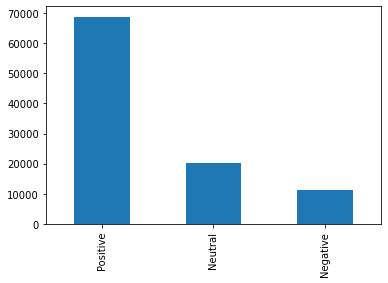

In [202]:
final_df_use['Sentiment'].value_counts().plot(kind='bar');

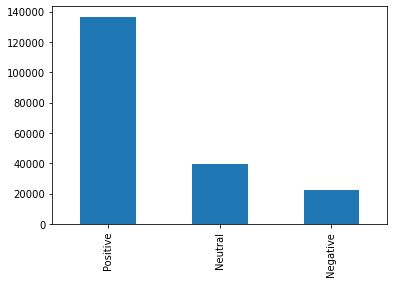

In [203]:
final_df['Sentiment'].value_counts().plot(kind='bar');

In [204]:
pd.read_csv("captone_eda_file_LUXURY-final.csv")

,Unnamed: 0,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,polarity,Sentiment,brand_name
0,0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,great hand lotionfive stars,250 g,0.800000,Positive,Myrrh Extract
1,1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive,Myrrh Extract
2,2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,best non oily hand cream heals overnighti back...,250 g,0.600000,Positive,Myrrh Extract
3,3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral,Myrrh Extract
4,4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,works great dry handsfive stars,250 g,0.366667,Positive,Myrrh Extract
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99996,99996,4.0,True,2017-10-19,ATVDLAS5ZWYD6,B0031NNE56,Wise Pie,"[""Finally a waterproof liquid liner that glide...",stila Stay All Day Waterproof Liquid Eye Liner,"['B011J6HJKM', 'B06WV7KPY2', 'B0781VL1G4', 'B0...",NaN,277 in Beauty & Personal Care (,"['B006UET4XE', 'B074Y8LM6T', 'B0781VL1G4', 'B0...",Luxury Beauty,22.0,like way glides eyelid product doesnt weeks ev...,Intense Black,-0.093333,Negative,Artistry
99997,99997,1.0,True,2017-10-19,AIMR1UBHQ2COY,B0031NNE56,Amazon Customer,"[""Finally a waterproof liquid liner that glide...",stila Stay All Day Waterproof Liquid Eye Liner,"['B011J6HJKM', 'B06WV7KPY2', 'B0781VL1G4', 'B0...",NaN,277 in Beauty & Personal Care (,"['B006UET4XE', 'B074Y8LM6T', 'B0781VL1G4', 'B0...",Luxury Beauty,22.0,dont blink blink makeup smears eyelid try wipe...,Intense Black,-0.400000,Negative,Artistry
99998,99998,5.0,True,2017-10-18,A13OKHQ7O2U9QE,B0031NNE56,Fernanda,"[""Finally a waterproof liquid liner that glide...",stila Stay All Day Waterproof Liquid Eye Liner,"['B011J6HJKM', 'B06WV7KPY2', 'B0781VL1G4', 'B0...",NaN,277 in Beauty & Personal Care (,"['B006UET4XE', 'B074Y8LM6T', 'B0781VL1G4', 'B0...",Luxury Beauty,22.0,worth money use five days week thick line last...,Intense Black,-0.055556,Negative,Artistry
99999,99999,5.0,True,2017-10-18,A30VDALJL9ROCT,B0031NNE56,Kat,"[""Finally a waterproof liquid liner that glide...",stila Stay All Day Waterproof Liquid Eye Liner,"['B011J6HJKM', 'B06WV7KPY2', 'B0781VL1G4', 'B0...",NaN,277 in Beauty & Personal Care (,"['B006UET4XE', 'B074Y8LM6T', 'B0781VL1G4', 'B0...",Luxury Beauty,22.0,super oily eyelids primer literally makeup ive...,Intense Black,0.333333,Positive,Artistry


In [ ]:
final_df_use[final_df_use['brand_name']=='DNA']

In [205]:
final_df_use.brand_name.replace('DNA',np.NaN,inplace=True)

In [206]:
final_df_use.isnull().sum()

Ratings             0
verified            0
reviewTime          0
reviewerID          0
asin                0
reviewerName        0
description         0
title               0
also_buy            0
brand               0
rank                0
also_view           0
main_cat            0
price               0
Review              0
Style               0
polarity            0
Sentiment           0
brand_name      19899
dtype: int64

In [207]:
final_df_use = final_df_use.dropna()


In [208]:
final_df_use.isnull().sum()

Ratings         0
verified        0
reviewTime      0
reviewerID      0
asin            0
reviewerName    0
description     0
title           0
also_buy        0
brand           0
rank            0
also_view       0
main_cat        0
price           0
Review          0
Style           0
polarity        0
Sentiment       0
brand_name      0
dtype: int64

In [209]:
final_df_use.shape[0]

80102

In [210]:
#final_df_use.to_csv("Luxury_beauty_tab.csv")

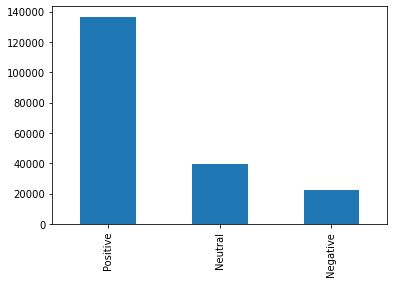

In [211]:
final_df['Sentiment'].value_counts().plot(kind='bar');

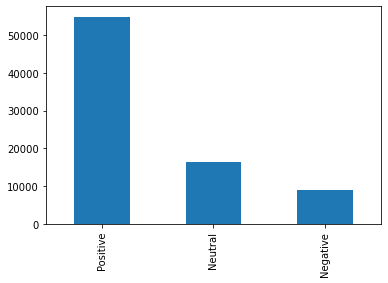

In [212]:
final_df_use['Sentiment'].value_counts().plot(kind='bar');

In [261]:
df = pd.read_csv("Luxury_beauty_tab_fin_manthan.csv")
df.drop(columns="Unnamed: 0",inplace=True,axis=1)

In [262]:
df

,Ratings,verified,reviewTime,reviewerID,asin,reviewerName,description,title,also_buy,brand,rank,also_view,main_cat,price,Review,Style,polarity,Sentiment,brand_name
0,5.0,True,2018-04-18,A2EM03F99X3RJZ,B00004U9V2,Maureen G,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,great hand lotionfive stars,250 g,0.800000,Positive,Crabtree & Evelyn'
1,5.0,True,2018-04-18,A3Z74TDRGD0HU,B00004U9V2,Terry K,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,best severely dry skin handsfive stars,250 g,0.466667,Positive,Crabtree & Evelyn'
2,5.0,True,2018-04-17,A2UXFNW9RTL4VM,B00004U9V2,Patricia Wood,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,best non oily hand cream heals overnighti back...,250 g,0.600000,Positive,Crabtree & Evelyn'
3,5.0,True,2018-04-14,AXX5G4LFF12R6,B00004U9V2,Ralla,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,ive lotion years try occasionally come gardner...,250 g,0.000000,Neutral,Crabtree & Evelyn'
4,5.0,True,2018-04-11,A7GUKMOJT2NR6,B00004U9V2,Lydia Speight,['After a long day of handling thorny situatio...,Crabtree &amp; Evelyn - Gardener's Ultra-Moist...,"['B00GHX7H0A', 'B00FRERO7G', 'B00R68QXCS', 'B0...",NaN,"4,324 in Beauty & Personal Care (","['B00FRERO7G', 'B00GHX7H0A', 'B07GFHJRMX', 'B0...",Luxury Beauty,30.0,works great dry handsfive stars,250 g,0.366667,Positive,Crabtree & Evelyn'
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84147,5.0,True,2017-04-05,ANTUYG40ZTW7U,B0030U1XDU,Judy Rothbardt,"['Jessica Custom Nail Color is iconic, indulge...","Jessica Custom Nail Colour, Purples","['B073QVRJ5K', 'B073QV54JY', 'B0018JIWVG', 'B0...",NaN,"1,215,793 in Beauty & Personal Care (","['B073QVRJ5K', 'B01BD8IE46', 'B073QV54JY', 'B0...",Luxury Beauty,9.0,favorite color productfive stars,Geranium Gypsy,0.500000,Positive,B0030U1XDU
84148,5.0,True,2015-09-22,A12BE2PT1LQ1TG,B0030U1XDU,Bill Fields,"['Jessica Custom Nail Color is iconic, indulge...","Jessica Custom Nail Colour, Purples","['B073QVRJ5K', 'B073QV54JY', 'B0018JIWVG', 'B0...",NaN,"1,215,793 in Beauty & Personal Care (","['B073QVRJ5K', 'B01BD8IE46', 'B073QV54JY', 'B0...",Luxury Beauty,9.0,daughter fell love color nail salon went amazo...,Geranium Gypsy,0.444444,Positive,B0030U1XDU
84149,5.0,True,2015-09-06,A3819MB0WBR5AT,B0030U1XDU,d smith,"['Jessica Custom Nail Color is iconic, indulge...","Jessica Custom Nail Colour, Purples","['B073QVRJ5K', 'B073QV54JY', 'B0018JIWVG', 'B0...",NaN,"1,215,793 in Beauty & Personal Care (","['B073QVRJ5K', 'B01BD8IE46', 'B073QV54JY', 'B0...",Luxury Beauty,9.0,loved colorfive stars,Geranium Gypsy,0.700000,Positive,B0030U1XDU
84150,5.0,True,2015-08-17,A3E4BKPC1W01F0,B0030U1XDU,SoCalShopper,"['Jessica Custom Nail Color is iconic, indulge...","Jessica Custom Nail Colour, Purples","['B073QVRJ5K', 'B073QV54JY', 'B0018JIWVG', 'B0...",NaN,"1,215,793 in Beauty & Personal Care (","['B073QVRJ5K', 'B01BD8IE46', 'B073QV54JY', 'B0...",Luxury Beauty,9.0,new signature shade changes blue purple depend...,Geranium Gypsy,0.178788,Positive,B0030U1XDU


In [265]:
po_lux = df[df["Sentiment"]=="Positive"]
po_lux_df = po_lux.loc[:,["reviewTime","polarity"]]
po_lux_df

,reviewTime,polarity
0,2018-04-18,0.800000
1,2018-04-18,0.466667
2,2018-04-17,0.600000
4,2018-04-11,0.366667
5,2018-04-11,1.000000
...,...,...
84147,2017-04-05,0.500000
84148,2015-09-22,0.444444
84149,2015-09-06,0.700000
84150,2015-08-17,0.178788


In [266]:
po_lux_df["reviewTime"] = pd.to_datetime(po_lux_df["reviewTime"])
po_lux_df.set_index("reviewTime",inplace=True)
po_lux_df.sort_index(inplace=True)
#pos_lux_df.drop(columns="reviewTime",axis=1,inplace=True)
po_lux_df

,polarity
reviewTime,
2005-04-18,0.358333
2005-07-09,0.268960
2005-07-30,0.107834
2005-08-06,0.197321
2005-09-01,0.341667
...,...
2018-06-10,0.193750
2018-06-10,0.466667
2018-06-10,0.511111


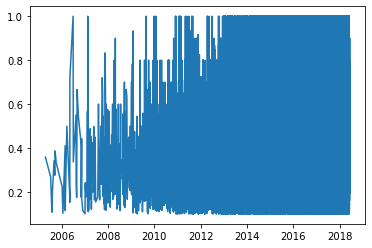

In [267]:
plt.plot(po_lux_df);

In [268]:
pos_lux_df = po_lux_df.resample("MS").mean()

In [269]:
pos_lux_df.isnull().sum()

polarity    7
dtype: int64

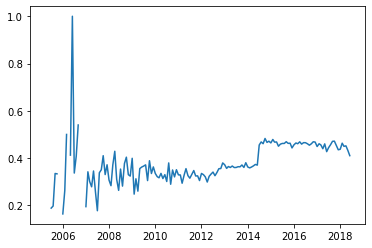

In [270]:
plt.plot(pos_lux_df);

In [271]:
pos_lux_df['polarity'] = pos_lux_df['polarity'].fillna(method="bfill")

In [272]:
pos_lux_df.isnull().sum()

polarity    0
dtype: int64

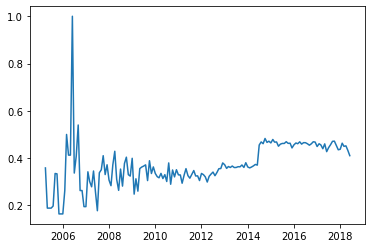

In [273]:
plt.plot(pos_lux_df);

In [274]:
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller,acf,pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.api import ExponentialSmoothing
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import warnings
warnings.filterwarnings('ignore')

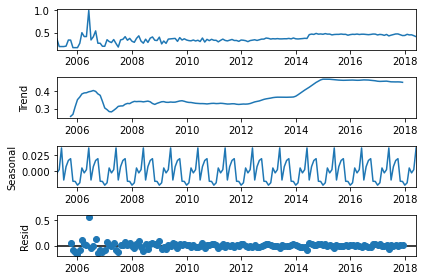

In [275]:
de = seasonal_decompose(pos_lux_df)
de.plot()
plt.tight_layout();

In [276]:
def check_data(data):
    pvalue = adfuller(data)[1]
    print("pvalue",pvalue)
    if pvalue < 0.05:
        msg = "Data is stationary"
    else:
        msg = "Data is not stationary"
    return msg

In [277]:
check_data(pos_lux_df)

pvalue 0.3557482867797818


'Data is not stationary'

In [278]:
for i in range(1,5):
    x = pos_lux_df-pos_lux_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 2.1233096646453164e-09
Shift value 1 Data is stationary


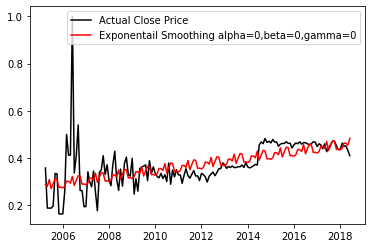

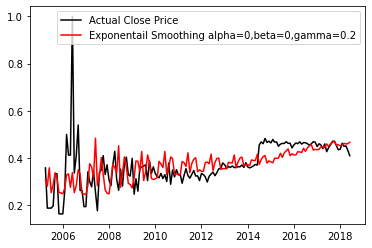

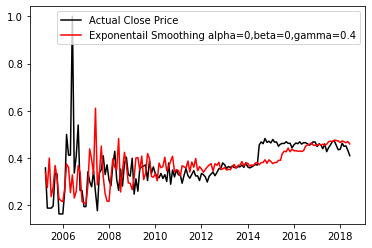

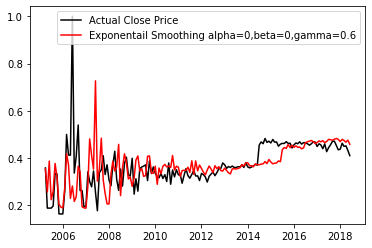

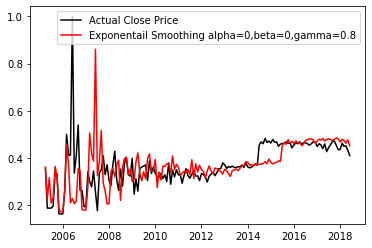

...

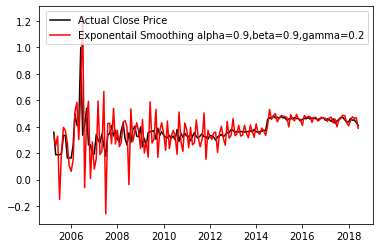

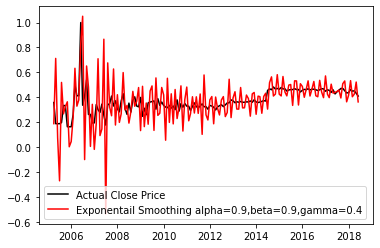

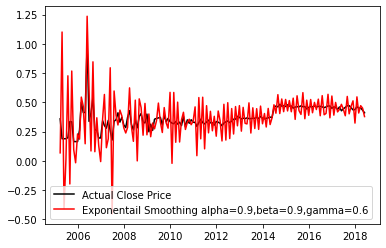

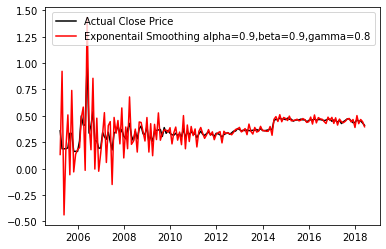

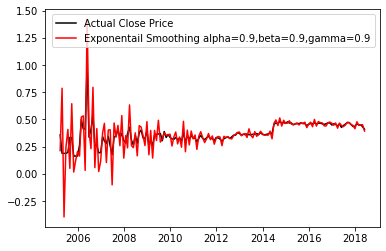

In [279]:
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(pos_lux_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(pos_lux_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

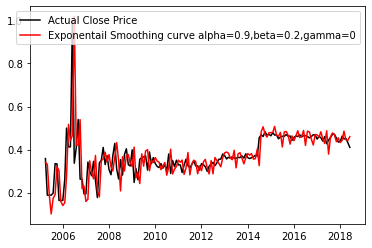

In [280]:
alpha = 0.9
beta = 0.2
gamma = 0
model = ExponentialSmoothing(pos_lux_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(pos_lux_df,color='black',label="Actual Close Price")
plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing curve alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

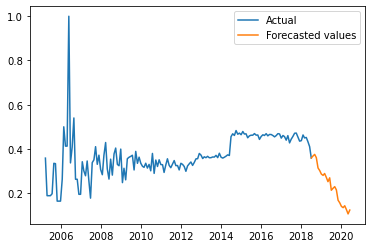

In [281]:
ex_pf = model.forecast(24)
ff = pos_lux_df["polarity"].append(ex_pf[0:1])
plt.plot(ff,label="Actual")
plt.plot(ex_pf,label="Forecasted values")
plt.legend();

In [282]:
check_data(model.fittedvalues)

pvalue 0.06750643534290222


'Data is not stationary'

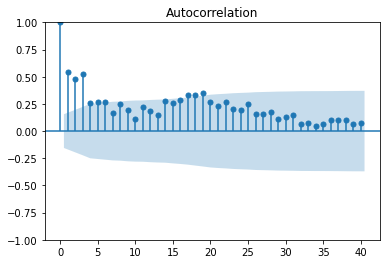

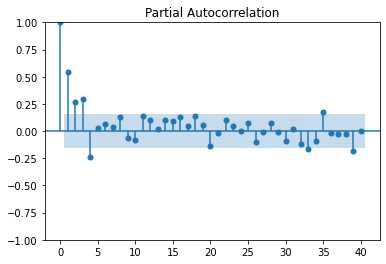

In [283]:
plot_acf(pos_lux_df,lags=40)
plot_pacf(pos_lux_df,lags=40);

In [ ]:
#p=5,q=3 , d=1
#p=1 , q=1 ,dif = 12 d=1

In [284]:
for p in range(1,6):
    for q in range(1,4):
        mod = sm.tsa.statespace.SARIMAX(pos_lux_df,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -360.6007192340361
for  1 2 -360.17054051747743
for  1 3 -358.36105120454226
for  2 1 -366.9188796465107
for  2 2 -365.0715887967308
for  2 3 -369.2315187817493
for  3 1 -364.97687942891
for  3 2 -374.5220295444858
for  3 3 -376.2921081756652
for  4 1 -379.51086457456313
for  4 2 -378.06609243839074
for  4 3 -374.7904802173354
for  5 1 -377.9319235629558
for  5 2 -376.0366661352199
for  5 3 -373.9229744383996


In [285]:
po_lux_mod = sm.tsa.statespace.SARIMAX(pos_lux_df,order=(1,1,3),seasonal_order=(1,1,1,12)).fit()
p_lux_model = po_lux_mod.fittedvalues
print(po_lux_mod.summary())

                                      SARIMAX Results                                       
Dep. Variable:                             polarity   No. Observations:                  159
Model:             SARIMAX(1, 1, 3)x(1, 1, [1], 12)   Log Likelihood                 155.666
Date:                              Tue, 07 Mar 2023   AIC                           -297.332
Time:                                      17:50:22   BIC                           -276.447
Sample:                                  04-01-2005   HQIC                          -288.846
                                       - 06-01-2018                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5944      0.276     -2.154      0.031      -1.135      -0.054
ma.L1          0.02

In [286]:
pvalue = sm.stats.acorr_ljungbox(po_lux_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.3988261]
FAILED to Reject H0.Good MODEL


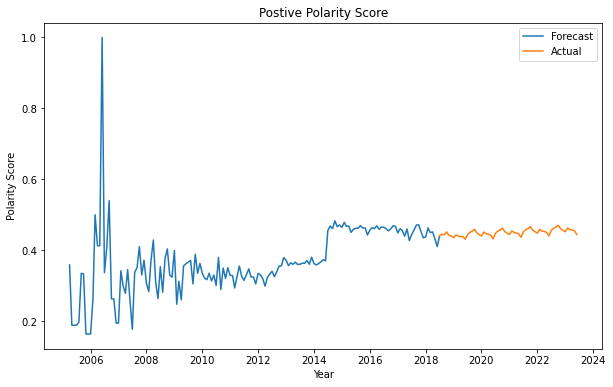

In [287]:
pos_luxf = po_lux_mod.forecast(60)
p_lux = pos_lux_df["polarity"].append(pos_luxf[0:1])

plt.figure(figsize=(10,6))
plt.plot(p_lux,label="Forecast")
plt.plot(pos_luxf,label="Actual")
plt.xlabel("Year")
plt.ylabel("Polarity Score")
plt.title("Postive Polarity Score")
plt.legend();

In [288]:
plux_num = int(0.8*len(pos_lux_df))
plux_trn = pos_lux_df[:plux_num]
plux_tst = pos_lux_df[plux_num:]

In [289]:
pos_lux_mod = sm.tsa.statespace.SARIMAX(plux_trn,order=(1,1,3),seasonal_order=(1,1,1,12)).fit()
ps_lux_model = pos_lux_mod.fittedvalues
print(pos_lux_mod.summary())

                                      SARIMAX Results                                       
Dep. Variable:                             polarity   No. Observations:                  127
Model:             SARIMAX(1, 1, 3)x(1, 1, [1], 12)   Log Likelihood                 106.737
Date:                              Tue, 07 Mar 2023   AIC                           -199.475
Time:                                      17:51:13   BIC                           -180.321
Sample:                                  04-01-2005   HQIC                          -191.701
                                       - 10-01-2015                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.5928      0.349     -1.698      0.090      -1.277       0.092
ma.L1          0.02

In [290]:
pos_strt = len(plux_trn)
pos_end = len(plux_trn)+(len(plux_tst)-1)
pos_lpred = pos_lux_mod.predict(pos_strt,pos_end)


pos_lres = pd.DataFrame({"Predicted":pos_lpred})
pos_lres["Actual"] = plux_tst
pos_lres["Error"] = pos_lres["Actual"] - pos_lres["Predicted"]
pos_lres

,Predicted,Actual,Error
2015-11-01,0.455292,0.462923,0.007631
2015-12-01,0.468966,0.443008,-0.025958
2016-01-01,0.459321,0.456206,-0.003115
2016-02-01,0.456235,0.463827,0.007593
2016-03-01,0.458487,0.460779,0.002292
2016-04-01,0.460042,0.468838,0.008796
2016-05-01,0.463716,0.459125,-0.004591
2016-06-01,0.468005,0.465300,-0.002705
2016-07-01,0.484543,0.465090,-0.019453
2016-08-01,0.494609,0.460614,-0.033995


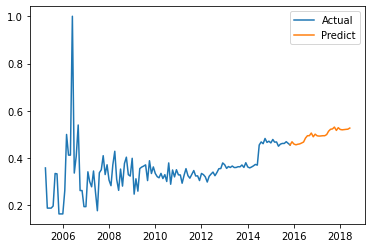

In [291]:
pos_lpr = plux_trn["polarity"].append(pos_lpred[0:1])
plt.plot(pos_lpr,label="Actual")
plt.plot(pos_lpred,label="Predict")
plt.legend();

In [292]:
from sklearn.metrics import mean_squared_error
pos_lmse = mean_squared_error(pos_lpred,plux_tst)
print("Positive mse",pos_lmse)
print("Positive rmse",np.sqrt(pos_lmse))

Positive mse 0.0028663497018207584
Positive rmse 0.053538301260132995


In [293]:
neg_lux = df[df["Sentiment"]=="Negative"]
neg_lux_df = neg_lux.loc[:,["reviewTime","polarity"]]
neg_lux_df

,reviewTime,polarity
9,2018-04-05,-0.126667
17,2018-03-23,-0.200000
26,2018-03-11,-0.098485
31,2018-03-04,-0.394444
40,2018-02-10,-0.100595
...,...,...
84072,2014-03-24,-0.050000
84073,2014-03-18,-0.550000
84074,2014-03-16,-0.100000
84096,2013-03-29,-0.100000


In [294]:
neg_lux_df["reviewTime"] = pd.to_datetime(neg_lux_df["reviewTime"])
neg_lux_df.set_index("reviewTime",inplace=True)
neg_lux_df.sort_index(inplace=True)
#pos_lux_df.drop(columns="reviewTime",axis=1,inplace=True)
neg_lux_df

,polarity
reviewTime,
2005-10-10,-0.020370
2006-01-07,-0.250000
2006-03-10,-0.034375
2006-03-21,-0.017407
2006-05-09,-0.083333
...,...
2018-06-05,-0.333333
2018-06-05,-0.037500
2018-06-08,-0.133333


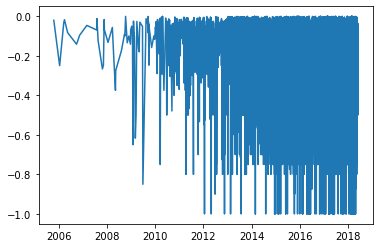

In [295]:
plt.plot(neg_lux_df);

In [296]:
neg_lux_df = neg_lux_df.resample("MS").mean()

In [297]:
neg_lux_df.isnull().sum()

polarity    20
dtype: int64

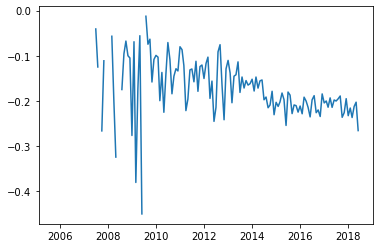

In [298]:
plt.plot(neg_lux_df);

In [299]:
neg_lux_df["polarity"] = neg_lux_df["polarity"].fillna(method='bfill')

In [300]:
neg_lux_df.isnull().sum()

polarity    0
dtype: int64

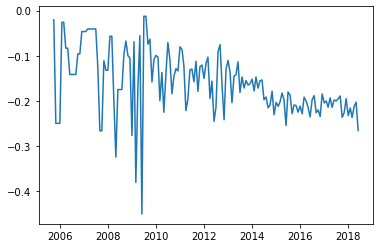

In [301]:
plt.plot(neg_lux_df);

In [302]:
check_data(neg_lux_df)

pvalue 0.6657969059245968


'Data is not stationary'

In [303]:
for i in range(1,5):
    x = neg_lux_df-neg_lux_df.shift(i)
    x.dropna(inplace=True)
    msg = check_data(x)
    if msg == "Data is stationary":
        print("Shift value",i,msg)
        break

pvalue 3.109291297994114e-10
Shift value 1 Data is stationary


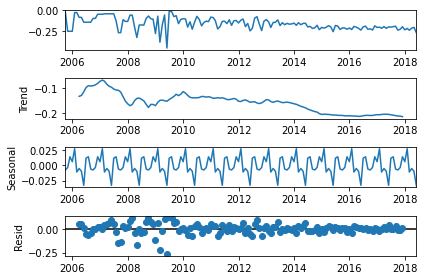

In [304]:
dec_n = seasonal_decompose(neg_lux_df)
dec_n.plot()
plt.tight_layout();

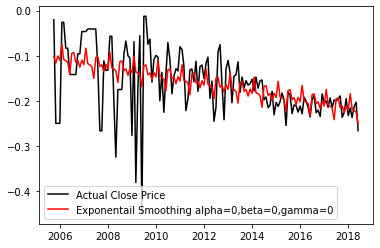

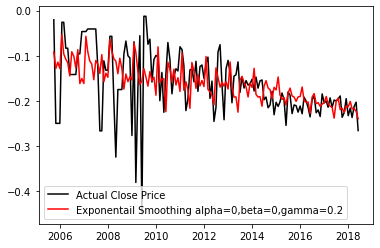

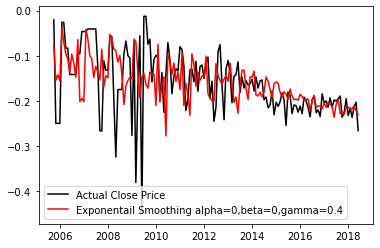

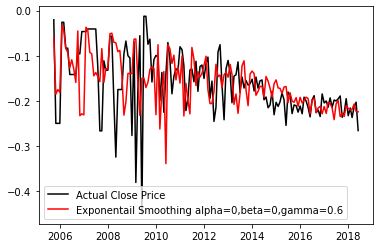

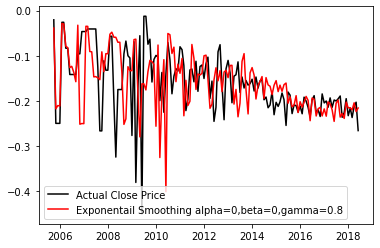

...

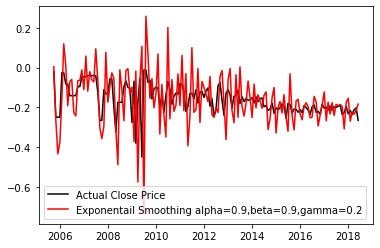

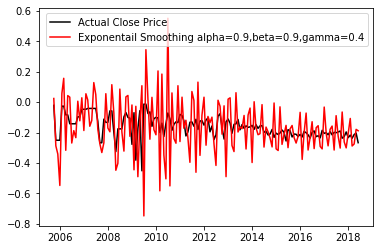

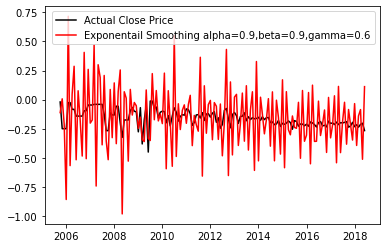

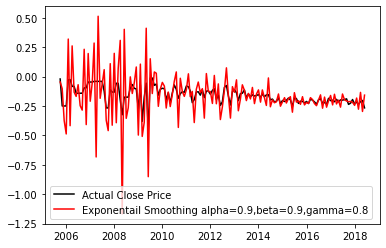

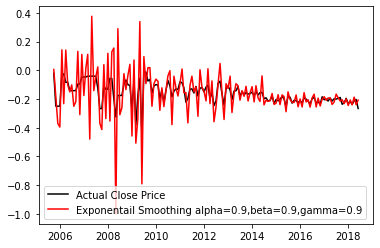

In [305]:
for alpha in [0,0.2,0.4,0.6,0.8,0.9]:
    for beta in [0,0.2,0.4,0.6,0.8,0.9]:
        for gamma in [0,0.2,0.4,0.6,0.8,0.9]:
            model = ExponentialSmoothing(neg_lux_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
            plt.plot(neg_lux_df,color='black',label="Actual Close Price")
            plt.plot(model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
            plt.legend()
            plt.show();

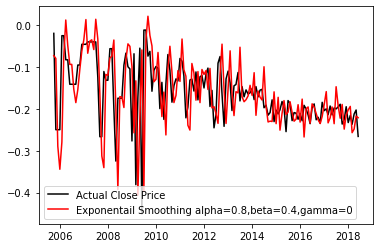

In [306]:
alpha = 0.8
beta = 0.4
gamma = 0
n_model = ExponentialSmoothing(neg_lux_df,trend='add',seasonal='add').fit(smoothing_level=alpha,smoothing_trend=beta,smoothing_seasonal=gamma)
plt.plot(neg_lux_df,color='black',label="Actual Close Price")
plt.plot(n_model.fittedvalues,color="red",label=f'Exponentail Smoothing alpha={alpha},beta={beta},gamma={gamma}')
plt.legend()
plt.show();

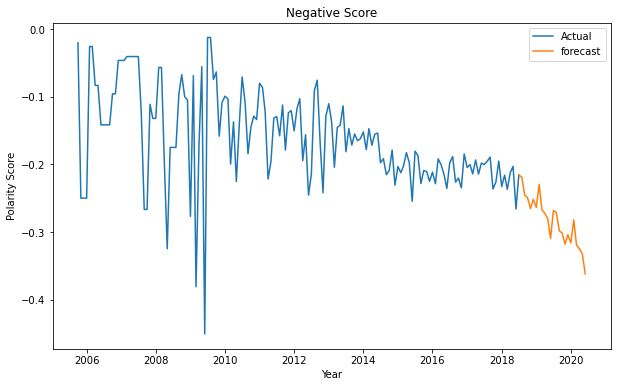

In [307]:
nx = n_model.forecast(24)

nax = neg_lux_df["polarity"].append(nx[0:1])

plt.figure(figsize=(10,6))
plt.xlabel("Year")
plt.ylabel("Polarity Score")
plt.plot(nax,label="Actual")
plt.plot(nx,label="forecast")
plt.title("Negative Score")
plt.legend();

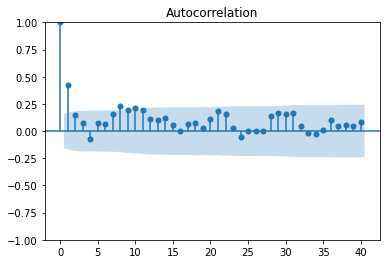

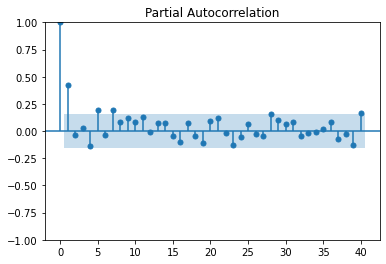

In [308]:
plot_acf(n_model.fittedvalues,lags=40)
plot_pacf(n_model.fittedvalues,lags=40);

In [309]:
for p in range(1,4):
    for q in range(1,3):
        mod = sm.tsa.statespace.SARIMAX(neg_lux_df,order=(p,1,q),seasonal_order=None).fit()
        print("for ", p , q, mod.aic)

for  1 1 -396.0069104280087
for  1 2 -400.8713534509726
for  2 1 -394.0782767317996
for  2 2 -398.8889490169055
for  3 1 -392.272748694306
for  3 2 -398.1089268783097


In [310]:
n_mod = sm.tsa.statespace.SARIMAX(neg_lux_df,order=(3,1,1),seasonal_order=(1,1,1,5)).fit()
nm = n_mod.fittedvalues
print(n_mod.summary())

                                     SARIMAX Results                                     
Dep. Variable:                          polarity   No. Observations:                  153
Model:             SARIMAX(3, 1, 1)x(1, 1, 1, 5)   Log Likelihood                 186.204
Date:                           Tue, 07 Mar 2023   AIC                           -358.408
Time:                                   17:57:11   BIC                           -337.475
Sample:                               10-01-2005   HQIC                          -349.903
                                    - 06-01-2018                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1893      0.070      2.702      0.007       0.052       0.327
ar.L2         -0.0443      0.066     -0.668

In [311]:
pvalue = sm.stats.acorr_ljungbox(n_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.53604671]
FAILED to Reject H0.Good MODEL


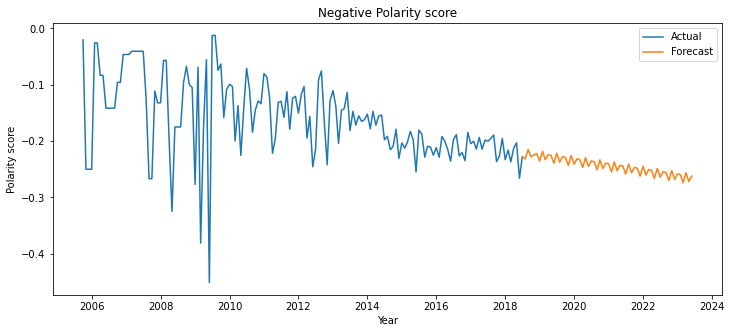

In [312]:
neg_f = n_mod.forecast(60)

ng_a = neg_lux_df["polarity"].append(neg_f[0:1])
plt.figure(figsize=(12,5))
plt.plot(ng_a,label="Actual")
plt.plot(neg_f,label="Forecast")
plt.xlabel("Year")
plt.ylabel("Polarity score")
plt.title("Negative Polarity score")
plt.legend();

In [313]:
n_num = int(len(neg_lux_df)*0.8)

neg_trn = neg_lux_df[:n_num]
neg_tst = neg_lux_df[n_num:]
n_strt = len(neg_trn)
n_end = len(neg_trn)+(len(neg_tst)-1)

In [314]:
n_mods = sm.tsa.statespace.SARIMAX(neg_trn,order=(3,1,1),seasonal_order=(1,1,1,5)).fit()
nm = n_mods.fittedvalues
print(n_mods.summary())

                                     SARIMAX Results                                     
Dep. Variable:                          polarity   No. Observations:                  122
Model:             SARIMAX(3, 1, 1)x(1, 1, 1, 5)   Log Likelihood                 132.942
Date:                           Tue, 07 Mar 2023   AIC                           -251.883
Time:                                   17:58:53   BIC                           -232.608
Sample:                               10-01-2005   HQIC                          -244.059
                                    - 11-01-2015                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1995      0.093      2.148      0.032       0.017       0.382
ar.L2         -0.0432      0.084     -0.515

In [315]:
pvalue = sm.stats.acorr_ljungbox(n_mod.resid,lags=[1],return_df=True)['lb_pvalue'].values
print(pvalue)
if pvalue < 0.05:
    print('Reject H0.BAD MODEL')
else:
    print("FAILED to Reject H0.Good MODEL")

[0.53604671]
FAILED to Reject H0.Good MODEL


In [316]:
nn_pred = n_mods.predict(n_strt,n_end)
nn_pred


2015-12-01   -0.182652
2016-01-01   -0.187470
2016-02-01   -0.206823
2016-03-01   -0.187670
2016-04-01   -0.204996
2016-05-01   -0.185348
2016-06-01   -0.189915
2016-07-01   -0.207561
2016-08-01   -0.188613
2016-09-01   -0.207527
2016-10-01   -0.188725
2016-11-01   -0.193273
2016-12-01   -0.210752
2017-01-01   -0.191825
2017-02-01   -0.210896
2017-03-01   -0.192178
2017-04-01   -0.196725
2017-05-01   -0.214187
2017-06-01   -0.195262
2017-07-01   -0.214348
2017-08-01   -0.195639
2017-09-01   -0.200186
2017-10-01   -0.217646
2017-11-01   -0.198721
2017-12-01   -0.217809
2018-01-01   -0.199101
2018-02-01   -0.203647
2018-03-01   -0.221107
2018-04-01   -0.202182
2018-05-01   -0.221271
2018-06-01   -0.202563
Freq: MS, Name: predicted_mean, dtype: float64

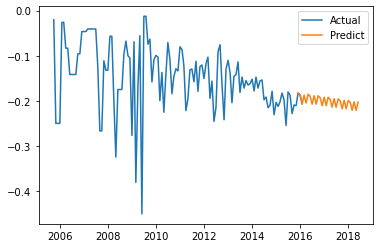

In [317]:
ns = neg_trn["polarity"].append(nn_pred[0:3])
plt.plot(ns,label="Actual")
plt.plot(nn_pred,label="Predict")
plt.legend();

In [318]:
neg_lmse = mean_squared_error(nn_pred,neg_tst)
print("Positive mse",neg_lmse)
print("Positive rmse",np.sqrt(neg_lmse))

Positive mse 0.0005942598456731001
Positive rmse 0.02437744542959947


In [319]:
import plotly.express as px
import plotly.graph_objects as go

In [320]:
x = ng_a.index
y = ng_a.values
trace1 = go.Scatter(x=x,y=y,name="Actual")
x1 = neg_f.index
y1 = neg_f.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecast")

data = [trace1,trace2]
layout = go.Layout(title = "Luxury Beauty",yaxis=dict(title="Polarity score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)
fig.show()

In [321]:
x = p_lux.index
y = p_lux.values
trace1 = go.Scatter(x=x,y=y,name="Actual")
x1 = pos_luxf.index
y1 = pos_luxf.values
trace2 = go.Scatter(x=x1,y=y1,name="Forecast")

data = [trace1,trace2]
layout = go.Layout(title = "Luxury Beauty",yaxis=dict(title="Polarity score",zeroline=True,showline=True),
                  xaxis = dict(title = "Year"))

fig = go.Figure(data=data,layout=layout)
fig.show()